In [1]:
import numpy as np
import glob,os,sys
import cv2
from tqdm import tqdm_notebook as tqdm
from sklearn.cluster import KMeans
from imp import reload
import matplotlib.pylab as plt
import pickle
from scipy.spatial import cKDTree
import OB_MER_Analyser_py3_zst as oma
import tifffile
reload(oma)

<module 'OB_MER_Analyser_py3_zst' from 'C:\\Users\\Bogdan\\Dropbox\\code_Seurat\\OR_MERFISH_2020\\OB_MER_Analyser_py3_zst.py'>

In [2]:
tags = [r'\\simon\Raw_data_3\Bogdan\*OR-MER*',r'\\simon\Raw_data_4\Bogdan\*OR-MER*',r'\\simon\Raw_data_5\Bogdan\*OR-MER*',
       r'\\mcclintock\mcclintock_1\Bogdan\*OR-MER*',r'\\mcclintock\mcclintock_3\Bogdan\*OR-MER*',
        r'\\mcclintock\mcclintock_4\Bogdan\*OR-MER*',r'\\mcclintock\mcclintock_5\Bogdan\*OR-MER*',
       r'\\10.245.74.218\Raw_data\Bogdan\*OR-MER*',r'\\10.245.74.218\Analysis\Bogdan\*OR-MER*',
        r'\\10.245.74.218\Raw_data_2\Bogdan\*OR-MER*',r'\\10.245.74.218\Raw_data_3\Bogdan\*OR-MER*',
       r'\\10.245.74.218\Raw_data_4\Bogdan\*OR-MER*',r'\\10.245.74.218\Raw_data_5\Bogdan\*OR-MER*']
from tqdm.notebook import tqdm
import glob
all_folders = [fld for tag in tqdm(tags) for fld in glob.glob(tag) if 'Analysis' not in fld]



ob_folders = np.sort([fld for fld in all_folders if 'CD1mom5' in fld and 'MOE' not in fld and '-Analysis' not in fld])
ob_folders = np.array(ob_folders)
islides = [int(fld.split('_OB')[1]) for fld in ob_folders]
ob_folders  = ob_folders[np.argsort(islides)]
for fld in ob_folders:
    print(fld)


\\mcclintock\mcclintock_1\Bogdan\7_27_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB1
\\10.245.74.218\Raw_data\Bogdan\7_21_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB2
\\mcclintock\mcclintock_1\Bogdan\Q7_27_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB3
\\mcclintock\mcclintock_1\Bogdan\7_27_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB3
\\10.245.74.218\Raw_data\Bogdan\7_22_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB4
\\mcclintock\mcclintock_1\Bogdan\7_29_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB5
\\10.245.74.218\Raw_data\Bogdan\7_22_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm65_OB6
\\mcclintock\mcclintock_1\Bogdan\7_30_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB7
\\10.245.74.218\Raw_data\Bogdan\7_21_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB8
\\mcclintock\mc

In [4]:
ob_folders =[ob_fld for ob_fld in ob_folders if os.path.basename(ob_fld)[0]!='Q']

In [5]:
OBs = [int(obfld.split('_OB')[-1]) for obfld in ob_folders]
np.setdiff1d(np.arange(36)+1,OBs)

array([], dtype=int32)

In [6]:
[(int(fld.split('_OB')[1]),int('_lib1,2,3,4' in fld))  for fld in ob_folders]

[(1, 1),
 (2, 1),
 (3, 0),
 (4, 0),
 (5, 1),
 (6, 1),
 (7, 0),
 (8, 0),
 (9, 0),
 (10, 1),
 (11, 1),
 (12, 0),
 (13, 0),
 (14, 1),
 (15, 1),
 (16, 0),
 (17, 0),
 (18, 1),
 (19, 1),
 (20, 1),
 (21, 0),
 (22, 0),
 (23, 0),
 (24, 1),
 (25, 1),
 (26, 0),
 (27, 0),
 (28, 1),
 (29, 1),
 (30, 0),
 (31, 0),
 (32, 1),
 (33, 0),
 (34, 1),
 (35, 1),
 (36, 0)]

In [15]:
#len(np.unique(islides))*6

In [ ]:
### Optional: Check quality

### Construct a labelled mosaic from the 40X imaged dapi

In [ ]:
%matplotlib notebook

In [ ]:
files = glob.glob(r'F:\Bogdan\OB-mosaic_labelled\*.tif')
fl = files[0]
import tifffile
im = tifffile.imread(fl)
plt.figure()
plt.imshow(im,vmax=10000)
plt.title(os.path.basename(fl))

### Consruct unlabelled 40x mosaics for masks with max projection

In [7]:
reload(oma)
folder__s = []
nframes = 200
ncols=4
frames = np.arange(ncols-1,nframes,ncols*4)

for master_folder in ob_folders:
    try:
        hfolders = glob.glob(master_folder+os.sep+'H*')
        iob = int(master_folder.split('_OB')[1])
        hfolder = hfolders[0]# if iob!=36 else hfolders[-1]
        fls_iter = np.sort(glob.glob(hfolder+os.sep+'*.dax*'))
        base_path = os.path.basename(master_folder)
        analysis_folder = r'\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis'+os.sep+base_path+'-AnalysisOB'
        if not os.path.exists(analysis_folder): os.makedirs(analysis_folder)
        save_file = analysis_folder+os.sep+'dapi_resc8.tif'
        print(save_file)
        if not os.path.exists(save_file):
            angle = 0 if 'storm3' in base_path else 0 
            oma.save_tile_image_and_label(fls_iter[:],save_file,resc=8,
                                          custom_frms=frames,pix_size_=0.162,
                                                max_impose=True,verbose=True,
                                                      rotation_angle=angle,add_txt=False,norm_dapi=True,invertY=True,invertX=False);
    except:
        print("Failed",master_folder)

\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_27_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB1-AnalysisOB\dapi_resc8.tif
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_21_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB2-AnalysisOB\dapi_resc8.tif
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_27_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB3-AnalysisOB\dapi_resc8.tif
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_22_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB4-AnalysisOB\dapi_resc8.tif
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_29_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB5-AnalysisOB\dapi_resc8.tif
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_22_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm65_OB6-AnalysisOB\dapi_resc8.tif
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-

C:\Users\Bogdan\Dropbox\code_Seurat\OR_MERFISH_2020\OB_MER_Analyser_py3_zst.py:1529: RuntimeWarning: invalid value encountered in true_divide
  im_base[x:sx+x,y:sy+y,...]=(im_compare[x:sx+x,y:sy+y,...]*im_base[x:sx+x,y:sy+y,...]+im_cor_*im_)/(im_compare[x:sx+x,y:sy+y,...]+im_cor_)
C:\Users\Bogdan\Dropbox\code_Seurat\OR_MERFISH_2020\OB_MER_Analyser_py3_zst.py:1530: RuntimeWarning: invalid value encountered in true_divide
  im_compare[x:sx+x,y:sy+y,...]=(im_compare[x:sx+x,y:sy+y,...]*im_compare[x:sx+x,y:sy+y,...]+im_cor_*im_cor_)/(im_compare[x:sx+x,y:sy+y,...]+im_cor_)


\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_18_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB33-AnalysisOB\dapi_resc8.tif
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_29_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm65_OB34-AnalysisOB\dapi_resc8.tif
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_19_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB35-AnalysisOB\dapi_resc8.tif
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_28_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB36-AnalysisOB\dapi_resc8.tif


### Get masks from predefined 10X masks

In [8]:
master_folder = ob_folders[0]
ob_folders_bs =[]
for master_folder in ob_folders:
    base_path = os.path.basename(master_folder)
    analysis_folder = r'\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis'+os.sep+base_path+'-AnalysisOB'
    tiffl = analysis_folder+os.sep+'dapi_resc8.tif'
    if os.path.exists(tiffl) and not os.path.exists(tiffl.replace('.tif','_glomLayer.tif'))and not os.path.exists(tiffl.replace('.tif','_glomLayerA.tif')):
        ob_folders_bs.append(master_folder)


ob_folders_bs

['\\\\mcclintock\\mcclintock_1\\Bogdan\\7_31_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB32']

\\storm3-pc\f\7_31_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB32 \\mcclintock\mcclintock_1\Bogdan\7_31_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB32


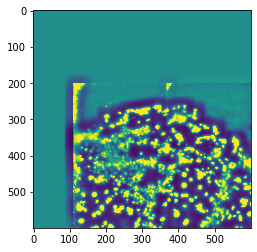

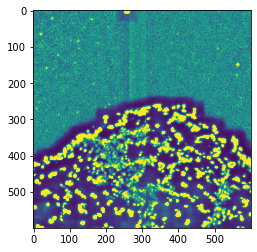

\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_31_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB32-AnalysisOB\dapi_resc8.tif


In [9]:
for master_folder in ob_folders_bs:#[ob_folders_bs[4]]:#2,3,4
    base_path = os.path.basename(master_folder)
    analysis_folder = r'\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis'+os.sep+base_path+'-AnalysisOB'
    tiffl = analysis_folder+os.sep+'dapi_resc8.tif'
    tag = base_path.split('____')[0]
    tag2 = base_path.split('_OB')[-1]
    ofolder = ([fl for fl in glob.glob(r'\\storm3-pc\f\*') if tag in fl and tag2 ==fl.split('_OB')[-1]  and 'MOE' not in fl]+\
    [fl for fl in glob.glob(r'\\storm65-pc\f\*') if tag in fl and tag2 ==fl.split('_OB')[-1] and 'MOE' not in fl])[0]
    print(ofolder,master_folder)
    
    
    try:
        im_10x = cv2.imread(ofolder+os.sep+'mosaic.png')[::2,::2,0].astype(np.float32)+1
    except:
        import matplotlib.image as mpimg
        im_10x = mpimg.imread(ofolder+os.sep+'mosaic.png')[::2,::2]*255+1
    im_mask = tifffile.imread(ofolder+os.sep+'mosaic_mask_ob.tif')[::2,::2]
    im_maxp = tifffile.imread(tiffl).astype(np.float32)
    im_maxpt = im_maxp.copy()
    im_maxpt[im_maxpt==0]=np.percentile(im_maxpt[im_maxpt!=0],5)
    im_maxpn = im_maxpt/cv2.blur(im_maxpt,(50,50))
    im_10xn = im_10x/cv2.blur(im_10x,(50,50))
    Xp = np.array(np.where(im_maxp>0)).T
    
    #_______________________________________
    X_ = Xp[np.random.randint(len(Xp))]
    s_ = 300
    xm,xM = X_-s_,X_+s_
    xm[xm<0]=0
    im_ = im_maxpn[xm[0]:xM[0],xm[1]:xM[1]]
    plt.figure()
    plt.imshow(im_,vmax=2)


    from scipy.signal import fftconvolve
    imCor = fftconvolve(im_10xn-1,im_[::-1,::-1]-1,mode='valid')
    Xn = np.unravel_index(np.argmax(imCor),imCor.shape)
    Xt = Xn-xm

    plt.figure()
    plt.imshow(im_10xn[Xn[0]:Xn[0]+s_*2,Xn[1]:Xn[1]+s_*2],vmax=2)
    plt.show()
    #_______________________________________
    
    
    #im_maskf = np.zeors(im_maxp.shape,np.uint8)
    T = np.float32([[1, 0, -Xt[1]], [0, 1, -Xt[0]]])
    im_maskf = cv2.warpAffine(im_mask, T, (im_maxp.shape[1],im_maxp.shape[0]))
    tifffile.imsave(tiffl.replace('.tif','_glomLayerA.tif'),im_maskf)
    print(tiffl)

In [16]:
#plt.figure(figsize=(20,20))
#plt.imshow(im_maxpn[::2,::2],vmax=3)

#plt.figure(figsize=(20,20))
#plt.imshow(im_10xn[::2,::2],vmax=3)

In [21]:
fld = r'\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_22_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB26-AnalysisOB'
im1 = tifffile.imread(fld+os.sep+'dapi_resc8.tif')
im2 = tifffile.imread(fld+os.sep+'dapi_resc8_glomLayerA.tif')


In [35]:
im1_,_,_ = oma.minmax(im1,min_=0,max_=np.percentile(im1,99.9))
im2_,_,_ = oma.minmax(im2.astype(np.float32),max_=np.max(im2))

In [37]:
%matplotlib notebook

<IPython.core.display.Javascript object>


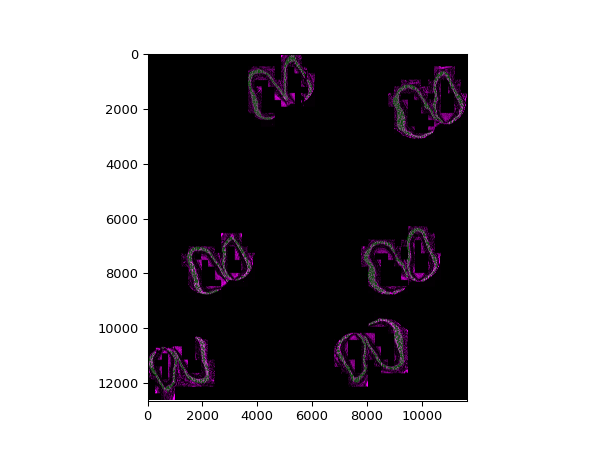

In [39]:
plt.figure()
plt.imshow(np.dstack([im1_,im2_*0.3,im1_]))

In [21]:
master_folder = ob_folders_bs[6] -bad frames
master_folder = ob_folders_bs[8] -bad frames

'7_7_2021__OR-MER_lib1,2,3,4,5'

In [44]:
print(ob_folders_bs[6])
print(ob_folders_bs[8])

\\10.245.74.218\Raw_data_4\Bogdan\7_5_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB25
\\10.245.74.218\Raw_data\Bogdan\6_25_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm3_OB29


In [47]:
for fld in glob.glob(r'\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\*-AnalysisOB'):
     if not os.path.exists(fld+os.sep+'dapi_resc8_glomLayer.tif'):
            print(fld)

### Construct a mask for manual glomeruli segmentation

In [40]:
### Used cellpose on ip 161/163
#http://localhost:8888/notebooks/Dropbox/code_Seurat/OR_MERFISH_2020/Cellpose_segmention_OB.ipynb

In [1]:
%matplotlib notebook

'\\\\simon\\Raw_data_4\\Bogdan\\4_19_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB42_OB'

In [8]:
folder = r'\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\4_17_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB44-AnalysisOB'


master_folder = r'\\simon\Raw_data_5\Bogdan\5_06_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB41'
#master_folder = r'\\simon\Raw_data_5\Bogdan\5_06_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB43'
#master_folder = r'\\simon\Raw_data_5\Bogdan\5_08_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB38'
#master_folder = r'\\simon\Raw_data_5\Bogdan\5_08_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB40'

folder = master_folder
folder = r'\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis'+os.sep+os.path.basename(folder)+'-AnalysisOB'

fl = folder+r'\dapi_resc8.tif'
fl_mask = fl.replace('.tif','_glomLayer.tif')
im_msk = tifffile.imread(fl_mask)
full_mat = fl_mask.replace('.tif','.tif.npy')
im_labf,limits = np.load(full_mat,allow_pickle=True)

#oma.check_glomeruli_figure(im_labf,im_msk);

infos = np.array([ln[:-1].split('\t') for ln in open(fl.replace('.tif','.infos'),'r')])
fovs = [os.path.basename(fl_) for fl_ in infos[:,0]]
ims_OB3d = np.array([im_labf[xm:xM,ym:yM] for ifov,(fov,(xm,xM,ym,yM,resc)) in enumerate(zip(fovs,infos[:,1:].astype(np.int)))])
tifffile.imwrite(folder+os.sep+'glom3d.tif',ims_OB3d)

C:\Users\Bogdan\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations


In [6]:
%matplotlib notebook

<IPython.core.display.Javascript object>


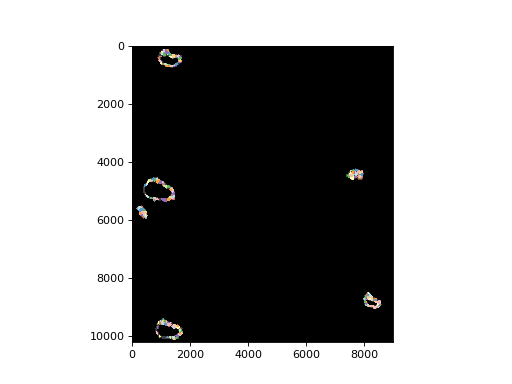

In [12]:
oma.check_glomeruli_figure(im_labf,im_msk);

### Inspect a fov

In [40]:
ob_folders

['\\\\mcclintock\\mcclintock_1\\Bogdan\\7_27_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB1',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\7_21_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB2',
 '\\\\mcclintock\\mcclintock_1\\Bogdan\\7_27_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB3',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\7_22_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB4',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\7_22_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm65_OB6',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\7_21_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB8',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\7_19_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm65_OB10',
 '\\\\mcclintock\\mcclintock_1\\Bogdan\\7_25_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB11',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\7_18_2021__OR-MER_li

In [59]:
oma.load_im(hfolders[0]+os.sep+fov,custom_frms=[103]).shape

(1, 2048, 2048)

\\mcclintock\mcclintock_1\Bogdan\7_30_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB9_MOE
Conv_zscan2_08.dax.zst


<IPython.core.display.Javascript object>


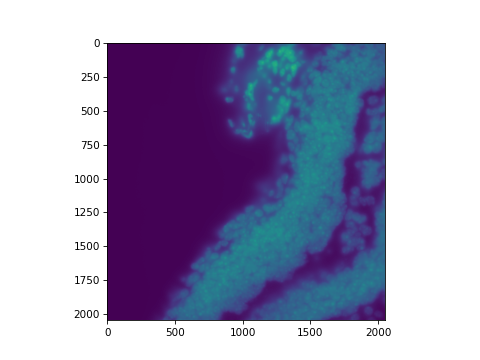

In [31]:
#4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25
master_folder = ob_folders[8]+'_MOE'
print(master_folder)
hfolders = np.sort(glob.glob(master_folder+r'\H*'))
fovs = np.sort([os.path.basename(fl) for fl in glob.glob(hfolders[0]+os.sep+'*.dax*')])
fov = fovs[8]
print(fov)


fl = hfolders[0]+os.sep+fov.split('.')[0]+'_fr3_frA103.npy'
if os.path.exists(fl):
    im = np.load(fl)
else:
    fl = hfolders[0]+os.sep+fov
    im = oma.io.DaxReader(fl).loadAFrame(103)
plt.figure()
plt.imshow(im)

In [32]:
cols = ['561','647','750','405']
ncols = len(cols)
ims,ims_names=[],[]
dax_fls = []
for folder in tqdm(hfolders):
    dax_fl = folder+os.sep+fov
    dax_fls+=[dax_fl]
    #if os.path.exists(dax_fl):
    IM = oma.load_im(dax_fl)
    ims_ = [IM[icol::ncols]for icol in range(ncols)]
    ims_names_ = [os.path.basename(os.path.dirname(dax_fl))+'_'+col for col in cols]
    ims.extend(ims_[:-1])
    ims_names.extend(ims_names_[:-1])
ims+=[ims_[-1]]
ims_names+=['dapi']

In [15]:
%matplotlib notebook

<IPython.core.display.Javascript object>


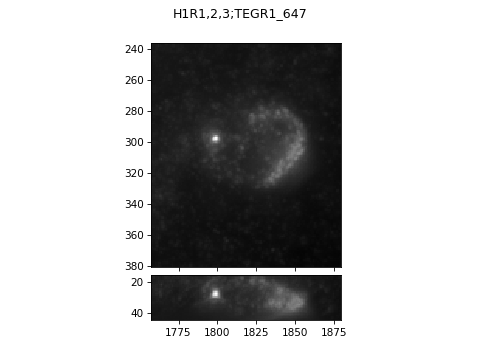

In [33]:
import MaxViewer_py3 as mv
obj = mv.imshow_mark_3d(ims,image_names=ims_names)

<IPython.core.display.Javascript object>


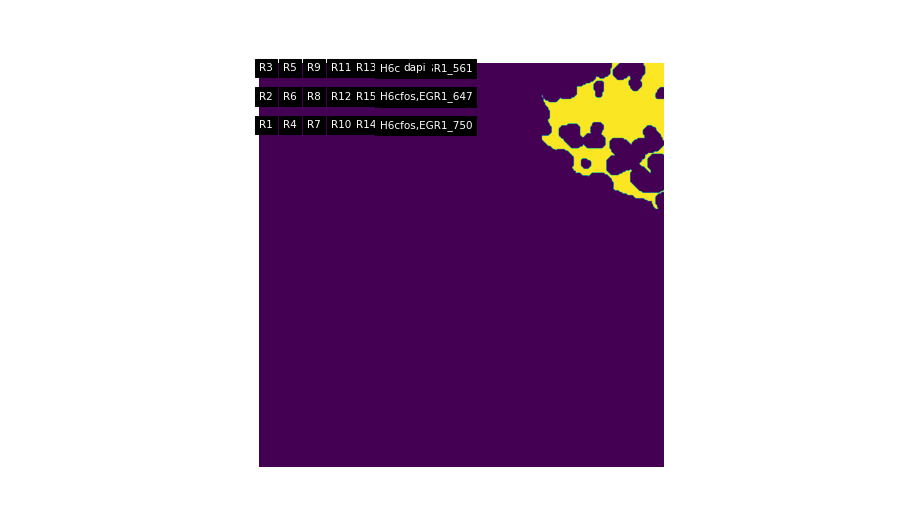

(-0.5, 853.5, 431.5, -0.5)

In [37]:
def minmax(im,min_=None,max_=None,percmax=99.9,pecmin=0.1):
    im_ = np.array(im,dtype=float)
    if min_ is None:
        min_ = np.min(im_)
        if pecmin is not None:
            min_ = np.percentile(im_,pecmin)
    if max_ is None:
        max_ = np.max(im_)
        if percmax is not None:
            max_ = np.percentile(im_,percmax)
    if (max_-min_)<=0:
        im_ = im_*0
    else:
        im_ = (im_-min_)/(max_-min_)
        im_[im_<0]=0
        im_[im_>1]=1
    return im_,min_,max_
z_min,z_max,x_min,x_max,y_min,y_max =obj.get_limits()
#zmin=12
ims_sm = [im_[z_min:z_max,x_min:x_max,y_min:y_max] for im_ in obj.ims]

iimax = len(ims_sm)
col_row = 1.25
nrow = int(np.sqrt(iimax)/col_row)
ncol = int(np.ceil(iimax/float(nrow)))
ssz,ssx,ssy = ims_sm[0].shape
imf = np.zeros([ssx*nrow,ssy*ncol])
iim=0

R_to_col={1:'750',2:'647',3:'561',4:'750',6:'647',5:'561',7:'750',8:'647',9:'561',10:'750',12:'647',11:'561',14:'750',15:'647',13:'561'}
def nm_to_R(nm_sm,cols = ['561','647','750']):
    try:
        col = nm_sm.split('_')[-1]
        iRs = np.array(nm_sm[3:].split('_')[0].split(';')[0].split(','),dtype=int)
        cols_ = [R_to_col[iR] for iR in iRs]
        iR = str(iRs[cols_.index(col)])
        return 'R'+iR
    except:
        return nm_sm

txts=[]
for icol in range(ncol):
    for irow in range(nrow):
        if iim<len(ims_sm):
            ims_sm_ = ims_sm[iim]
            nm_sm = ims_names[iim]
            
            txt = nm_to_R(nm_sm)
            
            
            if 'dapi' in txt: ims_sm_=[ims_sm_[int(len(ims_sm_)/2)]]
            
            im_plt,min_,max_ = minmax(np.max(ims_sm_,0),percmax=99.95,pecmin=.5)
            imf[irow*ssx:(irow+1)*ssx,icol*ssy:(icol+1)*ssy]=im_plt
            #txt+=' - '+str([int(min_),int(max_)])
            txts.append([txt,irow*ssx,icol*ssy])
            iim+=1
            
import matplotlib.pylab as plt
fig = plt.figure(figsize=(12,7))
for txt,xtxt,ytxt in txts:
    plt.text(ytxt,xtxt,txt,color='white',backgroundcolor='k',horizontalalignment='left',verticalalignment='top',fontsize=10)
plt.imshow(imf,interpolation='nearest',cmap='gray')
plt.axis('off')

In [38]:
print(master_folder)
cds = [[3,6,9,8],[3,5,7,14],[2,5,6,14],[2,8,13,14],[1,3,8,13],[2,4,8,12]]#\\mcclintock\mcclintock_1\Bogdan\7_30_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB7_MOE
for cd in cds:
    print(code_dic[str(list(np.sort(cd)))])

\\mcclintock\mcclintock_1\Bogdan\7_30_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB9_MOE
Olfr267_1
Olfr48_7
Olfr835_1
Olfr1260_3
Olfr1228_9
Olfr1183_6


In [422]:
BAD

\\10.245.74.218\Raw_data\Bogdan\7_18_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB33

\\10.245.74.218\Raw_data\Bogdan\7_19_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB35

\\mcclintock\mcclintock_1\Bogdan\7_29_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB34

\\mcclintock\mcclintock_1\Bogdan\7_28_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB36

[1, 3, 10, 13]

In [21]:
print(master_folder)

\\mcclintock\mcclintock_1\Bogdan\7_29_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB5_MOE


In [39]:

cds = [[2,5,11,14],[2,4,13,14],[3,9,8,10]]#\\10.245.74.218\Raw_data\Bogdan\7_22_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm65_OB6_MOE
cds = [[3,5,7,14],[1,2,5,11],[1,9,7,14],
       [4,6,11,13],[3,7,8,14],[2,4,8,12]]#\\10.245.74.218\Raw_data\Bogdan\7_21_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB8_MOE
cds = [[2,6,12,13],[2,4,11,14],[6,10,11,12]]#\\10.245.74.218\Raw_data\Bogdan\7_19_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm65_OB10_MOE
cds = [[2,8,7,11],[4,6,11,13]]#\\10.245.74.218\Raw_data\Bogdan\7_18_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB12_MOE
cds = [[1,11,13,10],[3,6,7,9]]#\\mcclintock\mcclintock_1\Bogdan\7_25_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB11_MOE
cds = [[2,3,8,14],[1,3,13,8],[2,7,8,11],[1,2,11,13]]#\\mcclintock\mcclintock_1\Bogdan\7_25_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB13_MOE
cds = [[10,11,13,3]]#\\simon\Raw_data_4\Bogdan\7_9_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB14_MOE- bad
cds = [[3,5,7,13],[3,8,9,10],[2,4,9,12],[5,9,12,13],[2,6,7,10],[4,9,12,13],[1,10,11,13],[2,6,12,13],[6,10,11,12]]#\\10.245.74.218\Raw_data\Bogdan\7_24_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB15_MOE
cds = [[3,7,11,13],[3,5,7,14],[8,9,10,13],[1,2,11,5]]#\\10.245.74.218\Raw_data\Bogdan\7_24_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB17_MOE
cds = [[1,2,5,11]]#\\simon\Raw_data_4\Bogdan\7_9_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB16_MOE
#bad
cds = [[2,5,11,14],[1,10,11,13]]#\\simon\Raw_data_4\Bogdan\7_11_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB18_MOE
#soso
cds = [[2,7,10,12],[3,10,11,13]]#\\10.245.74.218\Raw_data\Bogdan\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19_MOE
cds =[[2,4,13,14]]#\\10.245.74.218\Raw_data\Bogdan\6_22_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB20_MOE
#bad
cds = [[2,5,9,7],[5,3,6,13]]#21
cds = [[1,3,10,13],[2,5,9,7]]#\\10.245.74.218\Raw_data\Bogdan\6_20_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB22_MOE
cds = [[1,2,3,7],[1,3,4,8],[2,3,7,14],[5,6,7,14]]#\\mcclintock\mcclintock_4\Bogdan\6_19_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB23_MOE
cds = [[3,8,9,10],[2,8,13,14],[7,9,11,14],[1,11,10,13],[6,10,11,12],[3,5,11,14]]#\\10.245.74.218\Raw_data\Bogdan\7_22_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB24_MOE
cds = [[3,6,8,9],[2,5,6,14],[1,7,10,14],[4,6,12,14]]#\\mcclintock\mcclintock_4\Bogdan\7_15_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB25_MOE
cds = [[1,2,3,8],[1,6,7,10]]#\\10.245.74.218\Raw_data\Bogdan\7_22_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB26_MOE
cds = [[1,2,3,7],[2,5,9,12]]#\\mcclintock\mcclintock_4\Bogdan\7_15_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB27_MOE
cds =[[2,7,10,12],[1,3,5,9],[2,6,7,11]]#\\mcclintock\mcclintock_1\Bogdan\7_27_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm65_OB28_MOE
cds = [[2,10,13,14],[2,3,5,12]]#\\mcclintock\mcclintock_4\Bogdan\7_17_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB29_MOE
cds = [[2,5,10,14],[1,4,11,10]]#\\mcclintock\mcclintock_1\Bogdan\7_27_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB30_MOE
cds = [[2,6,9,7],[1,5,7,14],[1,3,7,13]]#\\mcclintock\mcclintock_4\Bogdan\7_16_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB31_MOE
cds = [[2,5,9,12],[1,3,10,13],[3,4,6,11]]######\\10.245.74.218\Raw_data\Bogdan\7_18_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB33
cds = [[2,4,7,5],[2,5,8,12],[2,5,6,14]]######\\mcclintock\mcclintock_1\Bogdan\7_29_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB34_MOE
cds = [[2,4,12,14],[3,10,11,13],[3,5,8,14]]#####\\10.245.74.218\Raw_data\Bogdan\7_19_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB35
cds = [[2,4,7,12],[1,8,13,14],[1,2,5,11],[6,8,12,13]]####\\mcclintock\mcclintock_1\Bogdan\7_28_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB36_MOE
cds = [[2,3,5,7],[2,8,13,14]]#\\mcclintock\mcclintock_1\Bogdan\7_29_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB5_MOE
cds = [[3,5,7,14]]
cds = [[1,3,8,13],[2,4,8,12]]#\\mcclintock\mcclintock_1\Bogdan\7_30_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB9_MOE
for cd in cds:
    print(code_dic[str(list(np.sort(cd)))])

Olfr1228_9
Olfr1183_6


In [19]:
lines = [ln for ln in open(r'SI8_final.fasta','r') if '_indexAB:' in ln and '_code(Steven):' in ln]
code_dic = {}
for ln in lines:
    lib_id = int(eval(ln.split('_indexAB:')[-1].split('_')[0])[0]/2)
    if lib_id<=10:
        code = [cd+1 for cd in eval(ln.split('_code(Steven):')[-1].split('_')[0])]
        olfr = ln[1:].split('_')[0]
        code_dic[str(code)]=olfr+'_'+str(lib_id)


In [33]:
im_ = obj.im_sm.astype(np.float32)
im_n = oma.norm_im(im_,sz=25)
mins = np.array(obj.get_limits()).reshape([3,2])[:,0]
Xhs,centers = oma.get_local_max(im_n,4,delta=2,delta_fit=3,dbscan=True,return_centers=True,mins=mins,
                                psf_file = r'F:\Bogdan\PSF_Chromatic\psfs_pix256_sz3_STORM3-40X.npy')
th_s=0.5
if False:
    plt.figure()
    plt.imshow(np.max(im_n,1))
    for z_,x_,y_,h_,s_ in Xhs:
        if s_>th_s:
            plt.text(y_,z_,str(np.round(s_,2)),color='r')
    plt.figure()
    plt.imshow(np.max(im_n,0))
    for z_,x_,y_,h_,s_ in Xhs:
        if s_>th_s:
            plt.text(y_,x_,str(np.round(s_,2)),color='r')
        
scores = Xhs[:,-1]
obj.draw_z,obj.draw_y,obj.draw_x=Xhs[scores>th_s,:3].T+mins[:,np.newaxis]
obj.class_ids=[obj.index_im]*len(obj.draw_z)
obj.update_point_plot()

### Construct fitting analysis object decoded_fov

In [15]:
import numpy as np
from imp import reload
import glob,os,sys
sys.path.append(r'C:\Users\bogdan\Dropbox\code_Seurat\OR_MERFISH_2020')
import OB_MER_Analyser_py3 as oma
master_folder = r'\\dolly\Raw_data_4\Bogdan\12_6_2020__OR-MER_lib6,7,8,9,10,11____CD1mom3_toB6pups_3col_40xStorm65_OB12'
reload(oma)
dec_obj = oma.decoded_fov(master_folder,analysis_folder=r'\\meitner\f\Bogdan')
dec_obj.get_files(htag=r'\H*R*')

In [17]:
#dec_obj.get_mapped_ims(20,cols = ['561','647','750','405'])

In [14]:
print(master_folder2)

\\simon\Raw_data_4\Bogdan\4_17_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB44


In [17]:
print(oma.__file__)

C:\Users\Bogdan\Dropbox\code_Seurat\OR_MERFISH_2020\OB_MER_Analyser_py3.py


### STORM65

### STORM3

In [72]:
def flat_fov(ifov_master_folder,
            return_obj=False,force=False):
    ifov,master_folder = ifov_master_folder
    import numpy as np
    import glob,os,sys
    sys.path.append(r'C:\Users\bogdan\Dropbox\code_Seurat\OR_MERFISH_2020')
    import OB_MER_Analyser_py3_zst as oma
    from imp import reload
    reload(oma)
    
    dec_obj = oma.decoded_fov(master_folder,analysis_folder=r'\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis')
    dec_obj.get_files(htag=r'\H*R*')
    dec_obj.get_flatfield(force=False,cols = ['561','647','750','405'],ref=1)

In [512]:
tags = [r'\\simon\Raw_data_3\Bogdan\*OR-MER*',r'\\simon\Raw_data_4\Bogdan\*OR-MER*',r'\\simon\Raw_data_5\Bogdan\*OR-MER*',
       r'\\mcclintock\mcclintock_1\Bogdan\*OR-MER*',r'\\mcclintock\mcclintock_3\Bogdan\*OR-MER*',
        r'\\mcclintock\mcclintock_4\Bogdan\*OR-MER*',r'\\mcclintock\mcclintock_5\Bogdan\*OR-MER*',
       r'\\10.245.74.218\Raw_data\Bogdan\*OR-MER*',r'\\10.245.74.218\Analysis\Bogdan\*OR-MER*',
        r'\\10.245.74.218\Raw_data_2\Bogdan\*OR-MER*',r'\\10.245.74.218\Raw_data_3\Bogdan\*OR-MER*',
       r'\\10.245.74.218\Raw_data_4\Bogdan\*OR-MER*',r'\\10.245.74.218\Raw_data_5\Bogdan\*OR-MER*']
from tqdm.notebook import tqdm
import glob
all_folders = [fld for tag in tqdm(tags) for fld in glob.glob(tag) if 'Analysis' not in fld]



ob_folders = np.sort([fld for fld in all_folders if 'CD1mom5' in fld and 'MOE' not in fld and '-Analysis' not in fld])
ob_folders = np.array(ob_folders)
islides = [int(fld.split('_OB')[1]) for fld in ob_folders]
ob_folders  = ob_folders[np.argsort(islides)]
for fld in ob_folders:
    print(fld)


\\mcclintock\mcclintock_1\Bogdan\7_27_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB1
\\10.245.74.218\Raw_data\Bogdan\7_21_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB2
\\mcclintock\mcclintock_1\Bogdan\Q7_27_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB3
\\mcclintock\mcclintock_1\Bogdan\7_27_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB3
\\10.245.74.218\Raw_data\Bogdan\7_22_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB4
\\mcclintock\mcclintock_1\Bogdan\7_29_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB5
\\10.245.74.218\Raw_data\Bogdan\7_22_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm65_OB6
\\mcclintock\mcclintock_1\Bogdan\7_30_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB7
\\10.245.74.218\Raw_data\Bogdan\7_21_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB8
\\mcclintock\mc

In [41]:
tags = []
ob_folders_ = []
for fl in ob_folders:
    if os.path.basename(fl)[0]!='Q':
        tag = os.path.basename(fl)#.split('CD1')[0]
        if tag not in tags:
            ob_folders_.append([])
            tags.append(tag)
        ob_folders_[-1].append(fl)
ob_folders_ = [fld[0] if len(fld)==1 else fld for fld in ob_folders_]

In [42]:
ob_folders_

['\\\\mcclintock\\mcclintock_1\\Bogdan\\7_27_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB1',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\7_21_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB2',
 '\\\\mcclintock\\mcclintock_1\\Bogdan\\7_27_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB3',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\7_22_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB4',
 '\\\\mcclintock\\mcclintock_1\\Bogdan\\7_29_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB5',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\7_22_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm65_OB6',
 '\\\\mcclintock\\mcclintock_1\\Bogdan\\7_30_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB7',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\7_21_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB8',
 '\\\\mcclintock\\mcclintock_1\\Bogdan\\7_30_2021__OR-MER

# Compute flat fields

In [46]:
ob_folders__ = np.array(ob_folders_)[np.argsort([os.path.getctime(fld) for fld in ob_folders_])]
storm3_flds = np.array([fld for fld in ob_folders__ if 'storm3' in fld.lower()])
storm65_flds = np.array([fld for fld in ob_folders__ if 'storm65' in fld.lower()])

In [79]:
storm3_flds

array(['\\\\10.245.74.218\\Raw_data\\Bogdan\\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19',
       '\\\\10.245.74.218\\Raw_data\\Bogdan\\6_22_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB20',
       '\\\\simon\\Raw_data_4\\Bogdan\\7_9_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB14',
       '\\\\simon\\Raw_data_4\\Bogdan\\7_11_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB18',
       '\\\\mcclintock\\mcclintock_4\\Bogdan\\7_15_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB25',
       '\\\\mcclintock\\mcclintock_4\\Bogdan\\7_17_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB29',
       '\\\\10.245.74.218\\Raw_data\\Bogdan\\7_18_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB33',
       '\\\\10.245.74.218\\Raw_data\\Bogdan\\7_19_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB35',
       '\\\\10.245.74.218\\Raw_

In [81]:
storm3_flds[[0,5,12,17]]

array(['\\\\10.245.74.218\\Raw_data\\Bogdan\\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19',
       '\\\\mcclintock\\mcclintock_4\\Bogdan\\7_17_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB29',
       '\\\\mcclintock\\mcclintock_1\\Bogdan\\7_25_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB11',
       '\\\\mcclintock\\mcclintock_1\\Bogdan\\7_30_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB7'],
      dtype='<U111')

In [69]:
ob_folders_flat = list(storm3_flds[[0,5,12,17]])+list(storm65_flds[[0,5,12,15]])

In [73]:
paramters = [(ifov,ob_folder_)for ob_folder_ in ob_folders_flat for ifov in range(1)][::-1]
paramters

In [78]:
#ob_folders_flat,paramters[0]

(['\\\\10.245.74.218\\Raw_data\\Bogdan\\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19',
  '\\\\mcclintock\\mcclintock_4\\Bogdan\\7_17_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB29',
  '\\\\mcclintock\\mcclintock_1\\Bogdan\\7_25_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB11',
  '\\\\mcclintock\\mcclintock_1\\Bogdan\\7_30_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB7',
  '\\\\mcclintock\\mcclintock_4\\Bogdan\\6_19_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB23',
  '\\\\mcclintock\\mcclintock_4\\Bogdan\\7_16_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB31',
  '\\\\mcclintock\\mcclintock_1\\Bogdan\\7_25_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB13',
  '\\\\mcclintock\\mcclintock_1\\Bogdan\\7_29_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm65_OB34'],
 (0,
  '\\\\mcclintock\\mcclintock_1\

In [75]:
for parm in paramters:
    flat_fov(parm,return_obj=True,force=False)

In [82]:
def to_analysis_fld(master_fld,analysis_folder=r'\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis'):
    if type(master_fld) is list: master_fld=master_fld[0]
    return analysis_folder+os.sep+os.path.basename(master_fld)+'-AnalysisOB'

In [87]:
print(to_analysis_fld(ob_folders_flat[0]))
#ob_folders__

\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19-AnalysisOB


In [99]:
jflds = np.array([list(ob_folders__).index(fld) for fld in ob_folders_flat])
j_storm3 = np.array(['storm3' in os.path.basename(fld).lower() 
                     for fld in ob_folders_flat])
for fld in ob_folders__:
    ifld = list(ob_folders__).index(fld)
    i_storm3 =  'storm3' in os.path.basename(fld).lower()
    bestj = jflds[j_storm3==i_storm3][np.argmin(np.abs(jflds[j_storm3==i_storm3]-ifld))]
    fldF = ob_folders__[bestj]
    afldF = to_analysis_fld(fldF)
    afld = to_analysis_fld(fld)
    print(fldF,fld)
    print()
    import shutil
    if afldF!=afld:
        shutil.copy2(afldF+os.sep+'median_signals.npy',afld+os.sep+'median_signals.npy')
        #print(os.path.exists(afldF+os.sep+'median_signals.npy'))

\\mcclintock\mcclintock_4\Bogdan\6_19_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB23 \\mcclintock\mcclintock_4\Bogdan\6_19_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB23

\\mcclintock\mcclintock_4\Bogdan\6_19_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB23 \\10.245.74.218\Raw_data\Bogdan\6_20_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB22

\\10.245.74.218\Raw_data\Bogdan\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19 \\10.245.74.218\Raw_data\Bogdan\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19

\\10.245.74.218\Raw_data\Bogdan\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19 \\10.245.74.218\Raw_data\Bogdan\6_22_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB20

\\mcclintock\mcclintock_4\Bogdan\6_19_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB23 \\si

### organize glomeruli segmentation into single multipage tif (glom3d.tif)

In [ ]:
def to_analysis_fld(master_fld,analysis_folder=r'\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\'):
    if type(master_fld) is list: master_fld=master_fld[0]
    return analysis_folder+os.sep+os.path.basename(master_fld)+'-AnalysisOB'

In [42]:
folder = ob_folders[2]
for folder in ob_folders:
    folder = to_analysis_fld(folder)
    final_fl = folder+os.sep+'glom3d.tif'
    if not os.path.exists(final_fl):
        fl = folder+r'\dapi_resc8.tif'
        fl_mask = fl.replace('.tif','_glomLayer.tif')
        if not os.path.exists(fl_mask): fl_mask = fl.replace('.tif','_glomLayerA.tif')
        im_msk = tifffile.imread(fl_mask)
        full_mat = fl.replace('.tif','_glomLayer.tif.npy')
        im_labf,limits = np.load(full_mat,allow_pickle=True)

        #oma.check_glomeruli_figure(im_labf,im_msk);

        infos = np.array([ln[:-1].split('\t') for ln in open(fl.replace('.tif','.infos'),'r')])
        fovs = [os.path.basename(fl_) for fl_ in infos[:,0]]
        ims_OB3d = np.array([im_labf[xm:xM,ym:yM] for ifov,(fov,(xm,xM,ym,yM,resc)) in enumerate(zip(fovs,infos[:,1:].astype(np.int)))])
        tifffile.imwrite(final_fl,ims_OB3d)
    print(folder)

\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\6_11_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB10-AnalysisOB
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\6_11_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB12-AnalysisOB
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\7_7_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB13-AnalysisOB
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\6_10_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB14-AnalysisOB
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\7_7_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB15-AnalysisOB
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\6_10_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB16-AnalysisOB
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\7_7_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB17-AnalysisOB
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\5_30_2021__OR-MER_lib1,2,3

### Run analysis

In [1]:
import numpy as np
import glob,os,sys
import cv2
from tqdm import tqdm_notebook as tqdm
from sklearn.cluster import KMeans
from imp import reload
import matplotlib.pylab as plt
import pickle
from scipy.spatial import cKDTree
import OB_MER_Analyser_py3_zst as oma
import tifffile
reload(oma)

C:\Users\bogdan\Anaconda3\lib\site-packages\sklearn\linear_model\least_angle.py:35: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  eps=np.finfo(np.float).eps,
C:\Users\bogdan\Anaconda3\lib\site-packages\sklearn\linear_model\least_angle.py:597: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  eps=np.finfo(np.float).eps, copy_X=True, fit_path=T

<module 'OB_MER_Analyser_py3_zst' from 'C:\\Users\\bogdan\\Dropbox\\code_Seurat\\OR_MERFISH_2020\\OB_MER_Analyser_py3_zst.py'>

In [2]:
tags = [r'\\simon\Raw_data_3\Bogdan\*OR-MER*',r'\\simon\Raw_data_4\Bogdan\*OR-MER*',r'\\simon\Raw_data_5\Bogdan\*OR-MER*',
       r'\\mcclintock\mcclintock_1\Bogdan\*OR-MER*',r'\\mcclintock\mcclintock_3\Bogdan\*OR-MER*',
        r'\\mcclintock\mcclintock_4\Bogdan\*OR-MER*',r'\\mcclintock\mcclintock_5\Bogdan\*OR-MER*',
       r'\\10.245.74.218\Raw_data\Bogdan\*OR-MER*',r'\\10.245.74.218\Analysis\Bogdan\*OR-MER*',
        r'\\10.245.74.218\Raw_data_2\Bogdan\*OR-MER*',r'\\10.245.74.218\Raw_data_3\Bogdan\*OR-MER*',
       r'\\10.245.74.218\Raw_data_4\Bogdan\*OR-MER*',r'\\10.245.74.218\Raw_data_5\Bogdan\*OR-MER*']
#from tqdm.notebook import tqdm
import glob
all_folders = [fld for tag in tqdm(tags) for fld in glob.glob(tag) if 'Analysis' not in fld]



ob_folders = np.sort([fld for fld in all_folders if 'CD1mom5' in fld and 'MOE' not in fld and '-Analysis' not in fld])
ob_folders = np.array(ob_folders)
islides = [int(fld.split('_OB')[1]) for fld in ob_folders]
ob_folders  = ob_folders[np.argsort(islides)]
for fld in ob_folders:
    print(fld)
    
ob_folders =[ob_fld for ob_fld in ob_folders if os.path.basename(ob_fld)[0]!='Q']


\\mcclintock\mcclintock_1\Bogdan\7_27_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB1
\\10.245.74.218\Raw_data\Bogdan\7_21_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB2
\\mcclintock\mcclintock_1\Bogdan\Q7_27_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB3
\\mcclintock\mcclintock_1\Bogdan\7_27_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB3
\\10.245.74.218\Raw_data\Bogdan\7_22_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB4
\\mcclintock\mcclintock_1\Bogdan\7_29_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB5
\\10.245.74.218\Raw_data\Bogdan\7_22_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm65_OB6
\\mcclintock\mcclintock_1\Bogdan\7_30_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm3_OB7
\\10.245.74.218\Raw_data\Bogdan\7_21_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB8
\\mcclintock\mc

In [3]:
len(ob_folders)

36

In [4]:
tags = []
ob_folders_ = []
for fl in ob_folders:
    tag = os.path.basename(fl)#.split('CD1')[0]
    if tag not in tags:
        ob_folders_.append([])
        tags.append(tag)
    ob_folders_[-1].append(fl)
ob_folders_ = [fld[0] if len(fld)==1 else fld for fld in ob_folders_]
def to_analysis_fld(master_fld,analysis_folder=r'\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis'):
    if type(master_fld) is list: master_fld=master_fld[0]
    return analysis_folder+os.sep+os.path.basename(master_fld)+'-AnalysisOB'

In [5]:
afolders = glob.glob(r'\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\*mom5*AnalysisOB')
print(len(afolders))

36


In [6]:
import tifffile
import time
afolder = afolders[0]
times = []
dic_stats = {}
for afolder in afolders:
    #hfolders,fovs,htags = np.load(afolder+os.sep+'files.npy',allow_pickle=True)
    dec_fls = glob.glob(afolder+r'\Decoded\*_res_org.pkl')
    times_ = [os.path.getctime(fl) for fl in dec_fls]
    times.append(times_)
    
    Nfls = len(dec_fls)
    im = tifffile.imread(afolder+os.sep+'glom3d.tif')
    Nfovs = len(im)
    NflsG = np.sum(np.sum(np.sum(im,-1)>0,-1)>0)
    print(afolder,Nfls,NflsG,Nfovs)
    dic_stats[afolder] = [Nfls,NflsG,Nfovs]
    if Nfls>0:
        print(time.time()-np.max(times_))
    print()

\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\6_19_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB23-AnalysisOB 450 450 475
168046.91794347763

\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19-AnalysisOB 147 507 547
1108.089872598648

\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\6_20_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB22-AnalysisOB 186 456 485
800.4816889762878

\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\6_22_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB20-AnalysisOB 416 470 485
3417.3724324703217

\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_11_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB18-AnalysisOB 497 497 520
284601.89889478683

\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_11_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-ne

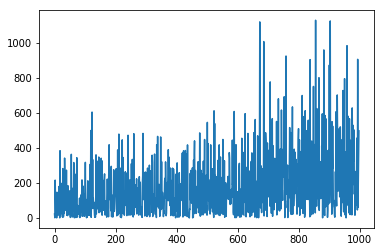

In [7]:
plt.figure()
plt.plot(np.diff(np.sort([t_ for t in times for t_ in t])[-1000:]))

In [8]:
time_per_fl = np.median(np.diff(np.sort([t_ for t in times for t_ in t])[-1000:]))
time_per_fl

118.77164769172668

In [9]:
Nfls_rem = 0
incomplete_aflds = []
for fld in dic_stats:
    Nfls,NflsG,Nfovs = dic_stats[fld]
    if NflsG-Nfls>5:
        print(fld,NflsG-Nfls,NflsG)
        Nfls_rem+=NflsG-Nfls
        incomplete_aflds.append(fld)
(Nfls_rem*time_per_fl/3600)

\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19-AnalysisOB 360 507
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\6_20_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB22-AnalysisOB 270 456
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\6_22_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB20-AnalysisOB 54 470
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_18_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB12-AnalysisOB 199 376
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_21_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB8-AnalysisOB 93 281
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_22_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB24-AnalysisOB 8 445
\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis\7_22_2021__OR

34.641730576753616

In [10]:
analysis_to_ob = {to_analysis_fld(ofld):ofld for ofld in ob_folders_}
ob_folders_rem = [analysis_to_ob[fld]for fld in incomplete_aflds]
ob_folders_rem

['\\\\10.245.74.218\\Raw_data\\Bogdan\\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\6_20_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB22',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\6_22_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB20',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\7_18_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB12',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\7_21_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB8',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\7_22_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB24',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\7_22_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB26']

In [11]:
print(ob_folders_rem[0])

\\10.245.74.218\Raw_data\Bogdan\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19


In [9]:
#afolders

In [12]:
#master_folder = r'\\dolly\Raw_data_4\Bogdan\11_30_2020__OR-MER_lib1,2,3,4,5____CD1mom3_toB6pups_3col_40xStorm3_OB18_OB'
#master_folder = r'\\simon\Raw_data_5\Bogdan\5_06_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB41'
#master_folder = r'\\simon\Raw_data_5\Bogdan\5_06_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB43'
#master_folder = r'\\simon\Raw_data_5\Bogdan\5_08_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB38'
#master_folder = r'\\simon\Raw_data_5\Bogdan\5_08_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB40'

def fit_fov(ifov_master_folder,
            return_obj=False,force=False):
    
    ifov,master_folder = ifov_master_folder
    import numpy as np
    import glob,os,sys
    sys.path.append(r'C:\Users\bogdan\Dropbox\code_Seurat\OR_MERFISH_2020')
    import OB_MER_Analyser_py3_zst as oma
    from imp import reload
    reload(oma)
    
    dec_obj = oma.decoded_fov(master_folder,analysis_folder=r'\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\MOM5-Analysis')
    dec_obj.get_files(htag=r'\H*R*',force=force)
    
    if ifov<len(dec_obj.fovs):
    
        master_folder_ = master_folder
        if type(master_folder) is list:
            master_folder_ = master_folder[0]
        is_storm65 = 'STORM65' in os.path.basename(master_folder_).upper()

        if is_storm65:
            dec_obj.psf_file = r'\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\PSF_Chromatic\psfs_pix256_sz3_STORM65-40X.npy'
            dec_obj.chrom_file = r'\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\PSF_Chromatic\STORM65_dic_chr.pkl'
        else:
            dec_obj.psf_file = r'\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\PSF_Chromatic\psfs_pix256_sz3_STORM3-40X.npy'
            dec_obj.chrom_file = r'\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\PSF_Chromatic\STORM3_dic_chr.pkl'

        #ifov = 30
        dec_obj.get_code(fl=r'C:\Users\bogdan\Dropbox\code_Seurat\OR_MERFISH_2020\SI8_final.fasta')
        dec_obj.fov_index=ifov
        dec_obj.fov = dec_obj.fovs[ifov]
        if not dec_obj.is_complete(ifov) or force:
            if dec_obj.is_good(ifov):
                dec_obj.get_im_OB()
                if np.any(dec_obj.im_OB>0):
                    test_fl = dec_obj.analysis_folder+os.sep+'Decoded'+os.sep+'final_fits__'+dec_obj.fov.replace('.dax','')+'_AOBf.npy'
                    if not os.path.exists(test_fl) or force:
                        dec_obj.get_flatfield(force=False,cols = ['561','647','750','405'],ref=1)
                        #get images
                        dec_obj.get_mapped_ims(ifov,cols = ['561','647','750','405'])

                        fits_folder = dec_obj.analysis_folder+os.sep+'Fits'
                        dec_obj.final_fits_file = fits_folder+os.sep+'final_fits__'+dec_obj.fov.replace('.dax','')+'.pkl'
                        if not os.path.exists(dec_obj.final_fits_file) or force:
                            #get drift
                            dec_obj.get_drift_2d(nsq=4, snorm=40)
                            dec_obj.get_drift_3d(ref=1,sz_big = 21,sz_small=5,size=128,delta_fit=11,th_h=1.25,th_dist=2)

                            #get fit
                            dec_obj.fitall(th_fit=4,th_cor=0.35,maxfev=10,better_fit=False,overwrite=False)
                            dec_obj.get_final_zxyhs(sort=True,overwrite=force)
                        dec_obj.get_Xsf()
                        dec_obj.refine_OB_mask(th_dapi = 1.35,iref = 1,rescs=[2,8,8],radius=15,plt_val=False);
                        dec_obj.set_X_vals(dec_obj.Xsff)
                        
                        #dec_obj.get_intersections(cor_th=0.35,dinstance_th = 2,nRs=18)
                        #dec_obj.clean_intersections(nRs=15)
                        
                        #dec_obj.resk=dec_obj.res#decide whether to clean
                        #dec_obj.organize_inters()
                        #dec_obj.save_intersections()
                        
                        base_dec_file = dec_obj.final_fits_file.replace(os.sep+'Fits'+os.sep,os.sep+'Decoded'+os.sep)
                        if not os.path.exists(os.path.dirname(base_dec_file)): os.makedirs(os.path.dirname(base_dec_file))
                        X_fl = base_dec_file.replace('.pkl','_Xsf.npy')
                        np.save(X_fl,dec_obj.Xsff)
                        
                        AOBf = np.array([dec_obj.OBs,dec_obj.AOBs,dec_obj.aOBs])
                        Afl = base_dec_file.replace('.pkl','_AOBf.npy')
                        np.save(Afl,AOBf)
                        
                        oma.get_new_res_org(X_fl,nRs = 15,cor_th = 0.33,dinstance_th = 2, save_cts=True,nth=6,th_dapis=[1.15,1.35,1.5,2,3,5],tag_OB = 'glom3d.tif')
    if return_obj:
        return dec_obj

In [ ]:
ob_fld =  ob_folders_rem[0]#ob_folders[10]#'\\\\mcclintock\\mcclintock_4\\Bogdan\\7_13_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB39'
obj = fit_fov((230,ob_fld),return_obj=True,force=True)

[-0.16160178 -0.64783826 -0.13360314]
[0. 0. 0.]


In [15]:
ob_fld =  ob_folders_rem[0]
np.sort(glob.glob(to_analysis_fld(ob_fld)+os.sep+r'Decoded\*_Xsf.npy'))

array(['\\\\MCCLINTOCK\\mcclintock_5\\Bogdan-OB-analysis\\MOM5-Analysis\\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19-AnalysisOB\\Decoded\\final_fits__Conv_zscan_000.zst_Xsf.npy',
       '\\\\MCCLINTOCK\\mcclintock_5\\Bogdan-OB-analysis\\MOM5-Analysis\\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19-AnalysisOB\\Decoded\\final_fits__Conv_zscan_001.zst_Xsf.npy',
       '\\\\MCCLINTOCK\\mcclintock_5\\Bogdan-OB-analysis\\MOM5-Analysis\\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19-AnalysisOB\\Decoded\\final_fits__Conv_zscan_002.zst_Xsf.npy',
       '\\\\MCCLINTOCK\\mcclintock_5\\Bogdan-OB-analysis\\MOM5-Analysis\\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19-AnalysisOB\\Decoded\\final_fits__Conv_zscan_003.zst_Xsf.npy',
       '\\\\MCCLINTOCK\\mcclintock_5\\Bogdan-OB-analysis\\MOM5-Analysis\\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19-AnalysisOB\\

In [17]:
#ob_folders_rem =  list(ob_folders[-18:])+list(ob_folders[:18])
paramters = [(ifov,ob_folder_)for ob_folder_ in ob_folders_rem[:2] for ifov in range(1000)][::-1]#[::-1]
#paramters

In [18]:
ob_folders_rem[:2]

['\\\\10.245.74.218\\Raw_data\\Bogdan\\6_20_2021__OR-MER_lib1,2,3,4,5____CD1mom5-new_toB6pups_3col_40xStorm3_OB19',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\6_20_2021__OR-MER_lib6,7,8,9,10,11____CD1mom5-new_toB6pups_3col_40xStorm65_OB22']

In [ ]:
# open terminal
#ipcluster start -n 20
from ipyparallel import Client
rc = Client()
print(len(rc))

import numpy as np
dv = rc[:30]
res = dv.map_sync(fit_fov,paramters)

30


In [217]:
ob_fld = ob_folders_rem[0]
afld = to_analysis_fld(ob_fld)
load_fls = glob.glob(afld+os.sep+'Decoded'+os.sep+'*_cts_dics1.35.pkl')

def update_sum(dicT,dicF={}):
    for key in dicT:
        if key in dicF:
            dicF[key]+=dicT[key]
        else:
            dicF[key]=dicT[key]
    return dicF

ct_dic_4, ct_dic_b4,A_dic,OB_fov_dic = {},{},{},{}
for load_fl in tqdm(load_fls):
    ct_dic_4_,ct_dic_b4_,A_dic_,OB_fov_dic_ = pickle.load(open(load_fl,'rb'))
    ct_dic_4 = update_sum(ct_dic_4_,ct_dic_4)
    ct_dic_b4 = update_sum(ct_dic_b4_,ct_dic_b4)
    A_dic = update_sum(A_dic_,A_dic)
    OB_fov_dic = update_sum(OB_fov_dic_,OB_fov_dic)

In [218]:
reload(oma)
OB_dic_final = oma.get_OB_dic_final(ct_dic_4,ct_dic_b4,A_dic,th_n=5,th_pval = -7.5)
len(OB_dic_final)

232

In [238]:
OB_dic_final

{2: [278, -10.678610148397173, 20.38393983937641, 39.0, 1],
 5: [474, -9.48507163348052, 11.968096400317851, 5.0, 1],
 6: [381, -14.086276541763045, 14.533830103725839, 77.0, 2],
 7: [47, -21.116069171309068, 44.93040923202935, 64.0, 2],
 14: [314, -40.117329063039506, 74.7117584747318, 31.0, 2],
 16: [314, -21.89980768028044, 39.26188420044732, 20.0, 2],
 23: [36, -36.39567511959883, 160.0205379335691, 76.0, 2],
 24: [153, -54.13787462781197, 36.65016175972417, 115.0, 2],
 29: [95, -10.577996450877157, 6.1488434386705295, 12.0, 2],
 30: [36, -27.85238810068799, 118.55799027038582, 14.0, 2],
 31: [36, -46.05923434810948, 207.22358973514204, 222.0, 2],
 32: [278, -29.53526487518501, 45.50133964648554, 100.0, 2],
 35: [430, -21.87138451260835, 63.69135570936463, 42.0, 2],
 36: [446, -8.721118099354609, 17.008295846813255, 5.0, 2],
 38: [278, -15.602961376266462, 23.148655386356197, 45.0, 2],
 39: [430, -21.173863151825266, 61.39317709370523, 31.0, 2],
 40: [430, -10.555830950632643, 26.9

<IPython.core.display.Javascript object>


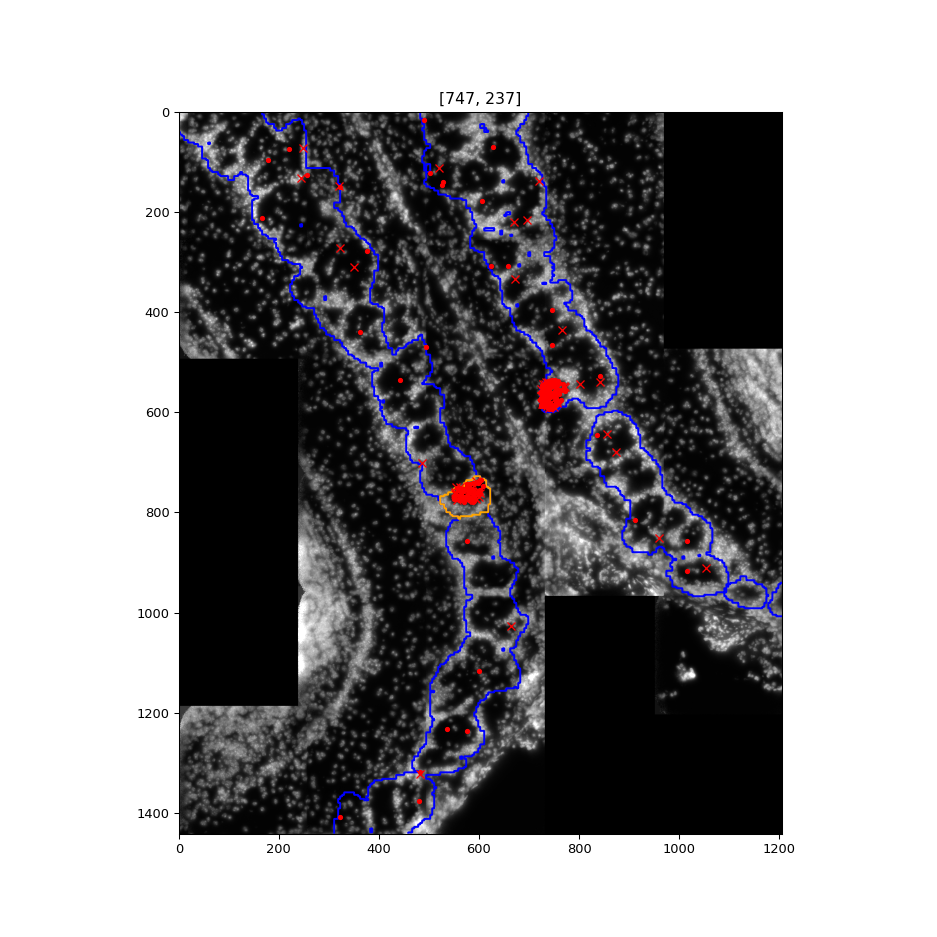

In [257]:
analysis_folder = afld
OB_ = 747
icode = OB_dic_final[OB_][0]
oma.plot_image_glom_test(analysis_folder,OB_,icode,plot_multi=True,th_dapi = 1.15,notOB_only=False,nneigh = 16);

In [229]:
reload(oma)

<module 'OB_MER_Analyser_py3_zst' from 'C:\\Users\\Bogdan\\Dropbox\\code_Seurat\\OR_MERFISH_2020\\OB_MER_Analyser_py3_zst.py'>

In [237]:
icode

321

In [122]:
reload(oma)

<module 'OB_MER_Analyser_py3_zst' from 'C:\\Users\\Bogdan\\Dropbox\\code_Seurat\\OR_MERFISH_2020\\OB_MER_Analyser_py3_zst.py'>

In [185]:
ob_fld =  '\\\\mcclintock\\mcclintock_4\\Bogdan\\7_13_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB39'
obj = fit_fov((50,ob_fld),return_obj=True)


[0.09644472 0.15590255 0.81954819]
[0. 0. 0.]
[-0.13971719  0.07335139 -0.33398415]
[-2.18533945  0.1179354   0.26125099]
[-1.16070563 -0.19972593 -0.13120639]
[-1.21749707  0.26148714  0.00453035]


In [202]:
np.unique(obj.Xsff[:,9])

array([  0., 312., 317., 318., 319., 325., 327., 465., 466.])

(-64.07746357657015,
 1344.9313533622772,
 -95.98547461032868,
 2002.3779587984086)

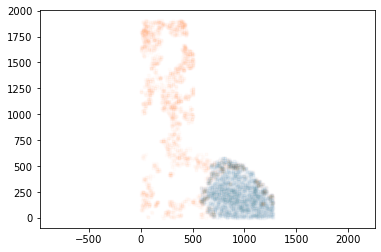

In [205]:
keep = obj.Xsff[:,6]==1
keep = (obj.Xsff[:,9]>0)&(obj.Xsff[:,6]==5)&(obj.Xsff[:,7]>2.15)
X1 = obj.Xsff[keep][:,1:3]
keep = (obj.Xsff[:,6]==5)#&(obj.Xsff[:,7]<1.15)*(obj.Xsff[:,5]>0.45)
keep = (obj.Xsff[:,9]==312)&(obj.Xsff[:,6]==1)
X2 = obj.Xsff[keep][:,1:3]
plt.figure()

plt.plot(X2[:,0],X2[:,1],'.',alpha=0.01)
plt.plot(X1[:,0],X1[:,1],'.',alpha=0.01)
plt.axis('equal')

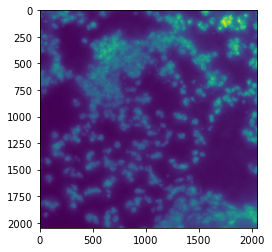

In [187]:
plt.imshow(obj.im_norm_dapi)

In [105]:
obj.get_flatfield(force=False,cols = ['561','647','750','405'],ref=1)
#get images
obj.get_mapped_ims(ifov,cols = ['561','647','750','405'])

In [106]:
print(oma.__file__)

C:\Users\Bogdan\Dropbox\code_Seurat\OR_MERFISH_2020\OB_MER_Analyser_py3_zst.py


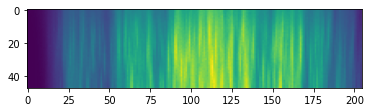

In [179]:
plt.figure()
plt.imshow(np.max(oma.load_im_col(obj.ims_dapi[1])[:,::10,::10],1))

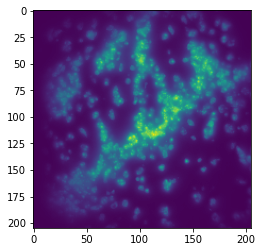

In [166]:
reload(oma)
plt.figure()
plt.imshow(np.max(oma.load_im_col(obj.ims_dapi[0])[:,::10,::10],0))

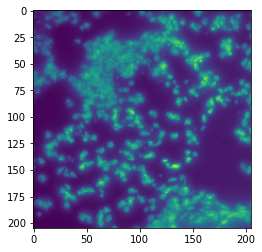

In [191]:
reload(oma)
plt.figure()
plt.imshow(np.max(oma.load_im_col(obj.ims_dapi[1])[:,::10,::10],0))

In [ ]:
obj.

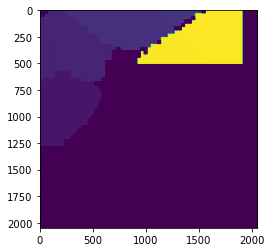

In [190]:
plt.figure()
plt.imshow(obj.im_OB,vmin=np.min(obj.im_OB[obj.im_OB!=0]-10))

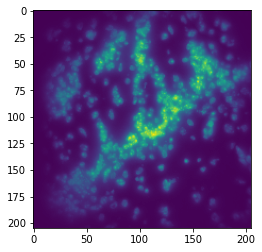

In [136]:
plt.figure()
plt.imshow(np.max(oma.load_im_col(obj.ims_dapi[1])[:,::10,::10],0))

In [135]:
reload(oma)
oma.load_im_col(obj.ims_dapi[2])

array([[[125, 129, 120, ..., 125, 139, 148],
        [113, 122, 119, ..., 125, 117, 126],
        [119, 134, 112, ..., 124, 146, 134],
        ...,
        [176, 127, 119, ..., 149, 146, 140],
        [128, 135, 123, ..., 143, 142, 163],
        [115, 123, 138, ..., 126, 130, 168]],

       [[136, 129, 125, ..., 126, 113, 126],
        [110, 127, 120, ..., 129, 110, 127],
        [106, 116, 110, ..., 137, 142, 123],
        ...,
        [181, 129, 121, ..., 142, 138, 131],
        [131, 118, 125, ..., 147, 128, 132],
        [139, 127, 158, ..., 124, 133, 157]],

       [[117, 143, 128, ..., 129, 136, 128],
        [120, 132, 116, ..., 124, 113, 112],
        [119, 147, 117, ..., 120, 129, 128],
        ...,
        [172, 119, 133, ..., 138, 134, 152],
        [137, 138, 133, ..., 151, 132, 128],
        [122, 134, 110, ..., 124, 121, 110]],

       ...,

       [[105, 131, 121, ..., 129, 111, 125],
        [113, 121, 109, ..., 118, 115, 109],
        [119, 129, 110, ..., 146, 142, 120

In [99]:
ob_fld = '\\\\10.245.74.218\\Raw_data_4\\Bogdan\\7_5_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB25'
obj = fit_fov((50,ob_fld),return_obj=True)



In [78]:
obj.get_flatfield(force=False,cols = ['561','647','750','405'],ref=1)
#get images
obj.get_mapped_ims(ifov,cols = ['561','647','750','405'])

In [84]:
oma.get_new_name(obj.ims_dapi[2][0])

'\\\\10.245.74.218\\Raw_data_4\\Bogdan\\7_5_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB25\\H2R4,5,6;T1,2,3\\Conv_zscan_099.dax'

In [79]:
obj.ims_dapi

[('\\\\10.245.74.218\\Raw_data_4\\Bogdan\\7_5_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB25\\H0cfos,EGR1\\Conv_zscan_099.dax.zst',
  3,
  4),
 ('\\\\10.245.74.218\\Raw_data_4\\Bogdan\\7_5_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB25\\H1R1,2,3;TEGR1\\Conv_zscan_099.dax.zst',
  3,
  4),
 ('\\\\10.245.74.218\\Raw_data_4\\Bogdan\\7_5_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB25\\H2R4,5,6;T1,2,3\\Conv_zscan_099.dax.zst',
  3,
  4),
 ('\\\\10.245.74.218\\Raw_data_4\\Bogdan\\7_5_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB25\\H3R7,8,9;T4,5,6\\Conv_zscan_099.dax.zst',
  3,
  4),
 ('\\\\10.245.74.218\\Raw_data_4\\Bogdan\\7_5_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB25\\H4R10,11,12;T7,8,9\\Conv_zscan_099.dax.zst',
  3,
  4),
 ('\\\\10.245.74.218\\Raw_data_4\\Bogdan\\7_5_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB25\\H5R13,14,15;T10,11,12\\Conv_zscan_0

In [74]:
npy_fls[icol]

NameError: name 'npy_fls' is not defined

In [62]:
print(ob_fld)

\\10.245.74.218\Raw_data_4\Bogdan\7_5_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB25


In [231]:
ob_folders_rem = []
for ob_folder in ob_folders_:
    afld = to_analysis_fld(ob_folder)
    if not os.path.exists(afld+os.sep+'FinalDecoding'):
        ob_folders_rem.append(ob_folder)

In [4]:
ob_folders_rem=['\\\\10.245.74.218\\Raw_data_4\\Bogdan\\7_7_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB13',
 '\\\\10.245.74.218\\Raw_data_4\\Bogdan\\7_7_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB15',
 '\\\\10.245.74.218\\Raw_data_4\\Bogdan\\7_7_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB17',
 '\\\\10.245.74.218\\Raw_data_4\\Bogdan\\7_7_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB19',
 '\\\\10.245.74.218\\Raw_data_2\\Bogdan\\6_27_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB21',
 '\\\\10.245.74.218\\Raw_data_2\\Bogdan\\6_27_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB23',
 '\\\\10.245.74.218\\Raw_data_4\\Bogdan\\7_5_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB25',
 '\\\\10.245.74.218\\Raw_data_4\\Bogdan\\7_5_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB27',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\6_25_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm3_OB29',
 '\\\\10.245.74.218\\Raw_data_4\\Bogdan\\7_8_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB34',
 '\\\\10.245.74.218\\Raw_data\\Bogdan\\6_25_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm65_OB35',
 '\\\\10.245.74.218\\Raw_data_4\\Bogdan\\7_8_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB36']

20


### Troubleshoot

<IPython.core.display.Javascript object>


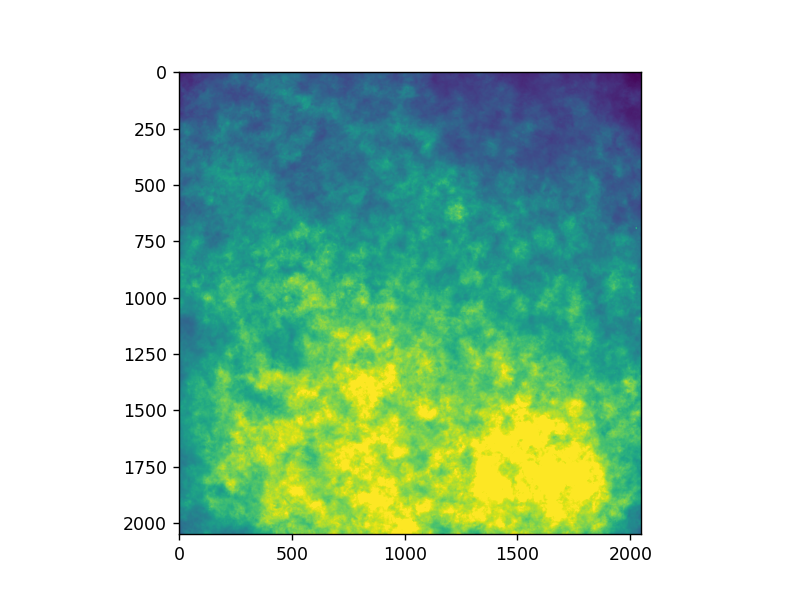

In [223]:
plt.figure()
plt.imshow(obj.ims_mean[3],vmax=5000)

In [203]:
obj.libs

(6, 7, 8, 9, 10, 11)

In [123]:
ims_align_ref = obj.ims_dapi[0]
len(ims_align_ref)

50

In [178]:
dtf = oma.get_best_trans(Xh1,Xh2,th_h=1.25,th_dist=2)
dtf

array([-0.95085585, 14.47558455, 14.05112109])

In [ ]:
Xh2_ = 

<IPython.core.display.Javascript object>


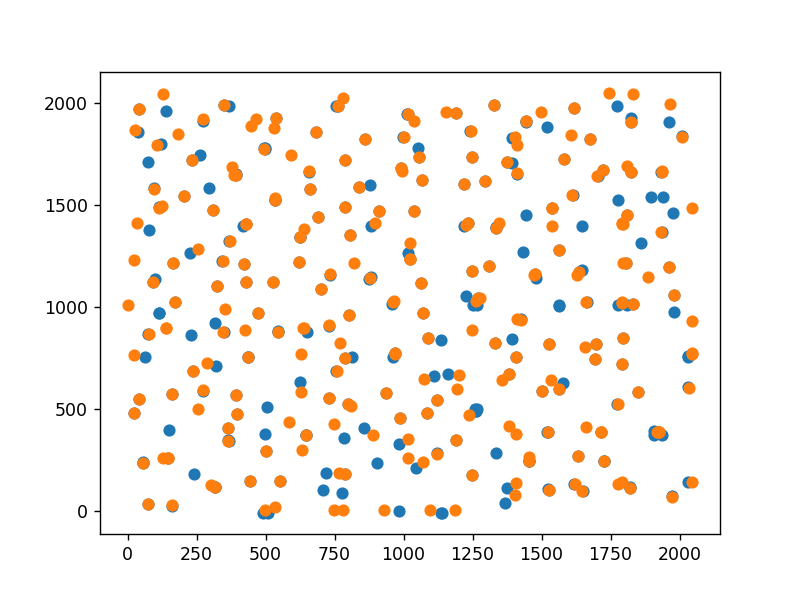

In [180]:
plt.figure()
plt.plot(Xh1[:,1]-dtf[1],Xh1[:,2]-dtf[2],'o')
plt.plot(Xh2[:,1],Xh2[:,2],'o')

<IPython.core.display.Javascript object>


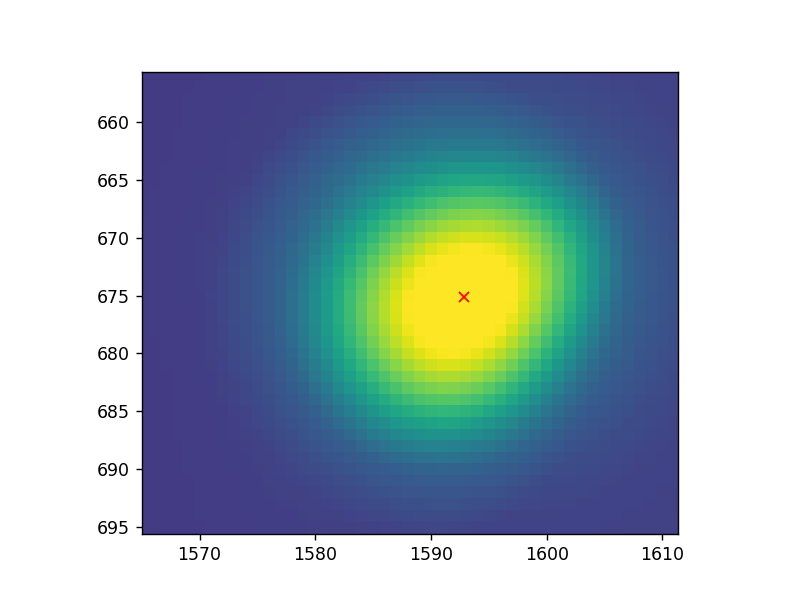

In [175]:
ims_align = oma.load_im_col(obj.ims_dapi[-1])
Xh1 = oma.get_uniform_points(ims_align,sz_big = 21,sz_small=5,size=128,delta_fit=11,plt_val=True)

<IPython.core.display.Javascript object>


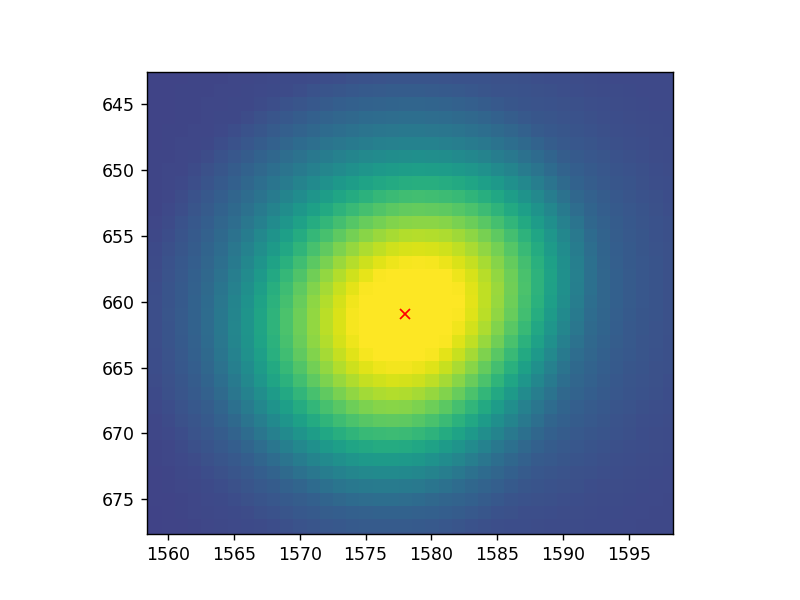

In [174]:
ims_align_ref = oma.load_im_col(obj.ims_dapi[1])
Xh2 = oma.get_uniform_points(ims_align_ref,sz_big = 21,sz_small=5,size=128,delta_fit=11,plt_val=True)

In [ ]:
sz_big = 21,sz_small=5,size=128,delta_fit=11,th_h=1.5,th_dist=2

In [75]:
%matplotlib notebook

<IPython.core.display.Javascript object>


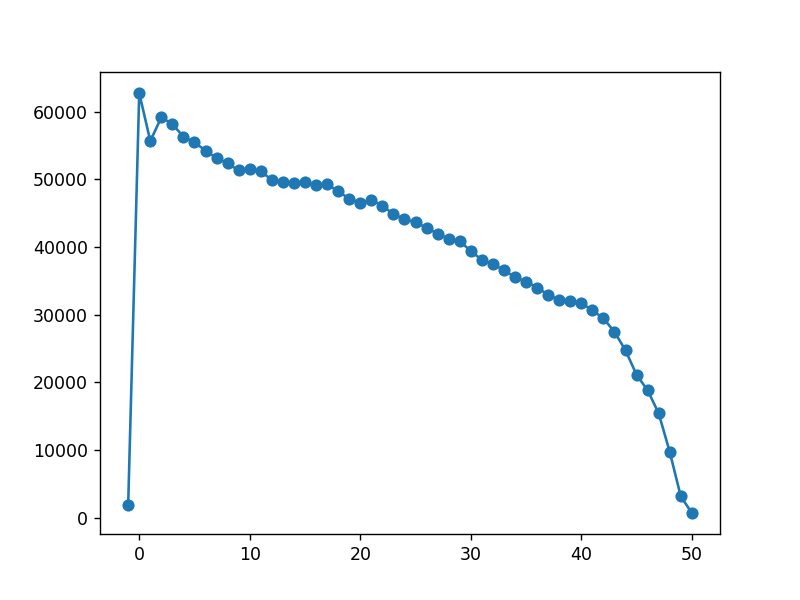

In [181]:
x,y = np.unique(np.array(obj.Xsff[:,0],dtype=int),return_counts=True)
plt.figure()
plt.plot(x,y,'-o')

(-97.19291753470898, 2024.8405900090934, -103.01970229446889, 2148.3147054106)

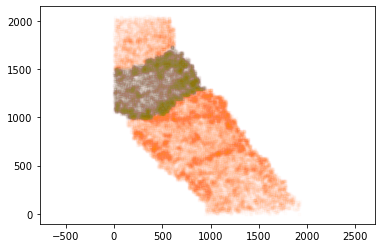

In [164]:
keep = obj.Xsff[:,6]==1
keep = (obj.Xsff[:,9]>0)&(obj.Xsff[:,6]==5)
X1 = obj.Xsff[keep][:,1:3]
keep = (obj.Xsff[:,6]==5)#&(obj.Xsff[:,7]<1.15)*(obj.Xsff[:,5]>0.45)
keep = (obj.Xsff[:,9]==504)&(obj.Xsff[:,6]==5)
X2 = obj.Xsff[keep][:,1:3]
plt.figure()

plt.plot(X2[:,0],X2[:,1],'.',alpha=0.01)
plt.plot(X1[:,0],X1[:,1],'.',alpha=0.01)
plt.axis('equal')

In [152]:
np.unique()

array([  0., 488., 494., 497., 498., 504., 510.])

<IPython.core.display.Javascript object>


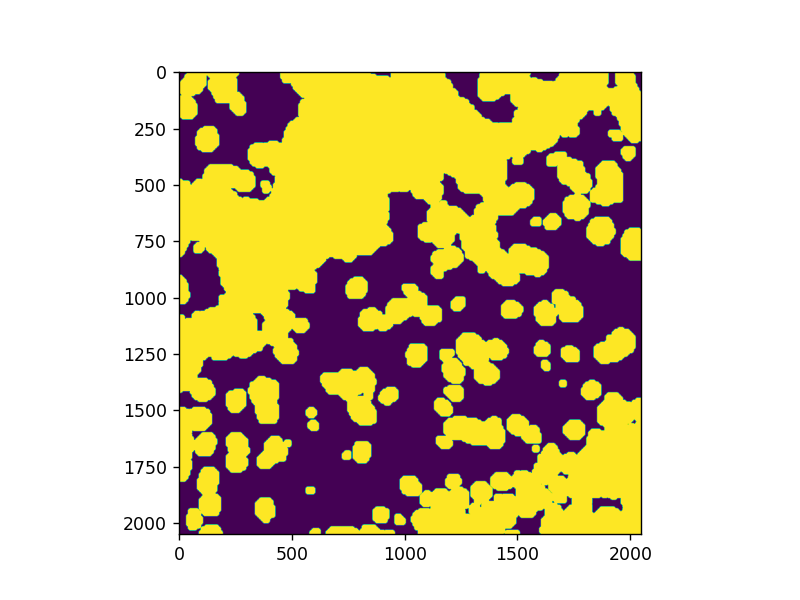

In [186]:
plt.figure()
plt.imshow(obj.im_dapi_th)

In [36]:
print('\\\\mcclintock\\mcclintock_5\\Bogdan\\6_11_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB10')

\\mcclintock\mcclintock_5\Bogdan\6_11_2021__OR-MER_lib1,2,3,4,5____CD1mom4-new_toB6pups_3col_40xStorm3_OB10


In [27]:
import OB_MER_Analyser_py3_zst as oma
from imp import reload
reload(oma)

<module 'OB_MER_Analyser_py3_zst' from 'C:\\Users\\Bogdan\\Dropbox\\code_Seurat\\OR_MERFISH_2020\\OB_MER_Analyser_py3_zst.py'>

In [19]:
type(ob_folders_[0])

numpy.str_

In [22]:
[os.path.exists(to_analysis_fld(master_fld)) for master_fld in ob_folders_]

[True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True]

In [14]:
len(ob_folders_)

32

In [15]:
oma.__file__

'C:\\Users\\Bogdan\\Dropbox\\code_Seurat\\OR_MERFISH_2020\\OB_MER_Analyser_py3.py'

In [3]:
ifov = 22
dec_obj = fit_fov(ifov,return_obj=True,force=False)

C:\Users\Bogdan\Anaconda3\lib\site-packages\numpy\core\_asarray.py:171: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return array(a, dtype, copy=False, order=order, subok=True)



[-0.29130363 -1.90241873 -1.10052009]
[0. 0. 0.]
[ 0.05027684 -0.048474   -0.99603075]
[-0.12528922  0.08711006 -1.64196359]
[-0.04130115 -0.11961861 -2.38018627]
[-1.10956106 -0.77635758 -1.93263979]


C:\Users\Bogdan\Dropbox\code_Seurat\OR_MERFISH_2020\OB_MER_Analyser_py3.py:1874: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  self.res = np.array([np.array(eval(e)) for e in np.unique([str(list(np.sort(r))) for r in res])])#make unique


In [40]:
#len([fov for fov in tqdm(dec_obj.fovs) if np.all([os.path.exists(fld+os.sep+fov) for fld in dec_obj.Hfolders])])

20 146


In [ ]:
import numpy as np
dv = rc[8:12]
res = dv.map_sync(fit_fov,np.arange(len(dec_obj.fovs)))

# Run intersections on dataset

In [1]:
import numpy as np
import glob,os,sys
import cv2
from tqdm import tqdm_notebook as tqdm
from sklearn.cluster import KMeans
from imp import reload
import matplotlib.pylab as plt
import pickle
from scipy.spatial import cKDTree
import OB_MER_Analyser_py3 as oma
import tifffile
reload(oma)

<module 'OB_MER_Analyser_py3' from 'C:\\Users\\bogdan\\Dropbox\\code_Seurat\\OR_MERFISH_2020\\OB_MER_Analyser_py3.py'>

In [8]:
reload(oma)
master_folder = r'\\dolly\Raw_data_4\Bogdan\11_30_2020__OR-MER_lib6,7,8,9,10,11____CD1mom3_toB6pups_3col_40xStorm65_OB20'
dec_obj = oma.decoded_fov(master_folder,analysis_folder=r'F:\Bogdan')
dec_obj.get_files(htag=r'\H*R*')
dec_obj.psf_file = r'F:\Bogdan\PSF_Chromatic\psfs_pix256_sz3_STORM3-40X.npy'
dec_obj.chrom_file = r'F:/Bogdan/PSF_Chromatic/STORM3_dic_chr.pkl'

dec_obj.get_code(fl=r'SI8_final.fasta')



In [11]:
ifov = 30
dec_obj.fov_index=ifov
dec_obj.get_im_OB()

In [12]:
np.sum(dec_obj.im_OB)

5619076

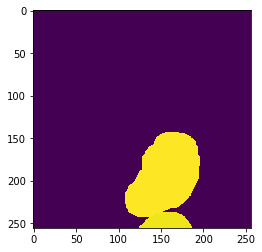

In [13]:
plt.figure()
plt.imshow(dec_obj.im_OB)

In [16]:
len(dec_obj.codes_valid)
dec_obj.get_flatfield(force=False,cols = ['561','647','750','405'],ref=1)
dec_obj.get_mapped_ims(ifov,cols = ['561','647','750','405'])

In [19]:
dec_obj.get_Xsf()
dec_obj.refine_OB_mask(th_dapi = 1.35,iref = 1,rescs=[2,8,8],radius=15,plt_val=False);

In [20]:
dec_obj.get_intersections(cor_th=0.45,dinstance_th = 2,nRs=18)
dec_obj.set_X_vals(dec_obj.Xsff)
dec_obj.clean_intersections(nRs=15)
dec_obj.organize_inters()
dec_obj.save_intersections()

In [73]:
reload(oma)
#master_folder = r'\\dolly\Raw_data_4\Bogdan\11_30_2020__OR-MER_lib1,2,3,4,5____CD1mom3_toB6pups_3col_40xStorm3_OB18_OB'
master_folder = r'\\dolly\Raw_data_4\Bogdan\11_30_2020__OR-MER_lib6,7,8,9,10,11____CD1mom3_toB6pups_3col_40xStorm65_OB20'
dec_obj = oma.decoded_fov(master_folder,analysis_folder=r'F:\Bogdan')
dec_obj.get_files(htag=r'\H*R*')
dec_obj.psf_file = r'F:\Bogdan\PSF_Chromatic\psfs_pix256_sz3_STORM65-40X.npy'
dec_obj.chrom_file = r'F:/Bogdan/PSF_Chromatic/STORM65_dic_chr.pkl'
#ifov = 30
dec_obj.get_code(fl=r'SI8_final.fasta')
for ifov in tqdm(np.arange(len(dec_obj.fovs))[:]):#[59, 79, 90, 108, 155, 157, 166, 170, 201, 202, 203, 204, 205, 206, 245, 275, 282, 301, 313, 314, 315, 316, 317, 318, 319, 320, 321, 327, 335, 336, 341, 342, 343, 344, 371, 388, 406, 409, 470]):#
    dec_obj.fov_index=ifov
    dec_obj.fov = dec_obj.fovs[ifov]
    dec_obj.get_im_OB()
    if np.any(dec_obj.im_OB>0):
        test_fl = dec_obj.analysis_folder+os.sep+'Decoded'+os.sep+'final_fits__'+dec_obj.fov.replace('.dax','')+'_AOBf.npy'
        if not os.path.exists(test_fl):
            dec_obj.get_flatfield(force=False,cols = ['561','647','750','405'],ref=1)
            #get images
            dec_obj.get_mapped_ims(ifov,cols = ['561','647','750','405'])

            fits_folder = dec_obj.analysis_folder+os.sep+'Fits'
            dec_obj.final_fits_file = fits_folder+os.sep+'final_fits__'+dec_obj.fov.replace('.dax','')+'.pkl'
            if not os.path.exists(dec_obj.final_fits_file):
                #get drift
                dec_obj.get_drift_3d(ref=1,sz_big = 21,sz_small=5,size=128,delta_fit=11,th_h=1.5,th_dist=2)
                dec_obj.get_drift_2d(nsq=4, snorm=40)
                #get fit
                dec_obj.fitall(th_fit=4,th_cor=0.35,maxfev=10,better_fit=False,overwrite=False)
                dec_obj.get_final_zxyhs(sort=True,overwrite=False)
            dec_obj.get_Xsf()
            dec_obj.refine_OB_mask(th_dapi = 1.35,iref = 1,rescs=[2,8,8],radius=15,plt_val=False);

            dec_obj.get_intersections(cor_th=0.45,dinstance_th = 2,nRs=18)
            dec_obj.set_X_vals(dec_obj.Xsff)
            dec_obj.clean_intersections(nRs=15)
            dec_obj.organize_inters()
            dec_obj.save_intersections()
        

C:\Users\bogdan\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3118: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
C:\Users\bogdan\Anaconda3\lib\site-packages\numpy\core\_methods.py:78: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


In [50]:
#[59, 79, 90, 108, 155, 157, 166, 170, 201, 202, 203, 204, 205, 206, 245, 275, 282, 301, 313, 314, 315, 316, 317, 318, 319, 320, 321, 327, 335, 336, 341, 342, 343, 344, 371, 388, 406, 409, 470][8]

In [82]:
reload(oma)
master_folder = r'\\dolly\Raw_data_4\Bogdan\11_30_2020__OR-MER_lib6,7,8,9,10,11____CD1mom3_toB6pups_3col_40xStorm65_OB20'
dec_obj = oma.decoded_fov(master_folder,analysis_folder=r'F:\Bogdan')
dec_obj.get_files(htag=r'\H*R*')
dec_obj.psf_file = r'F:\Bogdan\PSF_Chromatic\psfs_pix256_sz3_STORM65-40X.npy'
dec_obj.chrom_file = r'F:/Bogdan/PSF_Chromatic/STORM65_dic_chr.pkl'
dec_obj.get_code(fl=r'SI8_final.fasta')


In [48]:
ct_dic_4,ct_dic_b4 = {},{}
A_dic,OB_fov_dic = {},{}
for ifov in tqdm(range(len(dec_obj.fovs))):
    dec_obj.fov_index=ifov
    dec_obj.fov = dec_obj.fovs[ifov]
    fl = dec_obj.analysis_folder+os.sep+'Decoded'+os.sep+'final_fits__'+dec_obj.fov.replace('.dax','')+'_Xsf.npy'
    if os.path.exists(fl):
        dec_obj.Xsff = np.load(fl)
        dec_obj.set_X_vals(dec_obj.Xsff)
        dec_obj.res_org = np.load(fl.replace('_Xsf.npy','_res_org.npy'),allow_pickle=True)
        dec_obj.OBs,dec_obj.AOBs,dec_obj.aOBs = np.load(fl.replace('_Xsf.npy','_AOBf.npy'),allow_pickle=True)


        ct_dic_4 = dec_obj.update_OBcount_dic(ct_dic=ct_dic_4,ires_org = 2)
        ct_dic_b4 = dec_obj.update_OBcount_dic(ct_dic=ct_dic_b4,ires_org = 3,n_th=5)
        A_dic,OB_fov_dic = dec_obj.update_OBarea_fov_dic(A_dic=A_dic,OB_fov_dic=OB_fov_dic)

In [49]:
save_folder = dec_obj.analysis_folder+os.sep+'FinalDecoding'
if not os.path.exists(save_folder):os.makedirs(save_folder)
np.save(save_folder+os.sep+'ct_A_OBfov.npy',[ct_dic_4,ct_dic_b4,A_dic,OB_fov_dic])

# Get statistics of OB decoding

In [46]:
print(dec_obj.analysis_folder)

\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\4_17_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB44-AnalysisOB


In [93]:
save_folder = dec_obj.analysis_folder+os.sep+'FinalDecoding'
ct_dic_4,ct_dic_b4,A_dic,OB_fov_dic = np.load(save_folder+os.sep+'ct_A_OBfov.npy',allow_pickle=True)

In [76]:
OBs_all = np.sort(list(A_dic.keys()))[1:]#list(A_dic.keys())[1:]

In [77]:
len(OBs_all)

173

<module 'OB_MER_Analyser_py3' from 'C:\\Users\\Bogdan\\Dropbox\\code_Seurat\\OR_MERFISH_2020\\OB_MER_Analyser_py3.py'>

In [172]:
#OB_ = OBs_all[123]
reload(oma)
top_th_score_4=[]
top_th_score_4_extended = []
for OB_ in tqdm(OBs_all):
    print(OB_,A_dic[OB_])
    nth = 5
    best_icds,scores_icds,ncts = oma.get_stats_ob(ct_dic_4,A_dic,OB_ = OB_,nth = nth,verbose=5)
    top_th_score_4.append([scores_icds[0],best_icds[0],ncts[0]])
    best_icds,scores_icds,ncts = oma.get_stats_ob(ct_dic_b4,A_dic,OB_ = OB_,nth = nth,verbose=0)
    ndec = {OB_:ct_dic_4[OB_]+ct_dic_b4[OB_]for OB_ in ct_dic_4}
    best_icds,scores_icds,ncts = oma.get_stats_ob(ndec,A_dic,OB_ = OB_,nth = nth,verbose=5)
    top_th_score_4_extended.append([scores_icds[0],best_icds[0],ncts[0]])

1.0 [328721. 540176. 132293. 239983.]
score: [7.6  5.73 4.74 4.73 4.53] icode: [149 164 123 447 109] npts: [6. 7. 6. 5. 6.]
score: [6.4  5.6  4.84 4.55 4.4 ] icode: [149 298 437 335 125] npts: [ 8.  9.  8. 12.  8.]
2.0 [136746. 371038.  51923. 149165.]
score: [3.   1.9  1.59 1.39 1.31] icode: [382 162 195  35 554] npts: [ 5. 15.  6. 11.  5.]
score: [6.31 4.88 4.82 4.25 4.14] icode: [605  79 170 406 284] npts: [5. 5. 5. 6. 8.]
3.0 [180563. 350932.  68716. 150190.]
score: [4.43 4.4  4.05 3.56 3.29] icode: [458 300 284 354 378] npts: [5. 5. 5. 5. 7.]
score: [6.61 5.96 5.81 5.   4.77] icode: [147 336  26 458 300] npts: [ 8.  6.  5. 10.  9.]
4.0 [ 52210. 191666.  15151.  63285.]
score: [0. 0. 0. 0. 0.] icode: [621 204 211 210 209] npts: [0. 0. 0. 0. 0.]
score: [0. 0. 0. 0. 0.] icode: [621 204 211 210 209] npts: [1. 0. 0. 0. 0.]
5.0 [ 86203. 183179.  40948.  93127.]
score: [1.18 1.02 0.89 0.   0.  ] icode: [302 409 118 621 203] npts: [6. 5. 5. 1. 0.]
score: [4.05 3.44 2.36 1.34 1.3 ] icode: 

score: [6.72 5.14 2.05 2.02 1.65] icode: [ 56 596 554 409 360] npts: [ 9.  6.  5. 10.  8.]
score: [15.38 10.82  7.47  7.05  7.05] icode: [319 447 619 200 309] npts: [5. 5. 5. 5. 5.]
78.0 [229337. 546806. 130912. 300295.]
score: [10.74  6.81  5.49  5.06  4.67] icode: [581  53 285 272 425] npts: [ 5.  5.  5. 10.  7.]
score: [7.53 6.36 5.09 5.09 5.05] icode: [329 581  64  53  40] npts: [6. 5. 6. 6. 7.]
79.0 [ 45479. 219395.  23476. 109756.]
score: [2.91 2.74 2.72 2.5  2.36] icode: [175  69 409 106 118] npts: [ 8.  9.  7. 11.  7.]
score: [9.39 5.43 4.48 3.7  3.14] icode: [117  99 101  55 554] npts: [6. 5. 5. 6. 7.]
80.0 [ 15340. 159978.   9304.  92775.]
score: [0. 0. 0. 0. 0.] icode: [621 204 211 210 209] npts: [0. 0. 0. 0. 0.]
score: [6.93 5.05 3.07 0.   0.  ] icode: [620 360 175 205 211] npts: [6. 9. 5. 0. 0.]
81.0 [ 362727. 1237568.  173567.  573455.]
score: [6.33 5.06 3.96 3.9  3.85] icode: [548 489 407  67 230] npts: [5. 6. 6. 5. 5.]
score: [5.59 3.88 3.77 3.57 3.54] icode: [548 407 4

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 [11.75  6.92  4.93  3.4   2.99] icode: [253 181 457 533 545] npts: [6. 5. 6. 5. 5.]
score: [12.27  8.28  5.36  5.31  5.3 ] icode: [253 446 308 181 224] npts: [10.  5.  6.  6.  5.]
156.0 [ 1184. 52961.   331. 27249.]
score: [0. 0. 0. 0. 0.] icode: [621 204 211 210 209] npts: [0. 0. 0. 0. 0.]
score: [0. 0. 0. 0. 0.] icode: [621 204 211 210 209] npts: [0. 0. 0. 0. 0.]
157.0 [ 32281. 331845.  13780. 133487.]
score: [2.79 1.91 0.   0.   0.  ] icode: [360 106 621 209 208] npts: [5. 6. 1. 0. 0.]
score: [3.2  1.68 1.42 0.   0.  ] icode: [360  69 106 211 210] npts: [12.  7.  7.  2.  0.]
158.0 [139693. 661470.  75662. 327168.]
score: [8.22 5.57 5.31 4.8  3.21] icode: [128 555 519 514 596] npts: [5. 5. 5. 5. 6.]
score: [10.05  6.6   5.95  5.63  5.53] icode: [294 128 582 327 269] npts: [7. 7. 5. 6. 6.]
159.0 [130709. 388749.  82117. 244150.]
score: [7.52 6.82 5.33 4.99 4.69] icode: [ 81   9 479 325 152] npts: [6. 5. 5. 6. 6.]
score: [11.21  9.79  9.06  8.34  7.57] icode: [209  49 485 373 224] npt

In [27]:
dec_obj.codes_valid[14],dec_obj.codes_valid[529]

(array([2, 5, 6, 7]), array([ 2,  5,  7, 14]))

In [176]:
th_score1,th_score2=20,10
th_count=5
top_th_score_4,top_th_score_4_extended = np.array(top_th_score_4),np.array(top_th_score_4_extended)
OB_dic_final = {}
for (sc1,icd1,ncd1),(sc2,icd2,ncd2),OB_ in zip(top_th_score_4,top_th_score_4_extended,OBs_all):
    if sc1>th_score1:
        OB_dic_final[OB_]=(icd1,sc1,ncd1,1)
    elif sc2>th_score2 and ncd2>=th_count:
        OB_dic_final[OB_]=(icd2,sc2,ncd2,2)

dec_obj.OB_dic_final=OB_dic_final

In [ ]:
ct_dic_4

In [177]:
OBs_decoded = list(OB_dic_final.keys())

print("Number of glomeruli decoded:",len(OBs_decoded))
As_decoded = [A_dic[OB_][1] for OB_ in OBs_decoded]
As_all = [A_dic[OB_][1] for OB_ in OBs_all]
Am,AM = np.percentile(As_decoded,5),np.percentile(As_decoded,95)
print("Detection efficiency:",np.round(1.*len(OBs_decoded)/np.sum(np.array(As_all)>Am),2))

cds_,ncds_ = np.unique([OB_dic_final[OB_][0] for OB_ in OB_dic_final],return_counts=True)
print("Median number of glomeruli per gene:",np.mean(ncds_))
print("Number of genes decoded:",len(cds_))
np.array(list(zip(cds_[np.argsort(ncds_)],np.sort(ncds_))))

Number of glomeruli decoded: 47
Detection efficiency: 0.28
Median number of glomeruli per gene: 1.0
Number of genes decoded: 47


array([[  4.,   1.],
       [294.,   1.],
       [318.,   1.],
       [319.,   1.],
       [351.,   1.],
       [379.,   1.],
       [383.,   1.],
       [384.,   1.],
       [413.,   1.],
       [445.,   1.],
       [292.,   1.],
       [459.,   1.],
       [481.,   1.],
       [484.,   1.],
       [492.,   1.],
       [502.,   1.],
       [503.,   1.],
       [511.,   1.],
       [525.,   1.],
       [538.,   1.],
       [554.,   1.],
       [468.,   1.],
       [574.,   1.],
       [282.,   1.],
       [270.,   1.],
       [  8.,   1.],
       [ 15.,   1.],
       [ 18.,   1.],
       [ 31.,   1.],
       [ 37.,   1.],
       [ 38.,   1.],
       [ 47.,   1.],
       [ 95.,   1.],
       [116.,   1.],
       [276.,   1.],
       [117.,   1.],
       [151.,   1.],
       [154.,   1.],
       [171.,   1.],
       [186.,   1.],
       [209.,   1.],
       [243.,   1.],
       [253.,   1.],
       [262.,   1.],
       [268.,   1.],
       [124.,   1.],
       [610.,   1.]])

In [178]:
OB_dic_final

{14.0: (270.0, 10.190198109019992, 5.0, 2),
 17.0: (554.0, 13.78943942523946, 5.0, 2),
 20.0: (413.0, 10.407193639101287, 8.0, 2),
 29.0: (445.0, 12.400871707169639, 5.0, 2),
 34.0: (186.0, 12.635519862391732, 5.0, 2),
 37.0: (243.0, 18.65574995394195, 7.0, 2),
 39.0: (492.0, 12.116274614520131, 8.0, 2),
 40.0: (154.0, 20.00916140307031, 19.0, 2),
 47.0: (47.0, 11.038292880899588, 5.0, 2),
 56.0: (318.0, 13.64705665142685, 5.0, 2),
 57.0: (538.0, 10.137287360947793, 5.0, 2),
 58.0: (268.0, 15.523813309982609, 6.0, 2),
 59.0: (262.0, 10.536328155142959, 5.0, 2),
 64.0: (276.0, 18.652442279304406, 5.0, 2),
 65.0: (503.0, 19.83012431933332, 5.0, 2),
 77.0: (319.0, 15.382859921371663, 5.0, 2),
 83.0: (37.0, 12.92464244493473, 5.0, 2),
 86.0: (95.0, 20.236182671216184, 6.0, 2),
 87.0: (117.0, 10.858836412458626, 5.0, 2),
 92.0: (511.0, 21.188553873686345, 5.0, 2),
 93.0: (151.0, 11.235835816000048, 6.0, 2),
 95.0: (38.0, 15.854236245900184, 5.0, 2),
 98.0: (384.0, 23.134784222613067, 5.0, 2

# Plot single olfr receptors

In [103]:
print(dec_obj.analysis_folder)

\\MCCLINTOCK\mcclintock_5\Bogdan-OB-analysis\4_17_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB44-AnalysisOB


In [105]:
im_labf,limits = np.load(dec_obj.analysis_folder+os.sep+'dapi_resc8_glomLayer.tif.npy',allow_pickle=True)
im_dapi = tifffile.imread(dec_obj.analysis_folder+os.sep+'dapi_resc8.tif')
contours,hier = cv2.findContours(im_labf.astype(np.int32),cv2.RETR_FLOODFILL, cv2.CHAIN_APPROX_NONE)

([(164.0, (295.0, 10.011936613999675, 5.0, 2))], 'Olfr881_8', (2, 4, 12, 13))


<IPython.core.display.Javascript object>


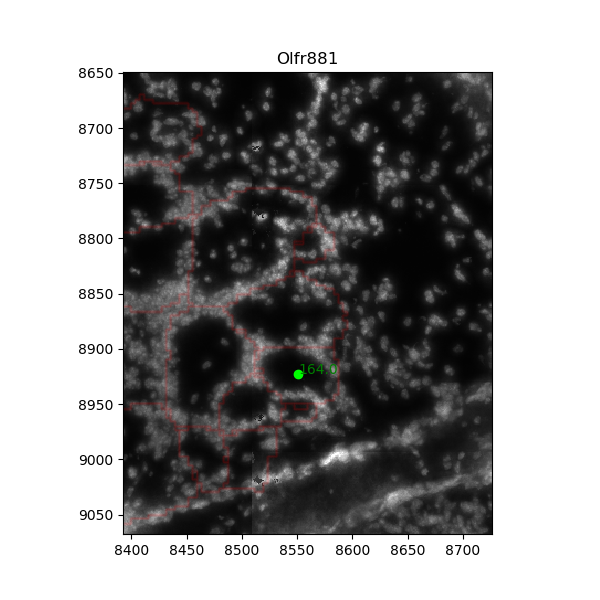

In [119]:
reload(oma)
oma.check_glomeruli_decoding(dec_obj,icode=295);

In [125]:
dec_obj.analysis_folder

'\\\\MCCLINTOCK\\mcclintock_5\\Bogdan-OB-analysis\\4_17_2021__OR-MER_lib6,7,8,9,10,11____CD1mom4-new_toB6pups_3col_40xStorm65_OB44-AnalysisOB'

In [127]:
OB_ = 104
int(OB_dic_final[OB_][0])

4

In [134]:
len(dec_obj.fovs)
analysis_folder= dec_obj.analysis_folder
import tifffile
imglom = tifffile.imread(dec_obj.analysis_folder+os.sep+'glom3d.tif')

array([81, 82], dtype=int64)

In [148]:
%matplotlib inline

C:\Users\Bogdan\Anaconda3\lib\site-packages\ipykernel_launcher.py:78: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


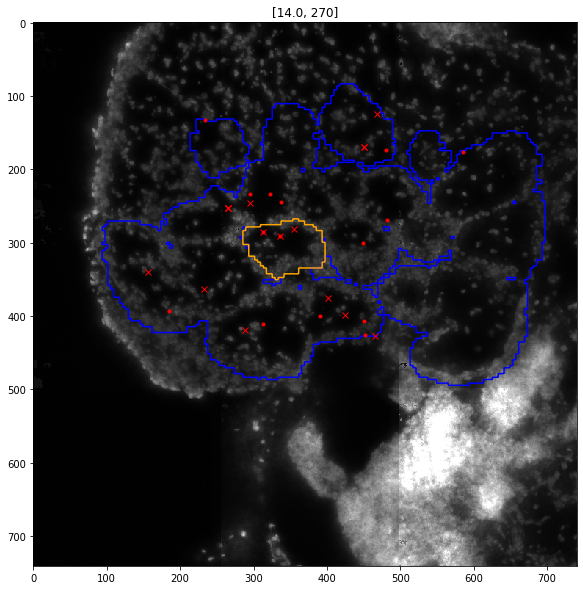

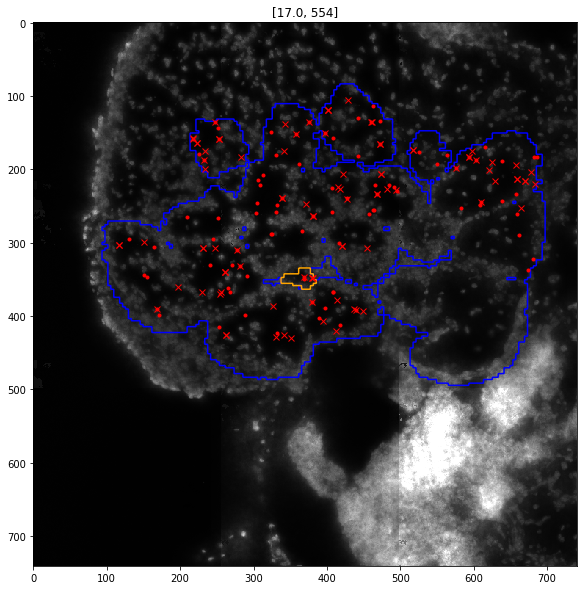

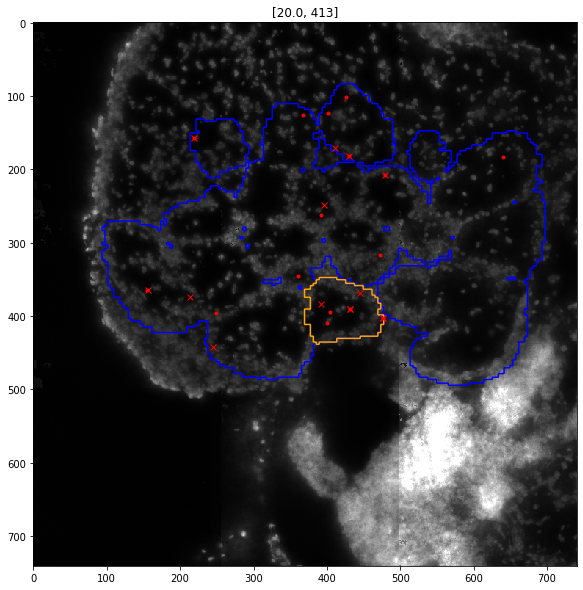

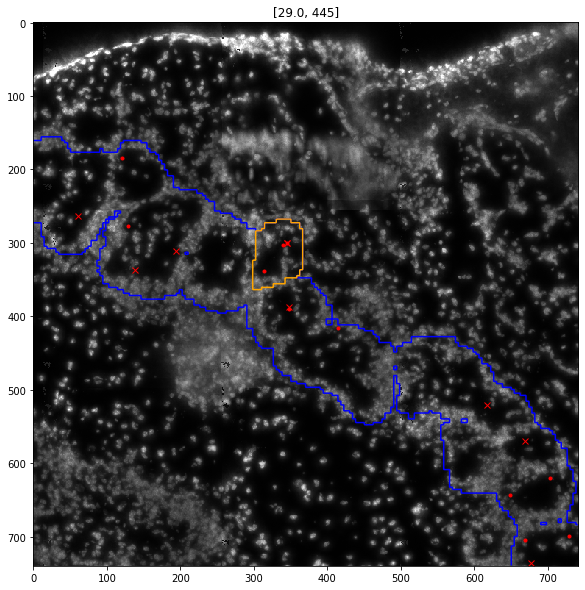

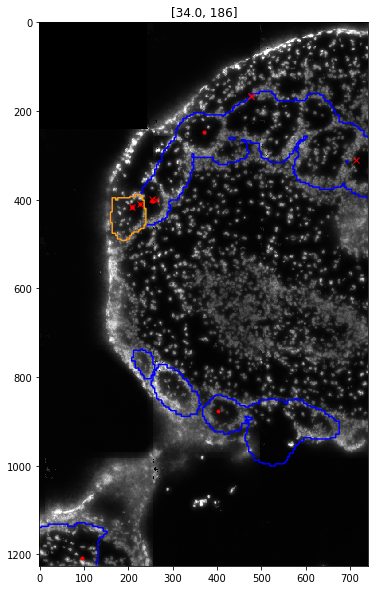

...

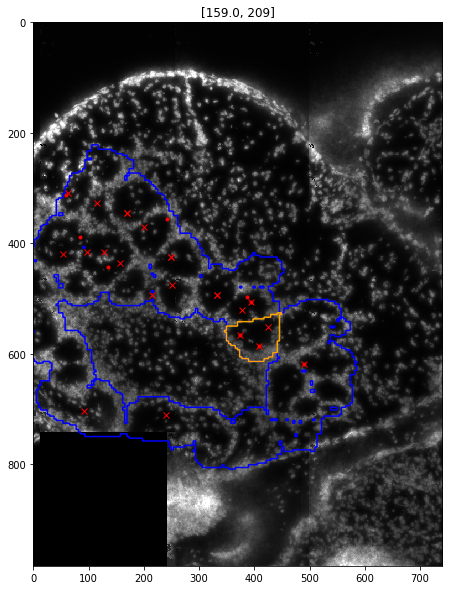

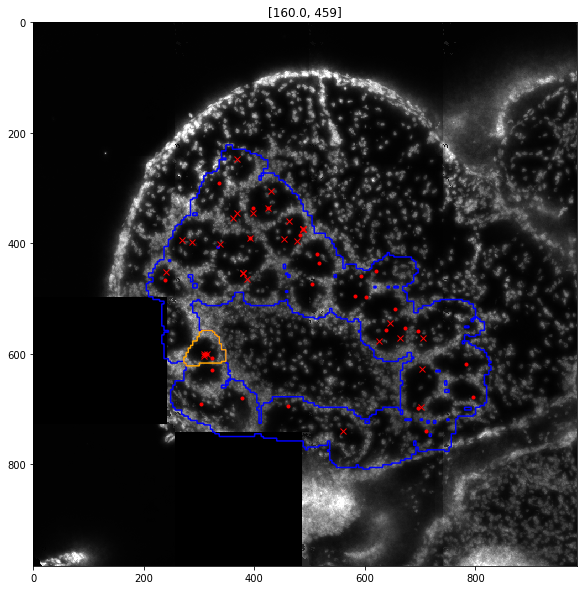

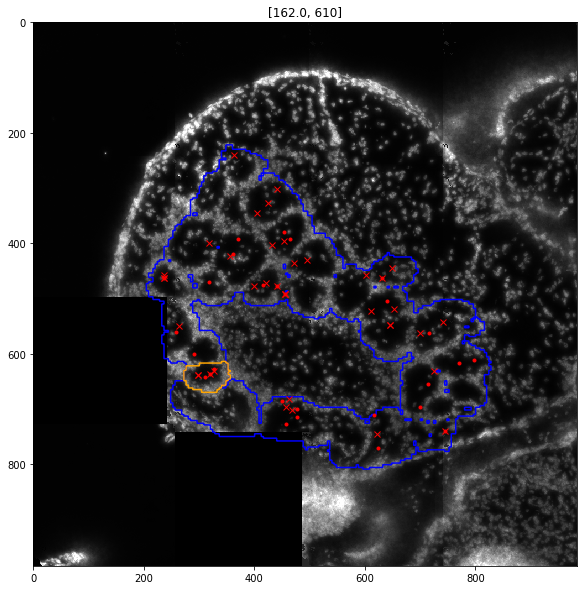

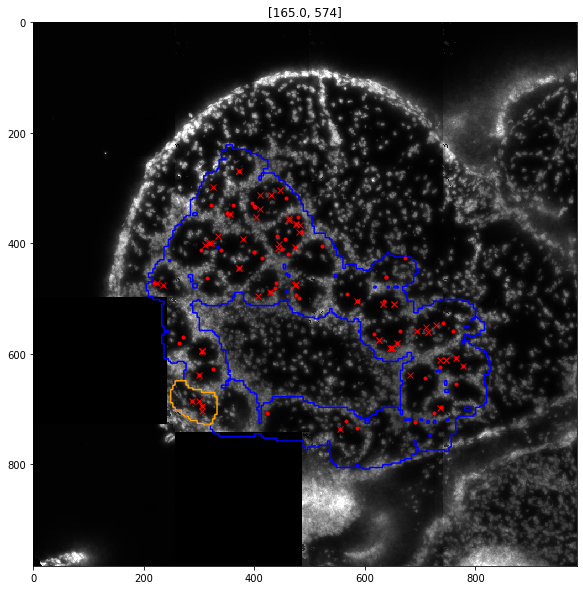

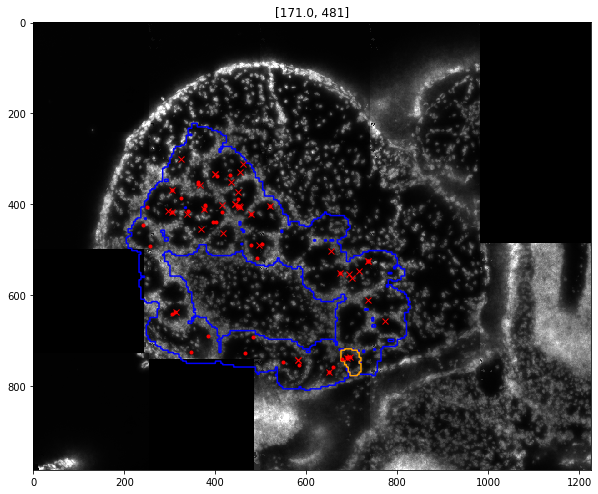

In [180]:
#icode = 58  
OB_ = 65.0
for OB_ in OB_dic_final:
    icode = int(OB_dic_final[OB_][0])#########################################
    #analysis_folder,OB_ifovs = dec_obj.analysis_folder,#dic_analysis_folder[OB_]
    analysis_folder= dec_obj.analysis_folder
    import tifffile
    imglom = tifffile.imread(dec_obj.analysis_folder+os.sep+'glom3d.tif')
    OB_ifovs = np.where([np.any(im_==OB_) for im_ in imglom])[0]
    hfolders,fovs,htags = np.load(analysis_folder+os.sep+'files.npy',allow_pickle=True)
    fovs
    infos = np.array([ln[:-1].split('\t') for ln in open(analysis_folder+os.sep+'dapi_resc8.infos','r')])
    resc_mos = int(infos[0][-1])
    fovs_mos = [os.path.basename(dax) for dax in infos[:,0]]
    limits_mos = infos[:,1:5].astype(int)
    cms_mos = np.array([np.mean(limits_mos[:,:2],axis=-1),np.mean(limits_mos[:,2:],axis=-1)]).T
    ifos_mos = [fovs_mos.index(fov) for fov in fovs[OB_ifovs]]

    #expand with n(=9) neighbors
    from scipy.spatial.distance import cdist
    ifovs_mos_extended = np.unique(np.argsort(cdist(cms_mos[ifos_mos],cms_mos),axis=-1)[:,:9])###9
    limits_mos_extended = limits_mos[ifovs_mos_extended]

    xmmos,xMmos,ymmos,yMmos=[np.min(limits_mos_extended[:,0]),np.max(limits_mos_extended[:,1]),
                            np.min(limits_mos_extended[:,2]),np.max(limits_mos_extended[:,3])]
    #reextend to rectangle
    pad = 100
    keep  =(limits_mos[:,0]>=xmmos-pad)&(limits_mos[:,1]<=xMmos+pad)&(limits_mos[:,2]>=ymmos-pad)&(limits_mos[:,3]<=yMmos+pad)
    ifovs_mos_extended = np.where(keep)[0]
    limits_mos_extended = limits_mos[ifovs_mos_extended]
    xmmos,xMmos,ymmos,yMmos=[np.min(limits_mos_extended[:,0]),np.max(limits_mos_extended[:,1]),
                            np.min(limits_mos_extended[:,2]),np.max(limits_mos_extended[:,3])]

    im_dapi = tifffile.imread(analysis_folder+os.sep+'dapi_resc8.tif')
    #im_labf = tifffile.imread(analysis_folder+os.sep+'dapi_resc8--imlabf_new.tif')
    im_labf,limits = np.load(analysis_folder+os.sep+'dapi_resc8_glomLayer.tif.npy',allow_pickle=True)


    im_dapi = im_dapi[xmmos:xMmos,ymmos:yMmos]
    im_labf = im_labf[xmmos:xMmos,ymmos:yMmos]


    fovs_mos_extended = np.array(fovs_mos)[ifovs_mos_extended]
    fovs_list = list(fovs)
    ifovsF,limsF = zip(*[(fovs_list.index(fov_),lims_) for fov_,lims_ in zip(fovs_mos_extended,limits_mos_extended) if fov_ in fovs_list])
    #fovs[ifovsF]
    fovsF = fovs[list(ifovsF)]
    ifovsF




    Xs2d_all,Xs2d,Xs2d_e = [],[],[]
    for ifv,fov in enumerate(fovsF):
        Xf_fl = analysis_folder+os.sep+'Decoded'+os.sep+'final_fits__'+fov.replace('.dax','')+'_Xsf.npy'
        if os.path.exists(Xf_fl):
            Xsff = np.load(Xf_fl)
            res_org = np.load(Xf_fl.replace('_Xsf.npy','_res_org.npy'),allow_pickle=True)

            Xsff_ = np.array([Xsff[r_[0]] for r_ in res_org[-3][icode]])
            if len(Xsff_)>0: Xs2d.extend((Xsff_[:,[2,1,7]]*[1,-1,1]+[0,2048,0])/[resc_mos,resc_mos,1]+[limsF[ifv][2]-ymmos,limsF[ifv][0]-xmmos,0])
            Xsff_ = np.array([Xsff[r_[0]] for r_ in res_org[-2][icode] if len(r_)<=6])
            if len(Xsff_)>0: Xs2d_e.extend((Xsff_[:,[2,1,7]]*[1,-1,1]+[0,2048,0])/[resc_mos,resc_mos,1]+[limsF[ifv][2]-ymmos,limsF[ifv][0]-xmmos,0])
            if len(Xsff)>0: Xs2d_all.extend((Xsff[:,[2,1,7]]*[1,-1,1]+[0,2048,0])/[resc_mos,resc_mos,1]+[limsF[ifv][2]-ymmos,limsF[ifv][0]-xmmos,0])#/resc_mos+[limsF[ifv][0]-xmmos,limsF[ifv][2]-ymmos][::-1])
    Xs2d = np.array(Xs2d)
    Xs2d_all = np.array(Xs2d_all)
    Xs2d_e = np.array(Xs2d_e)
    """
    plt.figure()
    plt.imshow(im_dapi,cmap='gray')
    plt.contour(im_labf>0,[0.5],colors='b')
    plt.contour(im_labf==OB_,[0.5],colors='r')
    #plt.plot(Xs2d_all[::30,0],Xs2d_all[::30,1],'y.',alpha=0.0075)
    plt.plot(Xs2d_e[:,0],Xs2d_e[:,1],'yx')
    plt.plot(Xs2d[:,0],Xs2d[:,1],'y.')
    """
    th_dapi = 1.35
    plt.figure(figsize=(10,10))
    plt.title(str([OB_,icode]))
    plt.imshow(im_dapi,cmap='gray',vmax=np.percentile(im_dapi[im_dapi!=0],99.9))
    plt.contour(im_labf>0,[0.5],colors='b')
    plt.contour(im_labf==OB_,[0.5],colors='orange')
    #plt.plot(Xs2d_all[::30,0],Xs2d_all[::30,1],'y.',alpha=0.0075)
    keep = Xs2d[:,-1]<th_dapi
    plt.plot(Xs2d[keep,0],Xs2d[keep,1],'r.')
    if OB_dic_final[OB_][-2]!=1:
        keep = Xs2d_e[:,-1]<th_dapi
        plt.plot(Xs2d_e[keep,0],Xs2d_e[keep,1],'rx')


In [165]:
OB_dic_final

{17.0: (554.0, 13.78943942523946, 5.0, 2),
 29.0: (445.0, 12.400871707169639, 5.0, 2),
 34.0: (186.0, 12.635519862391732, 5.0, 2),
 37.0: (243.0, 18.65574995394195, 7.0, 2),
 39.0: (430.0, 15.209518451489783, 5.0, 1),
 40.0: (154.0, 20.00916140307031, 19.0, 2),
 56.0: (318.0, 13.64705665142685, 5.0, 2),
 58.0: (268.0, 15.523813309982609, 6.0, 2),
 64.0: (276.0, 18.652442279304406, 5.0, 2),
 65.0: (503.0, 19.83012431933332, 5.0, 2),
 77.0: (319.0, 15.382859921371663, 5.0, 2),
 83.0: (37.0, 12.92464244493473, 5.0, 2),
 86.0: (95.0, 20.236182671216184, 6.0, 2),
 92.0: (511.0, 21.188553873686345, 5.0, 2),
 95.0: (38.0, 15.854236245900184, 5.0, 2),
 98.0: (384.0, 23.134784222613067, 5.0, 2),
 104.0: (4.0, 27.02527241161591, 6.0, 2),
 113.0: (292.0, 20.122708310402558, 5.0, 2),
 120.0: (525.0, 14.585839640198186, 5.0, 2),
 123.0: (282.0, 19.94454405792665, 5.0, 2),
 133.0: (351.0, 13.702291077762673, 5.0, 2),
 134.0: (379.0, 13.61388584549598, 15.0, 2),
 137.0: (116.0, 18.160115332355975, 5.

In [ ]:
{20.0: (413.0, 10.407193639101287, 8.0, 2),
 37.0: (243.0, 18.65574995394195, 7.0, 2),
 39.0: (492.0, 12.116274614520131, 8.0, 2),
 40.0: (154.0, 20.00916140307031, 19.0, 2),
 58.0: (268.0, 15.523813309982609, 6.0, 2),
 86.0: (95.0, 20.236182671216184, 6.0, 2),
 93.0: (151.0, 11.235835816000048, 6.0, 2),
 98.0: (428.0, 11.45171819019347, 6.0, 2),
 104.0: (4.0, 27.02527241161591, 6.0, 2),
 117.0: (383.0, 10.81781257024166, 9.0, 2),
 129.0: (270.0, 10.127754212686899, 8.0, 2),
 134.0: (379.0, 13.61388584549598, 15.0, 2),
 137.0: (116.0, 17.978514179032416, 9.0, 2),
 143.0: (468.0, 15.918720526791857, 7.0, 2),
 144.0: (8.0, 10.84869538962942, 6.0, 2),
 145.0: (18.0, 13.535038486989356, 7.0, 2),
 146.0: (15.0, 10.815183696645216, 7.0, 2),
 147.0: (124.0, 11.158588351005546, 7.0, 2),
 155.0: (253.0, 12.2671729693625, 10.0, 2),
 158.0: (294.0, 10.050860371227175, 7.0, 2),
 160.0: (459.0, 13.390739674787719, 6.0, 2)}

In [363]:
OB_fov_dic[904]

[657]

In [101]:
#[dec_obj.code_dic[tuple(dec_obj.codes_valid[icd_])].split('_')[0] for icd_ in range(len(dec_obj.codes_valid))].index('Olfr640')

In [102]:
%matplotlib notebook

In [1]:
import numpy as np
import glob,os,sys
import cv2
from tqdm import tqdm_notebook as tqdm
from sklearn.cluster import KMeans
from imp import reload
import matplotlib.pylab as plt
import pickle
from scipy.spatial import cKDTree
import OB_MER_Analyser_py3 as oma
import tifffile
reload(oma)

<module 'OB_MER_Analyser_py3' from 'C:\\Users\\bogdan\\Dropbox\\code_Seurat\\OR_MERFISH_2020\\OB_MER_Analyser_py3.py'>

In [28]:
master_folder = r'\\dolly\Raw_data_4\Bogdan\11_30_2020__OR-MER_lib6,7,8,9,10,11____CD1mom3_toB6pups_3col_40xStorm65_OB20'
dec_obj = oma.decoded_fov(master_folder,analysis_folder=r'F:\Bogdan')
dec_obj.get_files(htag=r'\H*R*')
dec_obj.psf_file = r'F:\Bogdan\PSF_Chromatic\psfs_pix256_sz3_STORM65-40X.npy'
dec_obj.chrom_file = r'F:/Bogdan/PSF_Chromatic/STORM65_dic_chr.pkl'
#ifov = 30
dec_obj.get_code(fl=r'SI8_final.fasta')

for ifov in [657]:#tqdm(np.arange(len(dec_obj.fovs))[:]):#[59, 79, 90, 108, 155, 157, 166, 170, 201, 202, 203, 204, 205, 206, 245, 275, 282, 301, 313, 314, 315, 316, 317, 318, 319, 320, 321, 327, 335, 336, 341, 342, 343, 344, 371, 388, 406, 409, 470]):#
    dec_obj.fov_index=ifov
    dec_obj.fov = dec_obj.fovs[ifov]
    dec_obj.get_im_OB()
    if np.any(dec_obj.im_OB>0):
        test_fl = dec_obj.analysis_folder+os.sep+'Decoded'+os.sep+'final_fits__'+dec_obj.fov.replace('.dax','')+'_AOBf.npy'
        if True:#not os.path.exists(test_fl):
            dec_obj.get_flatfield(force=False,cols = ['561','647','750','405'],ref=1)
            #get images
            dec_obj.get_mapped_ims(ifov,cols = ['561','647','750','405'])

            fits_folder = dec_obj.analysis_folder+os.sep+'Fits'
            dec_obj.final_fits_file = fits_folder+os.sep+'final_fits__'+dec_obj.fov.replace('.dax','')+'.pkl'
            if not os.path.exists(dec_obj.final_fits_file):
                #get drift
                dec_obj.get_drift_3d(ref=1,sz_big = 21,sz_small=5,size=128,delta_fit=11,th_h=1.5,th_dist=2)
                dec_obj.get_drift_2d(nsq=4, snorm=40)
                #get fit
            dec_obj.fitall(th_fit=4,th_cor=0.35,maxfev=10,better_fit=False,overwrite=False)
            dec_obj.get_final_zxyhs(sort=True,overwrite=False)
            if True:
                dec_obj.get_Xsf()
                dec_obj.refine_OB_mask(th_dapi = 1.35,iref = 1,rescs=[2,8,8],radius=15,plt_val=False);

                dec_obj.get_intersections(cor_th=0.45,dinstance_th = 3,nRs=18)
                dec_obj.set_X_vals(dec_obj.Xsff)
                dec_obj.clean_intersections(nRs=15)
                dec_obj.organize_inters()
                dec_obj.save_intersections()



In [30]:
OB_,icd = 904,586 

array([ 0, 10, 12, 14])

In [47]:
dec_obj.get_intersections(cor_th=0.45,dinstance_th = 3,nRs=18)
dec_obj.set_X_vals(dec_obj.Xsff)
dec_obj.clean_intersections(nRs=15)
dec_obj.organize_inters()
dec_obj.save_intersections()

In [56]:
esf = [es for es in dec_obj.res_org[-2][icd] if dec_obj.XOB[es[0]]==OB_ and dec_obj.Xdapi[es[0]]<1.35]
esf

[array([  16199,  532571,  798927,  969369, 1125012]),
 array([   2090,  518979,  781119,  950952, 1108606])]

In [6]:
iim=4

im_ = np.array(dec_obj.ims[iim])
im_nm = dec_obj.ims_names[iim]
col = im_nm.split('_')[-1]
icol = dec_obj.cols.index(col)
im_n=im_/dec_obj.ims_mean[icol]
pts = dec_obj.zxyhs[iim]
x,y = pts[:,1],pts[:,2]
#fig = plt.figure()
#plt.imshow(np.max(im_n,0),vmax=5)
#plt.plot(y,x,'rx')

In [4]:
%matplotlib notebook

<IPython.core.display.Javascript object>


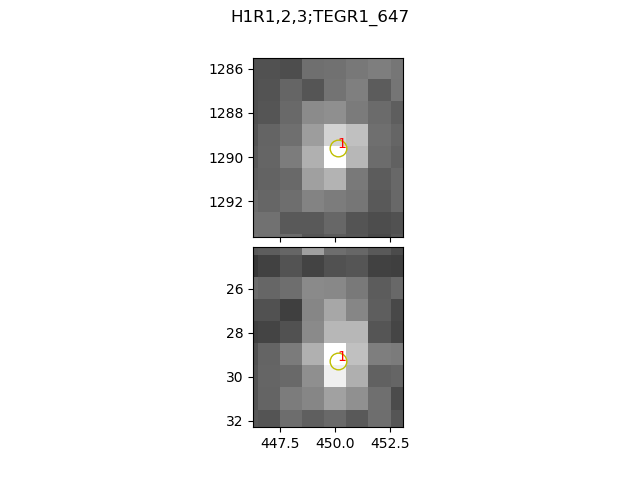

In [7]:
import MaxViewer_py3 as mv
obj = mv.imshow_mark_3d([im_n],image_names=[im_nm])

In [25]:
obj.draw_x,obj.draw_y,obj.draw_z = pts[(pts[:,-1]>0.45),:3][:,::-1].T
obj.class_ids=[0]*len(obj.draw_x)
obj.update_point_plot()

In [15]:
obj.draw_x,obj.draw_y,obj.draw_z,obj.class_ids = [],[],[],[]
obj.update_point_plot()

In [396]:
pts[:,-1]

array([0.48802468, 0.4565428 , 0.37585282, ..., 0.4340587 , 0.4704414 ,
       0.37141487], dtype=float32)

In [404]:
??obj

In [306]:
OB_ = 457   
OB_fov_dic[OB_],int(OB_dic_final.get(OB_,[-1])[0])

([264, 265], 119)

In [309]:
iob = list(OBs_all).index(OB_)
top_th_score_4[iob],top_th_score_4_extended[iob],OB_

(array([  2.72711104, 409.        ,   5.        ]),
 array([ 20.60562604, 119.        ,   4.        ]),
 457)

In [262]:
#olfr_nm.split('_')[0]+'_'+str(OB_t)

<IPython.core.display.Javascript object>


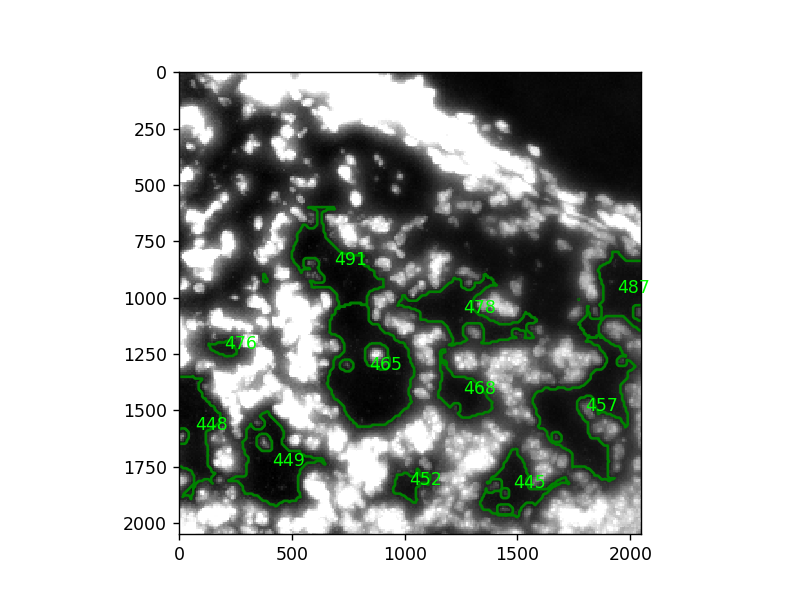

In [298]:
ifov=265
dec_obj.fov_index=ifov
dec_obj.fov = dec_obj.fovs[ifov]
dec_obj.get_im_OB()
dec_obj.get_flatfield(force=False,cols = ['561','647','750','405'],ref=1)
#get images
dec_obj.get_mapped_ims(ifov,cols = ['561','647','750','405'])
fits_folder = dec_obj.analysis_folder+os.sep+'Fits'
dec_obj.final_fits_file = fits_folder+os.sep+'final_fits__'+dec_obj.fov.replace('.dax','')+'.pkl'
dec_obj.get_Xsf()
dec_obj.refine_OB_mask(th_dapi = 1.35,iref = 1,rescs=[2,8,8],radius=15,plt_val=True);

dec_obj.get_intersections(cor_th=0.45,dinstance_th = 2,nRs=18)
dec_obj.set_X_vals(dec_obj.Xsff)
dec_obj.clean_intersections(nRs=15)
dec_obj.organize_inters()
#dec_obj.save_intersections()

In [323]:
OB_ = 449
OB_dic_final[OB_]


(429.0, 29.777721892682397, 7.0, 2)

<IPython.core.display.Javascript object>


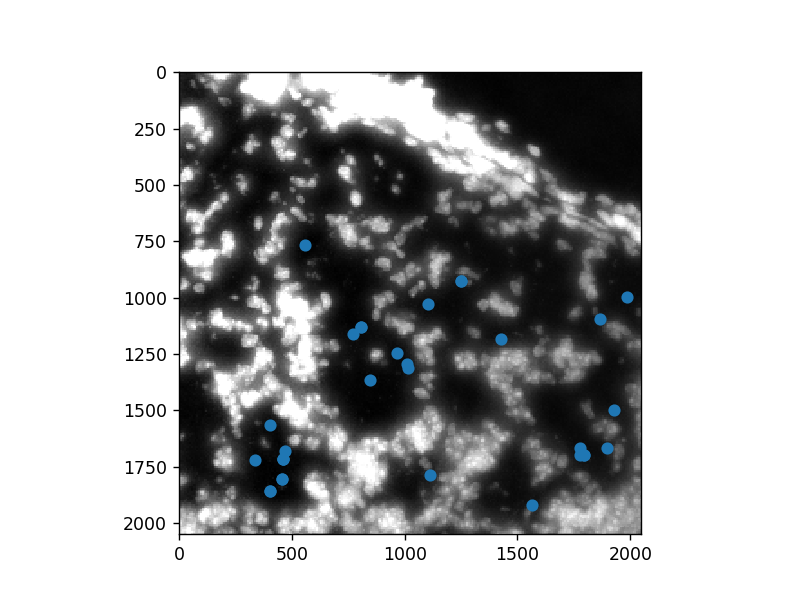

In [325]:
icd = int(OB_dic_final[OB_][0])
X_pts = []
for iels in dec_obj.res_org[-3][icd]+dec_obj.res_org[-2][icd]:
    if dec_obj.Xdapi[iels[0]]<1.35 and len(iels)<7:#1.6:
        X_pts.append(dec_obj.Xsff[iels[0]][1:3])
X_pts = np.array(X_pts)

plt.figure()
plt.imshow(dec_obj.im_norm_dapi,cmap='gray',vmax=5)
plt.plot(X_pts[:,1],X_pts[:,0],'o')

In [408]:
len(top_th_score_4)-np.sum(np.array(top_th_score_4)==0)

1194

In [377]:
np.sum(np.max([top_th_score_4,top_th_score_4_extended],0)>10)

574

In [378]:
len(top_th_score_4)

1539

In [374]:
top_th_score_4 = np.array(top_th_score_4)
np.sum(top_th_score_4>10)

321

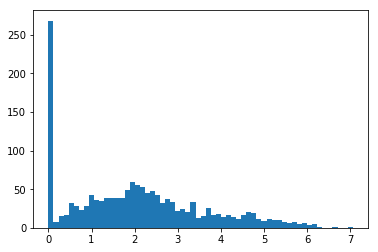

In [395]:
plt.figure()
plt.hist(np.log(np.array(np.max([top_th_score_4,top_th_score_4_extended],0))+1),bins=60);

In [386]:
top_th_score = np.array(top_th_score)

In [367]:
np.sum(top_th_score>10)

321

In [343]:
A_dec.keys()

dict_keys([0, 765, 797, 737, 751, 721, 722, 725, 727, 729, 728, 742, 743, 749, 757, 758, 771, 763, 762, 769, 773, 779, 782, 724, 732, 733, 736, 748, 761, 766, 746, 754, 755, 756, 778, 772, 775, 785, 788, 660, 663, 665, 675, 678, 657, 662, 624, 637, 640, 643, 653, 644, 646, 650, 661, 667, 593, 602, 622, 544, 545, 549, 550, 557, 561, 563, 564, 571, 574, 578, 584, 588, 592, 595, 600, 617, 623, 539, 520, 524, 530, 531, 535, 537, 540, 543, 505, 498, 490, 492, 494, 488, 489, 491, 493, 497, 499, 500, 487, 495, 496, 504, 501, 506, 507, 502, 503, 510, 511, 512, 515, 517, 518, 522, 523, 526, 508, 519, 525, 509, 513, 516, 666, 670, 682, 685, 674, 679, 681, 686, 688, 693, 696, 700, 701, 703, 705, 711, 713, 718, 720, 706, 709, 710, 712, 730, 740, 741, 780, 790, 791, 792, 795, 809, 794, 796, 804, 798, 805, 807, 811, 687, 694, 702, 800, 801, 810, 815, 818, 777, 787, 789, 793, 781, 784, 802, 723, 726, 745, 750, 753, 774, 719, 738, 714, 680, 691, 699, 708, 656, 606, 616, 546, 548, 554, 556, 566, 573, 5

In [ ]:
score: [24.33  6.45  1.44  1.25  1.21] [ 61   0 384  51 172]
score: [59.48 49.57 35.69 11.82 11.29] [236 353  17  61   0]

In [ ]:
[4.52 2.91 2.79 2.54 1.89] [257 150  78 201 389]

In [183]:
codes = dec_obj.codes_valid
nth = 5


np.round(obs_exp[order_[:5]],2),order_[:5]

C:\Users\bogdan\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in true_divide
  


(array([22.98,  6.09,  1.36,  1.18,  1.14]),
 array([ 61,   0, 384,  51, 172], dtype=int64))

In [ ]:
(array([56.18377759, 46.81981466, 33.71026655, 11.16906422, 10.66451334]),
 array([236, 353,  17,  61,   0], dtype=int64))

In [174]:
ndec_OB[OB_]

array([  9.,   0.,   0.,   2.,   1.,   0.,   1.,   0.,   0.,   0.,   0.,
         0.,   0.,  22.,   0.,   0.,   0.,   1.,   1.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   1.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   1.,   0.,   0.,   0.,
         0.,   1.,   0.,   0.,   0.,   0.,   0.,  14.,   0.,   0.,   0.,
         3.,   0.,   0.,   0.,   0.,   5.,   9.,   0.,  97.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   3.,   0.,   1.,   0.,   0.,   0.,
         0.,   4.,   0.,   0.,   0.,   1.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   1.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   7.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   1.,   0.,   0.,   0.,
         0.,   1.,   1.,   0.,   1.,   1.,   0.,   

In [ ]:
OBs = np.sort(list(ndec_OB.keys()))

C:\Users\bogdan\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in true_divide
  """


array([46.81981466, 11.16906422, 10.66451334,  2.46420077,  1.54989731])

In [166]:
len(ndec_OB)

198

In [159]:
codes[np.argsort(obs_exp)[::-1]][:10]

array([[ 0,  1,  9, 10],
       [ 0,  6,  9, 11],
       [ 3,  6,  8,  9],
       [ 0,  6,  9, 10],
       [ 0,  6,  7, 10],
       [ 0,  6,  9, 13],
       [ 0,  5,  6,  7],
       [ 3,  5,  7, 11],
       [ 6,  7,  9, 13],
       [ 1,  2,  8, 11]])

array([236, 353,  17,  61,   0, 350, 191, 239, 178, 168, 204, 356, 417,
        55, 302, 371, 267, 375, 185,  45, 358, 117, 240, 150, 165,  60,
       337, 172,  78, 338,  51, 384, 139,  63, 283, 296,  13, 379, 169,
         7, 183, 166, 182, 181, 167, 180,   9, 175, 174, 170, 179, 171,
         8, 177, 176, 163, 173, 164, 159, 162, 147,  11, 137, 138,  10,
       140, 141, 142, 143, 144, 145, 146, 148, 161, 149, 151, 152, 153,
       154, 155, 156, 157, 158,   6, 160, 184, 188, 186, 187,   3, 216,
       217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229,
       230, 231, 232, 233, 234, 235,   2, 237, 238,   1, 215, 214, 213,
       199, 135, 189, 190,   5, 192, 193, 194, 195, 196, 197, 198, 200,
       212, 201, 202, 203,   4, 205, 206, 207, 208, 209, 210, 211, 136,
        22,  12,  81,  53,  54,  20,  56,  57,  58,  59,  19,  62,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        79,  18,  52,  50,  49,  35,  24,  25,  26,  27,  28,  2

In [ ]:
#OB_=5#136#141,142
codes = dec_obj.codes_valid
ndec_OB[-1] = np.sum([ndec_OB[OB_] for OB_ in ndec_OB if OB_>0],0)
Adec[-1] = np.sum([Adec[OB_] for OB_ in Adec if OB_>0])

OBs = np.sort(list(ndec_OB.keys())) #all obs
OBs = OBs[OBs>0]
scores = []
nRNAs = []
OB_codes = []
stats = []
for OB_ in OBs:
    observed = 1.*ndec_OB[OB_]/Adec[OB_]
    #expected = 1.*(ndec_OB[0]+ndec_OB[-1])/(Adec[0]+Adec[-1])
    #expected = 1.*(ndec_OB[-1])/(Adec[-1])
    expected = 1.*(ndec_OB[-1]-ndec_OB[OB_])/(Adec[-1]-Adec[OB_])
    obs_exp = observed/expected
    obs_exp[ndec_OB[OB_]<4]=0
    ibest_code = np.argsort(obs_exp)[::-1]
    
    nRNA = ndec_OB[OB_][ibest_code[0]]
    nRNA_tot = ndec_OB[-1][ibest_code[0]]
    scores.append(obs_exp[ibest_code[0]])
    OB_codes.append(codes[ibest_code[0]])
    nRNAs.append([nRNA,nRNA_tot])
    stats.append([OB_,np.round(obs_exp[ibest_code[0]],2),nRNA,nRNA_tot,OB_fov[OB_],ibest_code[0],codes[ibest_code[0]]])
    print(stats[-1])
    
    #print(list(zip(codes[ibest_code],obs_exp[ibest_code]))[:5])
scores = np.array(scores) 
stats = np.array(stats)

In [126]:
np.sum((self.XOB==554)&(self.Xoutcell))

23

In [139]:
ct_dic_b4[663][0]

41.0

In [95]:
dec_obj.Xoutcell

array([False, False, False, ...,  True,  True, False])

In [1724]:
len(self.res_org[2][61])

12

In [94]:
ct_dic[663][61]

5.0

<IPython.core.display.Javascript object>


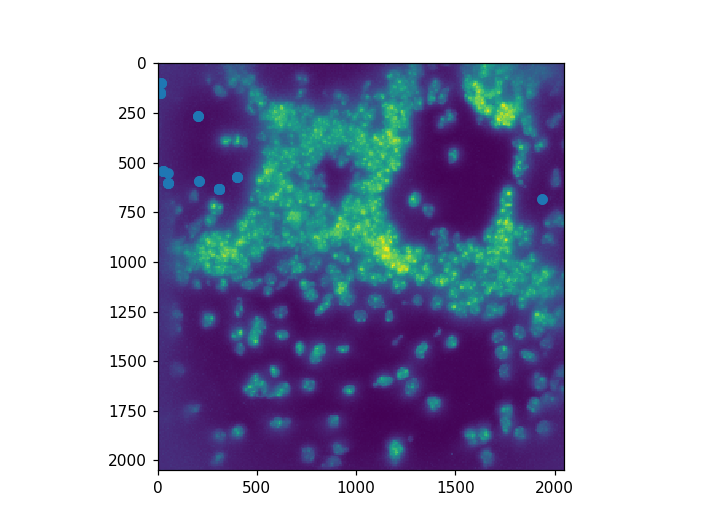

In [1776]:
icd=1
x_,y_ = np.array([self.Xsff[e[0]][1:3] for e in res_org[icd] if self.Xoutcell[e[0]]]).T
plt.figure()
plt.imshow(self.im_norm_dapi)
plt.plot(y_,x_,'o')

In [1761]:
ct_dic[663]

array([171., 103.,   4.,  43.,   0.,   0.,   4., 105.,   2.,   4.,   3.,
         0.,   0.,  84.,  50.,   0.,   0., 132.,   6.,   1.,   0.,   1.,
         0.,   6.,   3.,   4.,   0.,   0.,   0.,   0.,   0.,  10.,   0.,
         0.,   5.,  15.,   3.,  41.,   1.,  20.,  14.,   2.,   4.,   4.,
         0.,  60.,   0.,   4.,   1.,   0.,   2., 253.,   0.,   6.,   1.,
       106.,   1.,   0.,   1.,   2.,  88., 138.,   0., 904.,   0.,   0.,
         0.,   0.,   0.,   1.,   0.,   7.,   0.,   0.,   0.,   0.,   0.,
         0., 156.,   1.,   0.,   0.,  14.,  13.,   0.,   0.,   2.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   4.,   0.,   0.,   5.,
         0.,   0.,  33.,   0.,   0.,   0.,  28.,   6.,   0.,   0.,   0.,
         8.,   2.,   0.,   2.,   4.,   0.,   0., 103.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   7.,   1.,   0.,   1.,   5.,  21.,
         1.,  35.,   1.,   0.,   1.,  13.,   0.,  55.,   0.,   9.,   7.,
         6.,   0.,   5.,   0.,   0.,   8.,   0.,  4

In [1750]:
list(zip(ct_dic[663],np.sum([ct_dic[ob_] for ob_ in obs_u],0)))[61]#/np.sum([ct_dic[ob_] for ob_ in obs_u],0)

(13.0, 20.0)

In [1709]:
self.codes_valid[0],self.codes_valid[1],self.codes_valid[7]

(array([ 0,  6,  7, 10]), array([ 6,  7,  9, 11]), array([4, 6, 8, 9]))

In [1683]:
codes[1]

array([ 6,  7,  9, 11])

In [1690]:
[np.array((self.XRs[e],self.Xhnorm[e])) for e in res_org[1] if self.Xoutcell[e[0]]]

[array([[ 3.        ,  5.        ,  6.        ,  7.        ,  8.        ,
          9.        , 10.        , 11.        , 13.        , 14.        ],
        [ 7.60852861, 13.49038506,  9.64964771,  8.60815239,  5.7641592 ,
          8.37768078,  5.63516092, 12.02974606,  8.98388672,  9.09190178]]),
 array([[ 3.        ,  5.        ,  6.        ,  7.        ,  8.        ,
          9.        , 10.        , 11.        , 13.        , 14.        ],
        [ 7.60852861, 13.49038506,  9.64964771,  8.60815239,  5.7641592 ,
          8.37768078,  5.63516092, 12.02974606,  8.98388672,  9.09190178]]),
 array([[ 3.        ,  5.        ,  6.        ,  7.        ,  8.        ,
          9.        , 10.        , 11.        , 13.        , 14.        ],
        [ 7.60852861, 13.49038506,  9.64964771,  8.60815239,  5.7641592 ,
          8.37768078,  5.63516092, 12.02974606,  8.98388672,  9.09190178]]),
 array([[ 3.        ,  5.        ,  6.        ,  7.        ,  8.        ,
          9.        , 10. 

In [1628]:
for cd in codes[icds]:
    

array([[ 1,  5,  6, 13],
       [ 1,  5,  6, 10],
       [ 1,  6, 10, 13]])

In [1649]:

R_ =R_s
r_=r__
scores= []
for cd in codes[icds]:
    X_ = self.Xsff[r_][np.in1d(R_,cd)]
    #metric is distance from center
    x_ = X_[:,:3]
    #score = np.mean(np.abs(np.mean(x_,0)-x_))
    score = np.mean(pdist(x_))
    scores.append(score)
    icds[np.argmin(scores)]

In [1650]:
scores

[1.689039311985229, 1.775540156100974, 1.6551633810140556]

In [1623]:
for cd in codes[icds]:
    np.in1d()

array([[1, 2, 4, 8]])

In [1605]:
np.all(np.in1d(codes,r_).reshape(codes.shape),1)

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,

In [1603]:
np.sum(cds)

0

In [1591]:
?np.in1d

In [1584]:
organize_inters(self)

In [1580]:
np.unique(self.XOB[np.array(res_org[61])[:,0]],return_counts=True)

(array([663, 667, 678]), array([6, 3, 3], dtype=int64))

In [1543]:
r3_to_cd={}
for cd in dec_obj.codes_valid:
    for c1 in cd:
        for c2 in cd:
            for c3 in cd:
                for c4 in cd:
                    if (c1!=c2) and (c2!=c3) and (c1!=c3) and (c4!=c3) and (c4!=c2) and  (c1!=c4):
                        r3_to_cd[(c1,c2,c3,c4)]=r3_to_cd.get((c1,c2,c3,c4),[])+[tuple(cd)]
r3 = [r_ for r_ in rints if len(r_)==4]
R3 = [tuple(Rs[r_]) for r_ in r3]

OB3 = [dec_obj.get_OB(np.mean(dec_obj.Xsf[r3_][:,1:3],0)) for r3_ in r3 ]
cd_cts3 = {OB_:{}for OB_ in np.unique(OB3)}
for r_,R_,OB_ in tqdm(zip(r3,R3,OB3)):
    key = r3_to_cd.get(R_)
    if key is not None:
        for cd in key:
            cd_cts3[OB_][cd]=cd_cts3[OB_].get(cd,[])+[r_]

array([[ 0,  6,  7, 10],
       [ 6,  7,  9, 11],
       [ 0,  6,  8,  9],
       ...,
       [ 2,  6,  9, 13],
       [ 2,  9, 11, 13],
       [ 1,  8,  9, 11]])

In [1533]:
obs,cts_ob = np.unique(dec_obj.XOB[dec_obj.Xoutcell],return_counts=True)
cts_ob

array([241780,  12098,  82093,  62795,    370,   5779,   2042,  18887],
      dtype=int64)

In [1534]:
cts_ob/np.median(cts_ob)

array([15.60626109,  0.78089398,  5.29888656,  4.05325157,  0.02388252,
        0.3730192 ,  0.13180571,  1.21910602])

<IPython.core.display.Javascript object>


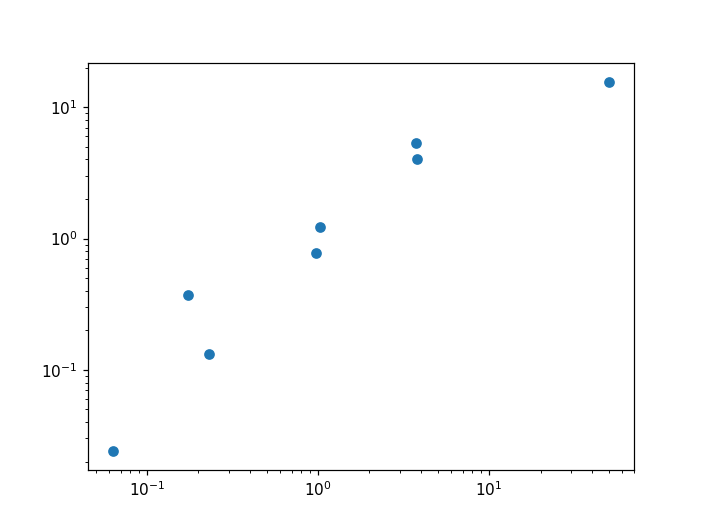

In [1539]:
As_ob = [np.sum(dec_obj.im_mask_OB==OB_) for OB_ in obs]
plt.figure()
plt.loglog(As_ob/np.median(As_ob),cts_ob/np.median(cts_ob),'o')

<IPython.core.display.Javascript object>


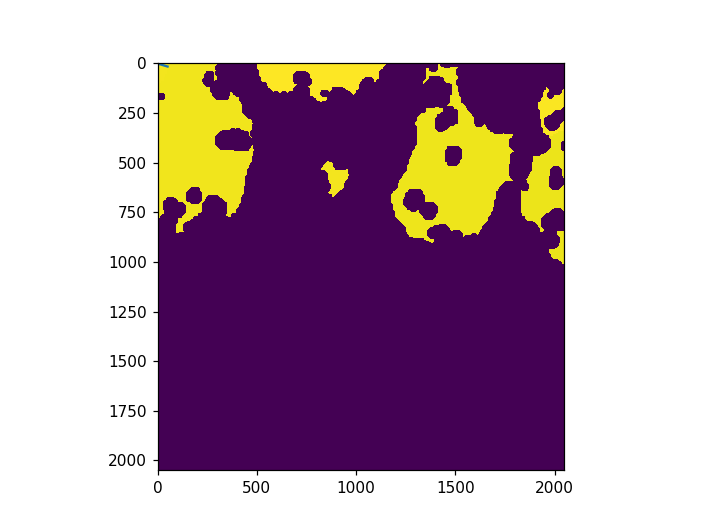

In [1531]:
plt.figure()
plt.imshow(dec_obj.im_mask_OB)


In [1517]:
clean_intersections(dec_obj,nRs=15)

<IPython.core.display.Javascript object>


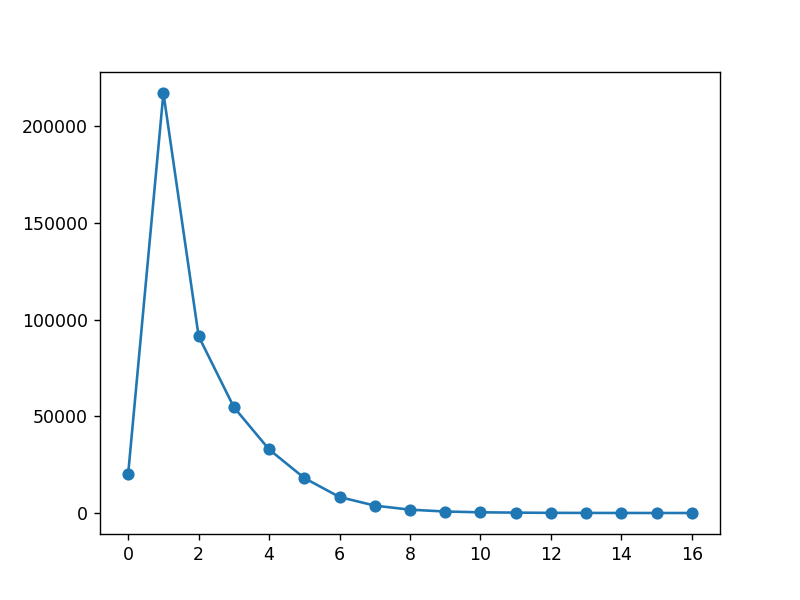

In [1521]:
x_,y_=np.unique([len(r_) for r_ in dec_obj.resk],return_counts=True)
plt.figure()
plt.plot(x_,y_,'o-')

In [1515]:
dec_obj.resk

[array([1000004]),
 array([1000005]),
 array([100000]),
 array([1000010]),
 array([1000011]),
 array([1000014]),
 array([100001]),
 array([1000020]),
 array([1000025]),
 array([1000027, 1177651]),
 array([100002]),
 array([1000035]),
 array([100003]),
 array([100004, 205166, 405874, 502058, 745403]),
 array([100004, 405874, 502058, 745403]),
 array([1000041]),
 array([1000044, 1251750]),
 array([1000049]),
 array([ 100005, 1002947]),
 array([ 100005,  908293, 1002947, 1249805]),
 array([1000056]),
 array([ 100006, 1109546]),
 array([ 100006,  578770, 1109546, 1251431]),
 array([1000078]),
 array([100007]),
 array([1000089]),
 array([100008]),
 array([ 100009,  999681, 1249815, 1335575]),
 array([1000090]),
 array([1000101]),
 array([1000106]),
 array([100010]),
 array([ 100011,  500262, 1335577]),
 array([ 100011,  500262,  808349, 1335577, 1425513]),
 array([1000113]),
 array([100012]),
 array([ 100013,  296919,  917112, 1004553, 1181714]),
 array([100013, 296919]),
 array([100015]),


In [1506]:
dec_obj.XRs[dec_obj.res[4390]]

array([ 1,  6, 14, 16])

In [1496]:
i_ = [r_ for r_ in dec_obj.res if len(r_)==7][30]
dec_obj.Xsff[i_][:,0:3]

array([[  6.17816305, 621.58300781, 801.57220459],
       [  4.76221752, 621.55749512, 800.91314697],
       [  5.24189425, 621.76818848, 801.7298584 ],
       [  5.61237669, 621.34417725, 801.28222656],
       [  6.79488754, 620.71612549, 802.96429443],
       [  6.35787201, 621.52142334, 803.06756592],
       [  5.45635509, 621.70343018, 801.82843018]])

In [1047]:
rints = np.array([np.array(eval(e)) for e in np.unique([str(list(np.sort(r))) for r in dec_obj.res])])
Rs = dec_obj.Xsf[:,-1].astype(int)
#rints = [r_ for r_ in rints if not np.any(Rs[r_]>=15)]

In [1472]:
self.Xsfk

AttributeError: 'decoded_fov' object has no attribute 'Xsfk'

In [1013]:
#rints = [str(list(Rs[r_])) for r_ in rints if len(r_)==4 if np.all(Rs[r_]<16)]

In [1070]:
nRs=15
r_clean = []
for r_ in rints:
    R_ = Rs[r_]
    remove=False
    if np.any(R_>nRs):
        h_ = dec_obj.Xsf[r_,4]
        remove = R_[np.argmax(h_)]>=nRs
    if not remove:
        r_clean.append(r_)
rints=r_clean

In [993]:
dec_obj.analysis_folder

'F:\\Bogdan\\11_30_2020__OR-MER_lib1,2,3,4,5____CD1mom3_toB6pups_3col_40xStorm3_OB18_OB-AnalysisOB'

In [992]:
len(rints),792804

(858594, 792804)

In [1072]:
dec_obj.Xsf[:,-1]

array([ 0.,  0.,  0., ..., 17., 17., 17.])

In [905]:
R_to_col={1:'750',2:'647',3:'561',4:'750',6:'647',5:'561',7:'750',8:'647',9:'561',10:'750',12:'647',11:'561',14:'750',15:'647',13:'561',16:'647',17:'561',18:'750'}
[R_to_col[iR+1]for iR in np.array([2, 4, 8, 10, 12])]

['561', '561', '561', '561', '561']

In [1078]:
[Rs[r_] for r_ in rints if len(r_)==2]

[array([ 0, 10]),
 array([ 1, 15]),
 array([1, 3]),
 array([14, 15]),
 array([ 1, 14]),
 array([1, 8]),
 array([14, 16]),
 array([14, 15]),
 array([1, 8]),
 array([14, 15]),
 array([0, 9]),
 array([ 1, 11]),
 array([14, 15]),
 array([14, 15]),
 array([1, 4]),
 array([14, 15]),
 array([ 1, 15]),
 array([14, 15]),
 array([1, 6]),
 array([1, 3]),
 array([1, 8]),
 array([14, 15]),
 array([14, 15]),
 array([ 1, 15]),
 array([14, 15]),
 array([1, 7]),
 array([14, 15]),
 array([14, 15]),
 array([ 0, 10]),
 array([14, 15]),
 array([1, 2]),
 array([14, 15]),
 array([14, 15]),
 array([1, 4]),
 array([14, 15]),
 array([0, 2]),
 array([ 1, 14]),
 array([1, 2]),
 array([14, 15]),
 array([14, 15]),
 array([14, 15]),
 array([ 1, 10]),
 array([14, 15]),
 array([ 0, 14]),
 array([14, 15]),
 array([14, 15]),
 array([1, 5]),
 array([14, 15]),
 array([14, 15]),
 array([1, 3]),
 array([14, 15]),
 array([1, 3]),
 array([ 1, 15]),
 array([14, 15]),
 array([1, 3]),
 array([14, 15]),
 array([ 1, 12]),
 array([

In [1077]:
dec_obj

<bound method decoded_fov.im_OBmask of <OB_MER_Analyser_py3.decoded_fov object at 0x0000019709D388D0>>

In [1080]:
dec_obj.codes_valid[0]
np.in1d(Rs[r_],cd)

NameError: name 'cd' is not defined

In [1281]:
r2_to_cd={}
for cd in dec_obj.codes_valid:
    for c1 in cd:
        for c2 in cd:
            if c1!=c2:
                r2_to_cd[(c1,c2)]=r2_to_cd.get((c1,c2),[])+[tuple(cd)]
r2 = [r_ for r_ in rints if len(r_)==2]
R2 = [tuple(Rs[r_]) for r_ in r2]
OB2 = [dec_obj.get_OB(np.mean(dec_obj.Xsf[r2_][:,1:3],0)) for r2_ in r2 ]
cd_cts2 = {OB_:{}for OB_ in np.unique(OB2)}
for r_,R_,OB_ in tqdm(zip(r2,R2,OB2)):
    key = r2_to_cd.get(R_)
    if key is not None:
        for cd in key:
            cd_cts2[OB_][cd]=cd_cts2[OB_].get(cd,0)+1

In [1361]:
import itertools
list(itertools.combinations(self.codes_valid[61],4))

[(0, 6, 9, 10)]

In [1368]:
self.im_mask_OB,self.im_dapi_th,self.im_norm_dapi.shape

(array([[665, 665, 665, ...,   0,   0,   0],
        [665, 665, 665, ...,   0,   0,   0],
        [665, 665, 665, ...,   0,   0,   0],
        ...,
        [  0,   0,   0, ...,   0,   0,   0],
        [  0,   0,   0, ...,   0,   0,   0],
        [  0,   0,   0, ...,   0,   0,   0]], dtype=int32),
 array([[0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=uint8),
 (2048, 2048))

In [1394]:
self=dec_obj
X,Y = self.Xsf[:,1:3].astype(int).T


In [1426]:
OB_ = Xsf[:,9]
nocell_ = Xsf[:,8]
dapi_sig = Xsf[:,7]
Xsf[OB_==663].shape

(162277, 10)

In [1454]:
np.sum(OB_>0)

648481

In [1441]:
np.median(dapi_sig[nocell_==0])

2.768420934677124

In [1445]:
med_dapi = np.median(dapi_sig[nocell_==0])
med_nodapi = np.median(dapi_sig[nocell_==1])
med_dapi,med_nodapi
np.std(dapi_sig[nocell_==0]),np.std(dapi_sig[nocell_==1])
(med_dapi+med_nodapi)/2

1.6866716146469116

<IPython.core.display.Javascript object>


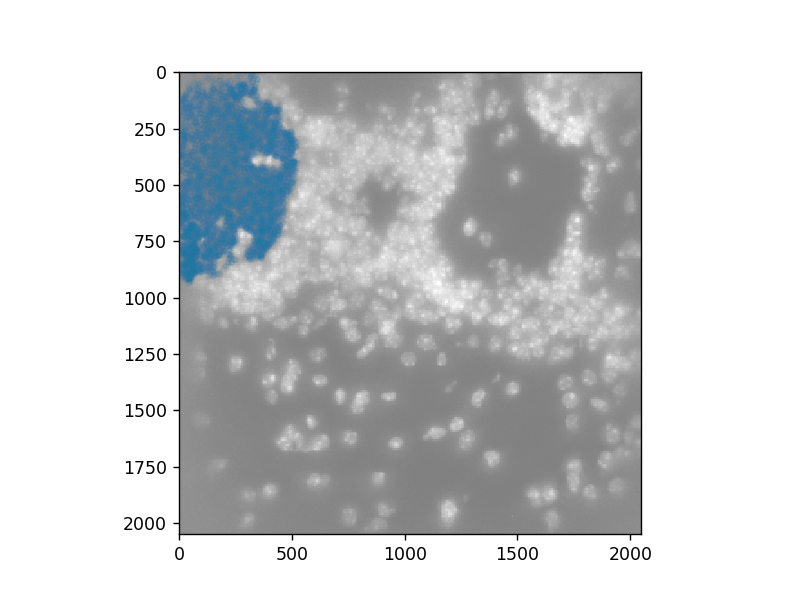

In [1451]:
plt.figure()
plt.imshow(self.im_norm_dapi,cmap='gray',alpha=0.5)
#plt.imshow(self.im_mask_OB,alpha=0.5)
#plt.imshow(1-self.im_dapi_th,alpha=0.15,cmap='inferno')
#plt.imshow(self.im_OB,alpha=0.15,cmap='inferno')
x_,y_ = Xsf[(OB_==663)&(dapi_sig<1.7)][::10,1:3].T
plt.plot(y_,x_,'.',alpha=0.05)

In [1338]:
r3_to_cd={}
for cd in dec_obj.codes_valid:
    for c1 in cd:
        for c2 in cd:
            for c3 in cd:
                if (c1!=c2) and (c2!=c3) and (c1!=c3):
                    r3_to_cd[(c1,c2,c3)]=r3_to_cd.get((c1,c2,c3),[])+[tuple(cd)]
r3 = [r_ for r_ in rints if len(r_)==3]
R3 = [tuple(Rs[r_]) for r_ in r3]

OB3 = [dec_obj.get_OB(np.mean(dec_obj.Xsf[r3_][:,1:3],0)) for r3_ in r3 ]
cd_cts3 = {OB_:{}for OB_ in np.unique(OB3)}
for r_,R_,OB_ in tqdm(zip(r3,R3,OB3)):
    key = r3_to_cd.get(R_)
    if key is not None:
        for cd in key:
            #cd_cts3[OB_][cd]=cd_cts3[OB_].get(cd,0)+1
            cd_cts3[OB_][cd]=cd_cts3[OB_].get(cd,[])+[r_]

In [1342]:
np.math.factorial(6)

720

In [1351]:

XY

array([[ 453,  217],
       [ 510, 1103],
       [ 525,  680],
       ...,
       [ 898, 1623],
       [1244,  539],
       [1297,  217]])

In [ ]:
def set_X_vals(self,Xsf):
    self.Xsfk = Xsf
    self.XOB = Xsf[:,9].astype(int)
    self.Xoutcell = Xsf[:,8].astype(bool)
    self.Xdapi = Xsf[:,7]
    self.XRs = Xsf[:,6].astype(int)
    self.Xcor = Xsf[:,5]
def get_intersections(self,cor_th=0.45,dinstance_th = 1.5,nRs=15):
    """
    Given that .get_code is used, this goes through zxyhsf and looks for perfect intersections.
    It screens for cor_th first and then  for distance_th.
    """
    Xsf = self.Xsff.copy()
    self.set_X_vals(Xsf)
    #cutoff brightness/correlation and inside OB
    keep = (self.XOB>0)&(self.Xcor>cor_th)
    Xsf = self.Xsf[keep]
    self.set_X_vals(Xsf)
    Rs = self.XRs
    # Find all intersections
    Xs = self.Xsfk[:,:3]
    Ts = cKDTree(Xs)
    res = Ts.query_ball_tree(Ts,dinstance_th)
    self.res=res
    
    #lens_= [len(pts) for pts in points_all_codes]
    #points_all_codes_ = np.array(points_all_codes)[np.argsort(lens_)[::-1]]

In [ ]:
#get perfect matches
    rints = np.array([r for r in res if len(r)==4])
    rints = np.array([np.array(eval(e)) for e in np.unique([str(list(np.sort(r))) for r in rints])]) # make unique
    rints_txt = np.array([str(Rs[r]) for r in rints])
    codes_txt = np.array([str(cd) for cd in np.array(self.codes_valid)])
    keeps = np.array([rints_txt==cd for cd in codes_txt])
    points_all_codes = [[Xsf[r] for r in rints[keep]] for keep in keeps]
    self.points_all_codes = points_all_codes

In [1313]:
r3_to_cd={}
for cd in dec_obj.codes_valid:
    for c1 in cd:
        for c2 in cd:
            for c3 in cd:
                for c4 in cd:
                    if (c1!=c2) and (c2!=c3) and (c1!=c3) and (c4!=c3) and (c4!=c2) and  (c1!=c4):
                        r3_to_cd[(c1,c2,c3,c4)]=r3_to_cd.get((c1,c2,c3,c4),[])+[tuple(cd)]
r3 = [r_ for r_ in rints if len(r_)==4]
R3 = [tuple(Rs[r_]) for r_ in r3]

OB3 = [dec_obj.get_OB(np.mean(dec_obj.Xsf[r3_][:,1:3],0)) for r3_ in r3 ]
cd_cts3 = {OB_:{}for OB_ in np.unique(OB3)}
for r_,R_,OB_ in tqdm(zip(r3,R3,OB3)):
    key = r3_to_cd.get(R_)
    if key is not None:
        for cd in key:
            cd_cts3[OB_][cd]=cd_cts3[OB_].get(cd,[])+[r_]

In [1326]:
ob_code_pts = cd_cts3[663][tuple(dec_obj.codes_valid[61])]

dec_obj.Xsf[np.array(ob_code_pts)].shape

(13, 3, 7)

In [1335]:
dec_obj.Xsf[np.array(ob_code_pts)][:,:,-1]

array([[ 0.,  6., 10.],
       [ 0.,  6., 10.],
       [ 0.,  6.,  9.],
       [ 0.,  6., 10.],
       [ 0.,  6., 10.],
       [ 0.,  6.,  9.],
       [ 0.,  9., 10.],
       [ 0.,  6.,  9.],
       [ 0.,  6.,  9.],
       [ 6.,  9., 10.],
       [ 6.,  9., 10.],
       [ 6.,  9., 10.],
       [ 0.,  6., 10.]])

In [1333]:
tuple(dec_obj.codes_valid[61])

(0, 6, 9, 10)

In [1332]:
dec_obj.Xsf[np.array(ob_code_pts)][0]

array([[ 19.01076698, 449.9861145 , 142.42381287,   8.94455433,
          1.20339978,   0.61621284,   0.        ],
       [ 19.2195282 , 450.34191895, 142.01730347,  13.48939323,
          1.04424191,   0.83609486,   6.        ],
       [ 20.82064819, 449.89160156, 142.4763031 ,   9.86433029,
          0.98170644,   0.46507058,  10.        ]])

In [1327]:
np.array(ob_code_pts).shape

(13, 3)

In [1329]:
dec_obj.Xsf[480968]

array([ 19.2195282 , 450.34191895, 142.01730347,  13.48939323,
         1.04424191,   0.83609486,   6.        ])

In [1328]:
ob_code_pts

[array([ 15867, 480968, 747769]),
 array([ 24015, 490625, 760798]),
 array([ 26079, 493314, 681235]),
 array([ 28668, 494358, 768265]),
 array([ 32911, 502876, 781210]),
 array([ 35332, 504857, 691132]),
 array([ 37780, 694269, 785787]),
 array([ 40719, 511818, 696365]),
 array([  4392, 461161, 660863]),
 array([483774, 674908, 748225]),
 array([494366, 682059, 764825]),
 array([506869, 692697, 785656]),
 array([  9303, 469109, 726940])]

In [1283]:
cd_cts2[663]

{(0, 6, 7, 10): 168,
 (0, 3, 7, 10): 136,
 (0, 1, 10, 13): 50,
 (0, 5, 10, 13): 46,
 (0, 9, 10, 12): 168,
 (0, 7, 10, 12): 239,
 (0, 2, 8, 10): 459,
 (0, 6, 9, 10): 79,
 (0, 2, 10, 11): 275,
 (0, 5, 7, 10): 139,
 (0, 10, 12, 13): 147,
 (0, 9, 10, 11): 113,
 (0, 9, 10, 13): 46,
 (0, 1, 10, 11): 228,
 (0, 2, 3, 10): 228,
 (0, 8, 9, 10): 185,
 (0, 1, 7, 10): 191,
 (0, 1, 9, 10): 69,
 (0, 6, 10, 12): 182,
 (0, 1, 3, 10): 71,
 (0, 3, 10, 11): 126,
 (0, 1, 5, 10): 165,
 (0, 8, 10, 11): 255,
 (0, 6, 10, 13): 53,
 (0, 4, 10, 12): 313,
 (0, 5, 8, 10): 196,
 (0, 1, 6, 10): 88,
 (0, 4, 5, 10): 538,
 (0, 2, 5, 10): 244,
 (0, 1, 2, 10): 260,
 (0, 8, 10, 13): 169,
 (0, 3, 5, 10): 77,
 (0, 5, 9, 10): 66,
 (1, 3, 11, 13): 170,
 (0, 1, 7, 11): 387,
 (1, 7, 8, 11): 363,
 (0, 1, 11, 12): 178,
 (1, 3, 11, 12): 209,
 (1, 8, 11, 13): 193,
 (1, 4, 11, 12): 289,
 (1, 5, 11, 12): 313,
 (0, 1, 8, 11): 193,
 (0, 1, 6, 11): 181,
 (1, 2, 8, 11): 347,
 (1, 11, 12, 13): 172,
 (1, 7, 10, 11): 388,
 (1, 5, 10, 11): 36

In [1284]:
cd_cts3[663][tuple(dec_obj.codes_valid[61])]

13

In [1292]:
[(OB_,cd_cts2[OB_].get(tuple(dec_obj.codes_valid[61]),0)) for OB_ in np.unique(OB2)]

[(0, 4156),
 (657, 13),
 (660, 105),
 (663, 79),
 (665, 0),
 (667, 8),
 (675, 1),
 (678, 21)]

In [1311]:
[(OB_,cd_cts2[OB_].get(tuple(dec_obj.codes_valid[61]),0)) for OB_ in np.unique(OB2)]

[(0, 4156),
 (657, 13),
 (660, 105),
 (663, 79),
 (665, 0),
 (667, 8),
 (675, 1),
 (678, 21)]

In [1310]:
[(OB_,cd_cts3[OB_].get(tuple(dec_obj.codes_valid[61]),0)) for OB_ in np.unique(OB3)]

[(0, 252),
 (657, 0),
 (660, 5),
 (663, 13),
 (665, 0),
 (667, 0),
 (675, 0),
 (678, 1)]

In [1307]:
dec_obj.codes_valid[114],dec_obj.codes_valid[61]

(array([ 1,  7,  9, 10]), array([ 0,  6,  9, 10]))

In [1294]:
[(OB_,cd_cts3[OB_].get(tuple(dec_obj.codes_valid[61]),0)) for OB_ in np.unique(OB3)]

[(0, 9), (657, 0), (660, 0), (663, 5), (665, 0), (667, 0), (675, 0), (678, 0)]

In [1211]:
np.sum((np.array(OB3)==663))

1309

In [1223]:
names_ = np.array([np.sort(Rs[r_]) for r_ in r3])

In [1227]:
np.sum(np.all(names_==[0, 6, 9, 10],-1))

14

In [1218]:
np.sum((names_==[0, 6, 9, 10])&(np.array(OB3)==663))

5

In [1301]:
print(np.argsort(score_)[:,-10:])
print(np.round(np.sort(score_)[:,-10:],2))

[[345 242  41  28 398 277 427 197 110 311]
 [496 450  97 146 443 367 451 377  54 311]
 [256  61 472 114 210 151 322 218 495 311]
 [ 99 256 448 475  58 415 124 246 488 311]
 [387 171 497 427 234 225  77  15 251 311]
 [142 298 107 133 391 380  65 214 114 311]
 [368  52 208  25 455 297 381 301 459 311]]
[[0.33 0.4  0.4  0.5  0.67 1.   1.   1.   1.    nan]
 [4.   4.    inf  inf  inf  inf  inf  inf  inf  nan]
 [2.   2.17 2.25 2.5  3.   4.   5.   5.    inf  nan]
 [0.11 0.12 0.14 0.17 0.17 0.17 0.2  0.33 0.4   nan]
 [1.   1.   1.   1.   1.   1.   1.33  inf  inf  nan]
 [0.09 0.09 0.11 0.12 0.14 0.14 0.17 0.17 0.17  nan]
 [0.42 0.43 0.5  0.5  0.5  0.5  0.5  0.67 1.5   nan]]


In [1278]:
score_[:,61]

array([0.        , 0.35714286, 2.16666667, 0.        , 0.        ,
       0.        , 0.05555556])

In [1270]:
OBs_3 = np.sort(list(cd_cts3.keys()))
OB_cts3 = np.array([[cd_cts3[OB_].get(tuple(cd),0) for cd in dec_obj.codes_valid] for OB_ in OBs_3])
#OB_cts3[OB_cts3<3]=0
score_ = OB_cts3[1:]/(np.sum(OB_cts3[1:],0)-OB_cts3[1:])
list(zip(np.nanargmax(score_,1),np.nanmax(score_,1),OBs_3[1:]))

C:\Users\bogdan\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
C:\Users\bogdan\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.


[(110, 1.0, 657),
 (54, inf, 660),
 (495, inf, 663),
 (488, 0.4, 665),
 (15, inf, 667),
 (65, 0.16666666666666666, 675),
 (459, 1.5, 678)]

In [1267]:
OB_cts3[:,61]

array([252,   0,   5,  13,   0,   0,   0,   1])

In [1266]:
OBs_3

array([  0, 657, 660, 663, 665, 667, 675, 678])

In [1248]:
OB_cts3[:,486]

array([528,   5,  68,  53,   0,   1,   0,  19])

In [1251]:
dec_obj.codes_valid[486],dec_obj.codes_valid[414],dec_obj.codes_valid[61]

(array([ 1,  5, 11, 13]), array([ 0,  1,  5, 11]), array([ 0,  6,  9, 10]))

In [1241]:
OBs_3 = np.sort(list(cd_cts3.keys()))
OB_cts3 = np.array([[cd_cts3[OB_].get(tuple(cd),0) for cd in dec_obj.codes_valid] for OB_ in OBs_3])
#OB_cts3[OB_cts3<3]=0
score_ = OB_cts3[1:]/(np.sum(OB_cts3[:],0)-OB_cts3[1:])
np.argsort(score_,1)[:,-10:]

array([[ 51, 360, 388, 121, 302, 423, 417, 493, 162, 283],
       [139, 289,  60, 331,   6, 342, 283, 394, 486, 414],
       [388, 493, 117, 137,  51, 337, 283, 334, 414, 486],
       [471, 121, 246, 109, 477, 383, 488, 124, 475, 415],
       [489, 410, 479, 330, 430, 334, 243, 164, 336,  77],
       [ 63, 255, 117, 302, 417, 493, 162, 337, 394, 423],
       [ 63, 174, 296, 117, 283, 201, 337, 137, 414, 486]], dtype=int64)

In [1236]:
OBs_3 = np.sort(list(cd_cts3.keys()))
OB_cts3 = np.array([[cd_cts3[OB_].get(tuple(cd),0) for cd in dec_obj.codes_valid] for OB_ in OBs_3])
#OB_cts3[OB_cts3<3]=0
score_ = OB_cts3[1:]/(np.sum(OB_cts3[:],0)-OB_cts3[1:])
list(zip(np.nanargmax(score_,1),np.nanmax(score_,1),OBs_3[1:]))

AttributeError: module 'numpy' has no attribute 'nanargsort'

In [1184]:
dec_obj.codes_valid[486],dec_obj.codes_valid[61]

(array([ 1,  5, 11, 13]), array([ 0,  6,  9, 10]))

In [1150]:
np.sum(OB_cts3[1:],0)

array([ 49,  20,  10,  28,   4,  17, 355,   6,  41,   3,  43,  14,  13,
       335,  31,   1,  47,   6,  37,  17,   4,   8,   3,  15,  13,   9,
        14,   7,   3,  11,   7,  85,   4,  25,  31,   4,  16,  25,  16,
        18,  35,   7,  25, 294,  33,  70,  10,  13,  14,  20,  20, 329,
        10,  32,   4, 310,  12,   7,   7,  17, 375,  19,  23, 553,   6,
         7,  19,   3,   8,   4,  29, 114,  16,  15,   3,  11,   2,   7,
       255,  10,   7,   5, 131,  88,  14,  12,  22,  19,  55,   8,   8,
        10,   6,  29,  13,  79,   4,   3,  32,  10,  14,  27,  56,  18,
        18,  28, 181,  10,  20,  11,   4,  22,  11, 104,   7,  21,  18,
       261,   8,   9,  35,  45,  21,   7,   6,  12,  19,  43,   5,   4,
       182,   6,  14,   9,  19,  15, 118, 161,   5, 356,   3,   8,  12,
         8,  44,  34,   3,   6,   6,  12, 142,   5,  16,  63,  38, 199,
        11,  16,   8,  12, 135,  20, 175,  17,  11, 286,   4,  21,  50,
        28,  43,   4, 302,   3, 235,  22,  29,   5,  17,  18,   

In [1125]:
r3

[array([  10000,  527399, 1017618]),
 array([ 100005,  646780, 1053800]),
 array([100007, 944923, 993176]),
 array([ 100009,  189665, 1053806]),
 array([100010, 780251, 852343]),
 array([100014, 645304, 940249]),
 array([ 100016,  188166, 1201050]),
 array([100018, 269443, 440414]),
 array([ 10002, 526010, 890349]),
 array([ 100020,  188173, 1052663]),
 array([100022, 780263, 993180]),
 array([100027, 561323, 946466]),
 array([100028, 364532, 444772]),
 array([ 100036,  364537, 1054942]),
 array([100056, 692335, 783444]),
 array([100060, 271021, 561348]),
 array([100064, 269490, 991489]),
 array([ 100070,  269498, 1053854]),
 array([100074, 363004, 443398]),
 array([100083, 505382, 943439]),
 array([100091, 363037, 443425]),
 array([100094, 103435, 692374]),
 array([100111, 785037, 856241]),
 array([100112, 361448, 691633]),
 array([100112, 361448, 990651]),
 array([100117, 267945, 272729]),
 array([100122, 364660, 994153]),
 array([100123, 692391, 945052]),
 array([ 10013, 473985, 667

In [1116]:
dec_obj.get_OB()

{(0, 1, 12, 13): 316,
 (1, 10, 12, 13): 492,
 (1, 9, 12, 13): 362,
 (1, 11, 12, 13): 458,
 (1, 7, 12, 13): 368,
 (1, 4, 12, 13): 698,
 (1, 3, 12, 13): 366,
 (1, 7, 10, 11): 684,
 (1, 5, 10, 11): 1052,
 (0, 1, 10, 11): 470,
 (1, 2, 10, 11): 926,
 (1, 8, 10, 12): 2323,
 (0, 1, 8, 12): 818,
 (1, 3, 8, 12): 1024,
 (1, 5, 8, 12): 1112,
 (1, 8, 9, 12): 829,
 (1, 7, 8, 12): 960,
 (1, 6, 8, 12): 714,
 (0, 1, 3, 5): 359,
 (1, 3, 4, 5): 1207,
 (1, 3, 5, 8): 605,
 (1, 3, 5, 9): 369,
 (1, 3, 5, 10): 533,
 (1, 3, 5, 7): 514,
 (1, 2, 3, 5): 766,
 (0, 7, 10, 12): 931,
 (0, 7, 11, 12): 914,
 (0, 7, 8, 12): 1206,
 (0, 3, 7, 12): 811,
 (0, 4, 7, 12): 812,
 (0, 1, 7, 12): 750,
 (0, 7, 9, 12): 1361,
 (0, 1, 10, 13): 251,
 (1, 3, 10, 13): 342,
 (1, 4, 10, 13): 579,
 (1, 7, 10, 13): 322,
 (1, 8, 10, 13): 522,
 (1, 6, 10, 13): 240,
 (1, 9, 10, 13): 326,
 (1, 5, 7, 12): 583,
 (1, 7, 9, 12): 501,
 (1, 6, 7, 12): 333,
 (1, 2, 7, 12): 584,
 (1, 3, 7, 12): 391,
 (1, 7, 11, 12): 628,
 (1, 7, 10, 12): 520,
 (1, 4, 

In [1076]:
elems = [str(list(Rs[r_])) for r_ in rints if len(r_)==2];
uelems,cts = np.unique(elems,return_counts=True)
list(zip(np.sort(cts)[::-1][:],uelems[np.argsort(cts)[::-1]][:]))

[(11891, '[6, 14]'),
 (9699, '[4, 5]'),
 (5345, '[8, 12]'),
 (4809, '[1, 15]'),
 (3557, '[0, 7]'),
 (3354, '[8, 10]'),
 (3230, '[10, 11]'),
 (3153, '[4, 8]'),
 (2846, '[10, 12]'),
 (2837, '[2, 16]'),
 (2804, '[2, 10]'),
 (2576, '[4, 12]'),
 (2445, '[4, 13]'),
 (2409, '[2, 4]'),
 (2402, '[2, 8]'),
 (2381, '[2, 5]'),
 (2197, '[4, 10]'),
 (2061, '[3, 5]'),
 (1982, '[5, 11]'),
 (1968, '[11, 12]'),
 (1923, '[2, 12]'),
 (1773, '[1, 11]'),
 (1671, '[7, 9]'),
 (1661, '[8, 11]'),
 (1634, '[3, 12]'),
 (1606, '[1, 5]'),
 (1602, '[5, 12]'),
 (1530, '[1, 8]'),
 (1529, '[3, 11]'),
 (1516, '[3, 10]'),
 (1476, '[10, 15]'),
 (1419, '[1, 2]'),
 (1416, '[11, 14]'),
 (1392, '[5, 10]'),
 (1344, '[11, 15]'),
 (1270, '[7, 11]'),
 (1268, '[5, 8]'),
 (1239, '[2, 11]'),
 (1236, '[2, 3]'),
 (1236, '[3, 4]'),
 (1235, '[3, 8]'),
 (1201, '[1, 3]'),
 (1194, '[0, 2]'),
 (1116, '[12, 14]'),
 (1113, '[7, 14]'),
 (1110, '[1, 10]'),
 (1091, '[5, 7]'),
 (1088, '[6, 7]'),
 (1076, '[7, 12]'),
 (1074, '[5, 14]'),
 (1063, '[9

In [1042]:
elements = [r_ for r_ in rints if str(list(Rs[r_]))=='[2, 8, 10, 12, 14]']
Xsbad = np.array([dec_obj.Xsf[e] for e in elements])

In [1023]:
len(Xsbad)

2289

<IPython.core.display.Javascript object>


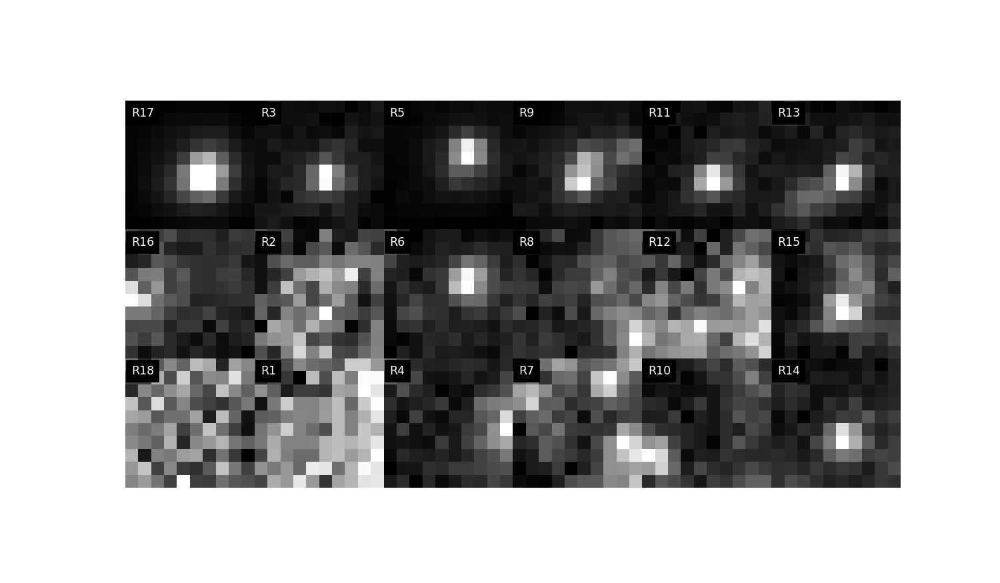

In [1043]:
pt = np.mean(Xsbad[:,:,0:3],1)[20]
dec_obj.check_fits(pt,szxy=[2,5,5],use_raw=False,proj_axis=0)

In [1028]:
pt

array([   2.39707854,  627.76901855, 1484.10556641])

In [935]:
np.unique(np.argmax(Xsbad[:,:,3],axis=-1),return_counts=True)

(array([0, 1, 2, 3, 4], dtype=int64),
 array([2787,  696,  590,  938,  401], dtype=int64))

<IPython.core.display.Javascript object>


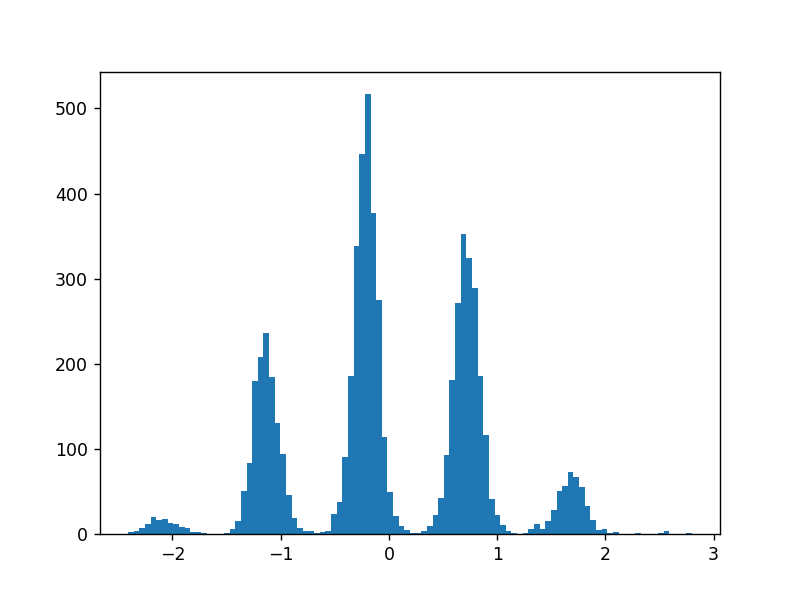

(array([  2.,   4.,   7.,  12.,  20.,  16.,  18.,  13.,  12.,   8.,   7.,
          2.,   2.,   1.,   0.,   0.,   0.,   1.,   6.,  15.,  50.,  84.,
        180., 208., 236., 184., 130.,  94.,  46.,  19.,   7.,   4.,   4.,
          1.,   2.,   3.,  23.,  38.,  90., 186., 338., 447., 517., 377.,
        275., 114.,  49.,  21.,   9.,   5.,   1.,   1.,   3.,   9.,  22.,
         42.,  93., 181., 271., 353., 324., 289., 186., 116.,  41.,  22.,
         11.,   3.,   1.,   0.,   1.,   6.,  12.,   6.,  15.,  28.,  50.,
         56.,  73.,  67.,  55.,  33.,  16.,   5.,   6.,   1.,   2.,   0.,
          0.,   0.,   1.,   0.,   0.,   0.,   1.,   3.,   0.,   0.,   0.,
          1.]),
 array([-2.40913916, -2.35706418, -2.30498919, -2.25291421, -2.20083923,
        -2.14876425, -2.09668927, -2.04461429, -1.99253931, -1.94046433,
        -1.88838935, -1.83631437, -1.78423939, -1.73216441, -1.68008943,
        -1.62801445, -1.57593946, -1.52386448, -1.4717895 , -1.41971452,
        -1.36763954, -1.31

In [976]:
ax=0
dist = (Xsbad[:,0,ax]-Xsbad[:,2,ax])
plt.figure()
plt.hist(dist,bins=100)

<IPython.core.display.Javascript object>


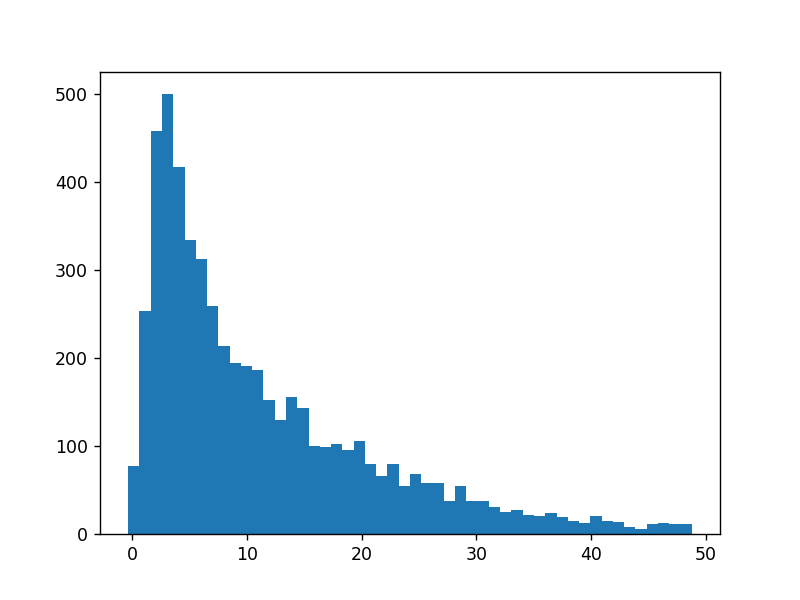

(array([ 77., 253., 458., 500., 417., 334., 312., 259., 214., 194., 191.,
        186., 152., 129., 156., 143., 100.,  99., 102.,  95., 106.,  80.,
         66.,  80.,  54.,  68.,  58.,  58.,  37.,  54.,  38.,  38.,  31.,
         25.,  27.,  22.,  20.,  24.,  19.,  15.,  13.,  20.,  15.,  14.,
          8.,   6.,  11.,  12.,  11.,  11.]),
 array([-0.32452426,  0.65708362,  1.63869151,  2.62029939,  3.60190728,
         4.58351517,  5.56512305,  6.54673094,  7.52833883,  8.50994671,
         9.4915546 , 10.47316249, 11.45477037, 12.43637826, 13.41798615,
        14.39959403, 15.38120192, 16.3628098 , 17.34441769, 18.32602558,
        19.30763346, 20.28924135, 21.27084924, 22.25245712, 23.23406501,
        24.2156729 , 25.19728078, 26.17888867, 27.16049655, 28.14210444,
        29.12371233, 30.10532021, 31.0869281 , 32.06853599, 33.05014387,
        34.03175176, 35.01335965, 35.99496753, 36.97657542, 37.95818331,
        38.93979119, 39.92139908, 40.90300696, 41.88461485, 42.86622274,
 

In [924]:
plt.figure()
plt.hist(np.mean(Xsbad[:,:,0],1),bins=50)


In [847]:
np.array(dec_obj.readout_names)[[2,4,8,10,12,14]]

array(['R3', 'R5', 'R9', 'R11', 'R13', 'R15'], dtype='<U3')

In [ ]:
R_to_col={1:'750',2:'647',3:'561',4:'750',6:'647',5:'561',7:'750',8:'647',9:'561',10:'750',12:'647',11:'561',14:'750',15:'647',13:'561',16:'647',17:'561',18:'750'}

In [ ]:
2,4,8,10,12

In [811]:
[np.sum(dec_obj.Xsf[:,-1]==iR) for iR in range(15)]

[40988,
 69206,
 92273,
 80542,
 94341,
 78571,
 56787,
 57156,
 88032,
 38731,
 96837,
 70961,
 91879,
 43044,
 64696]

In [794]:
len(dec_obj.res)


1064044

In [801]:
np.unique([len(r_) for r_ in rints],return_counts=True)

(array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        19]),
 array([329734, 158770, 110600,  79384,  53671,  30332,  16846,   8770,
          4403,   2182,   1009,    453,    202,     56,     21,      6,
             3,      1], dtype=int64))

In [ ]:
### ideas:
1) Record the points.


In [790]:
np.array(dec_obj.points_all_codes[3])[:,:,-1],dec_obj.codes_valid[3]+1

(array([[ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 1.,  3.,  8., 12.],
        [ 

In [780]:
list(map(len,dec_obj.points_all_codes))

[37,
 36,
 15,
 100,
 53,
 62,
 97,
 13,
 40,
 16,
 42,
 29,
 30,
 522,
 33,
 24,
 54,
 8,
 82,
 26,
 36,
 17,
 17,
 41,
 24,
 58,
 69,
 35,
 17,
 25,
 27,
 42,
 23,
 48,
 69,
 8,
 31,
 38,
 81,
 28,
 55,
 19,
 85,
 69,
 86,
 44,
 33,
 35,
 61,
 45,
 52,
 209,
 65,
 60,
 20,
 214,
 26,
 22,
 40,
 43,
 153,
 17,
 48,
 1160,
 26,
 19,
 36,
 6,
 17,
 23,
 74,
 95,
 18,
 40,
 11,
 36,
 15,
 11,
 151,
 22,
 39,
 16,
 154,
 180,
 49,
 16,
 75,
 56,
 67,
 62,
 30,
 16,
 40,
 45,
 36,
 46,
 18,
 11,
 40,
 25,
 28,
 32,
 64,
 56,
 21,
 53,
 190,
 21,
 35,
 21,
 22,
 51,
 20,
 113,
 26,
 62,
 46,
 182,
 23,
 40,
 66,
 10,
 26,
 36,
 5,
 26,
 33,
 41,
 26,
 20,
 112,
 35,
 29,
 27,
 55,
 35,
 87,
 59,
 25,
 96,
 33,
 5,
 20,
 32,
 77,
 82,
 18,
 25,
 22,
 27,
 156,
 17,
 52,
 77,
 14,
 73,
 33,
 13,
 8,
 21,
 128,
 65,
 52,
 51,
 8,
 136,
 27,
 39,
 80,
 78,
 30,
 13,
 99,
 11,
 90,
 36,
 80,
 19,
 30,
 27,
 16,
 28,
 26,
 34,
 50,
 69,
 40,
 36,
 57,
 36,
 18,
 30,
 70,
 133,
 39,
 25,
 119,
 23

In [1182]:
dec_obj.codes_valid[icode_],icode_

(array([ 0,  6,  9, 10]), 61)

<IPython.core.display.Javascript object>


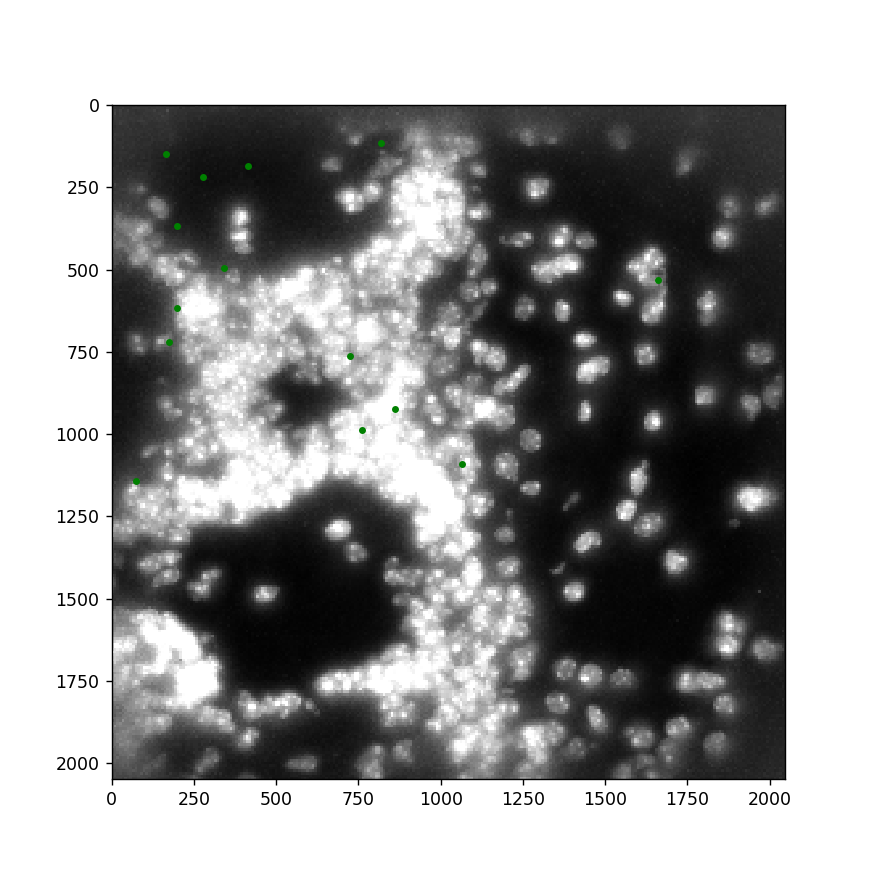

In [1194]:
#xall,yall = dec_obj.Xsf[np.linspace(0,len(dec_obj.Xsf)-1,200000).astype(np.int)].T[[1,2]]
plt.figure(figsize=(7,7))

#plt.plot(xall,yall,'.',alpha=0.125,color='red')
for icode_ in [icode]:
    pts_ = np.array(dec_obj.points_all_codes[icode_])#56,357
    xys = np.mean(pts_[:,:,1:3],1)
    obs = np.array([dec_obj.get_OB(xy) for xy in xys])
    x,y = np.array([np.mean(e[:,[1,2]],0) for e in pts_]).T[:,obs>-1]
    plt.plot(x,y,'g.')
plt.imshow(dec_obj.im_norm_dapi.T,vmax=4,cmap='gray')

In [571]:
dec_obj.error_drift

[array([0.33799564, 0.1899511 , 0.05376592]),
 array([0., 0., 0.]),
 array([ 0.14040182,  0.13164321, -0.162307  ]),
 array([ 0.13810484, -0.18340303, -0.21549186]),
 array([ 0.10853484, -0.29326401, -0.21275701]),
 array([ 0.11086573,  0.01674297, -0.21856787])]

In [502]:

scores = np.array(scores)
OB_codes = np.array(OB_codes)
nRNAs = np.array(nRNAs)
keep = scores>5
1.*np.sum(keep)/len(keep)
nRNAs[keep]
OBs_keep = OBs[keep]
OB_olfrs = [dec_obj.code_dic[tuple(np.sort(cd))].split('__')[0] for cd in OB_codes[keep]]

NameError: name 'scores' is not defined

In [722]:
reload(oma)
master_folder = r'\\dolly\Raw_data_4\Bogdan\11_30_2020__OR-MER_lib1,2,3,4,5____CD1mom3_toB6pups_3col_40xStorm3_OB18_OB'
dec_obj = oma.decoded_fov(master_folder,analysis_folder=r'F:\Bogdan')
dec_obj.get_files(htag=r'\H*R*')
dec_obj.psf_file = r'F:\Bogdan\PSF_Chromatic\psfs_pix256_sz3_STORM3-40X.npy'
dec_obj.chrom_file = r'F:/Bogdan/PSF_Chromatic/STORM3_dic_chr.pkl'

ifov = 403
dec_obj.get_flatfield(force=False,cols = ['561','647','750','405'],ref=1)
#get images
dec_obj.get_mapped_ims(ifov,cols = ['561','647','750','405'])
dec_obj.get_final_zxyhs(sort=True,overwrite=False)

<IPython.core.display.Javascript object>


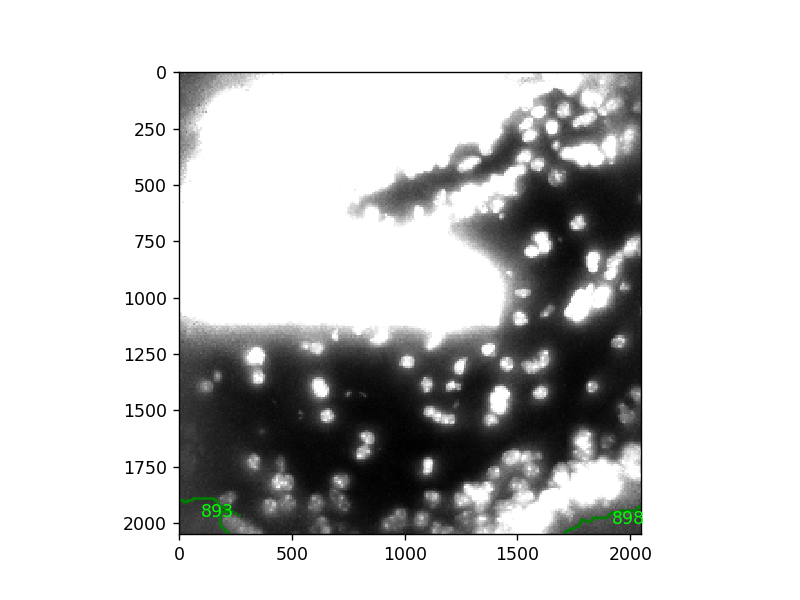

In [725]:
dec_obj.refine_OB_mask(th_dapi = 1.35,iref = 1,rescs=[2,8,8],radius=15,plt_val=True);

In [488]:
points_all_codes_ = dec_obj.points_all_codes[:]
points_all_codes_ = np.array(points_all_codes_)[np.argsort([len(pt) for pt in points_all_codes_])[::-1]]
pts = np.array(points_all_codes_[0])


<IPython.core.display.Javascript object>


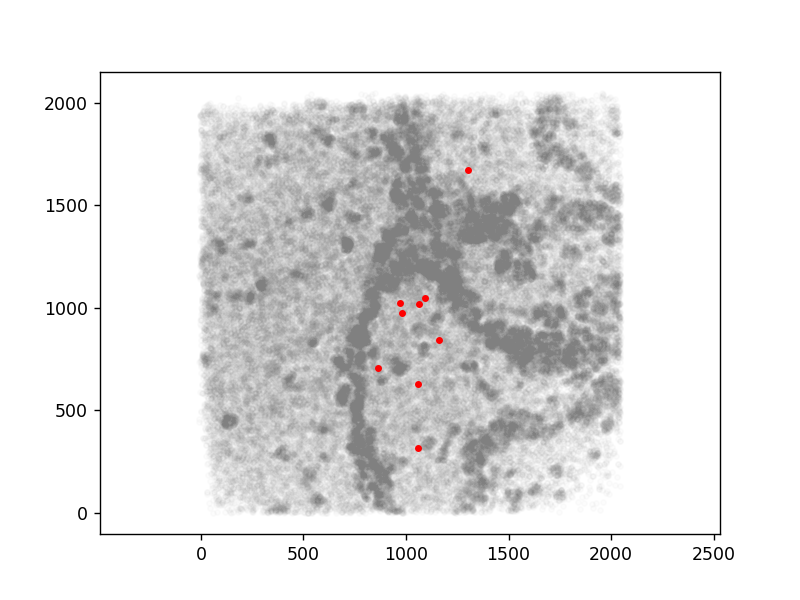

In [496]:
xall,yall = dec_obj.Xsf[np.linspace(0,len(dec_obj.Xsf)-1,100000).astype(np.int)].T[[1,2]]
pts_ = np.array(points_all_codes_[20])
xys = np.mean(pts_[:,:,1:3],1)
obs = np.array([dec_obj.get_OB(xy) for xy in xys])
x,y = np.array([np.mean(e[:,[1,2]],0) for e in pts_]).T[:,obs>0]
plt.figure()
plt.plot(xall,yall,'.',alpha=0.025,color='gray')
plt.plot(x,y,'.',color='red')
plt.axis('equal');

In [371]:
np.unique([(1,2),(2,3)])

array([1, 2, 3])

In [369]:
rints = np.array([r for r in res if len(r)==4])
rints = np.array([np.array(eval(e)) for e in np.unique([str(list(np.sort(r))) for r in rints])]) # make unique
len(rints)

24758

In [363]:
len(dec_obj.codes_valid)

499

In [350]:
iR=13
htag_nm = dec_obj.image_names[iR]
iim = dec_obj.ims_names.index(htag_nm)
im_ = np.max(dec_obj.ims[iim],axis=0)
col = htag_nm.split('_')[-1]
icol = dec_obj.cols.index(col)
im_med = dec_obj.ims_mean[icol]
z,x,y,h,h_,cor = dec_obj.zxyhsf[iR].T

In [352]:
htag_nm

'H5R14,15,13;T10,11,12_750'

<IPython.core.display.Javascript object>


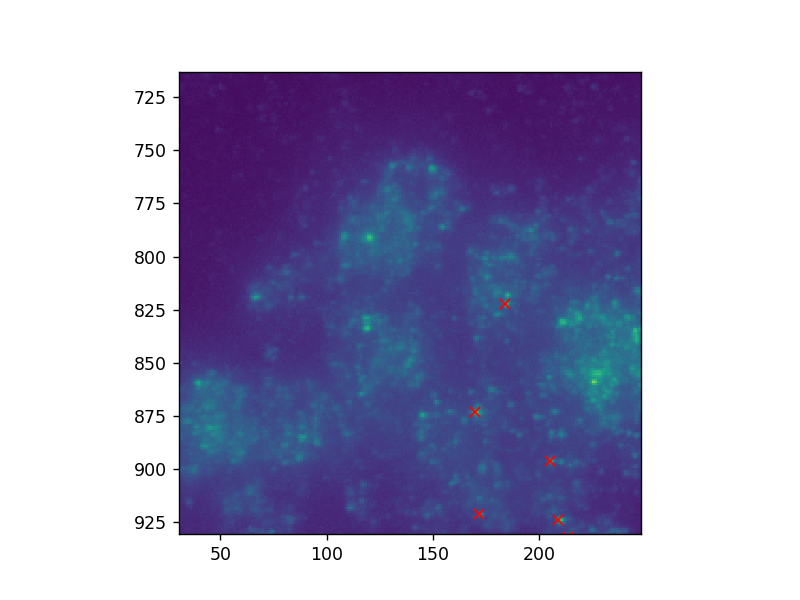

In [351]:
plt.figure()
plt.imshow(im_/im_med,vmax=5)
plt.plot(y[h>15.5]-dec_obj.Tzxys[iim][2],x[h>15.5]-dec_obj.Tzxys[iim][1],'rx')

<IPython.core.display.Javascript object>


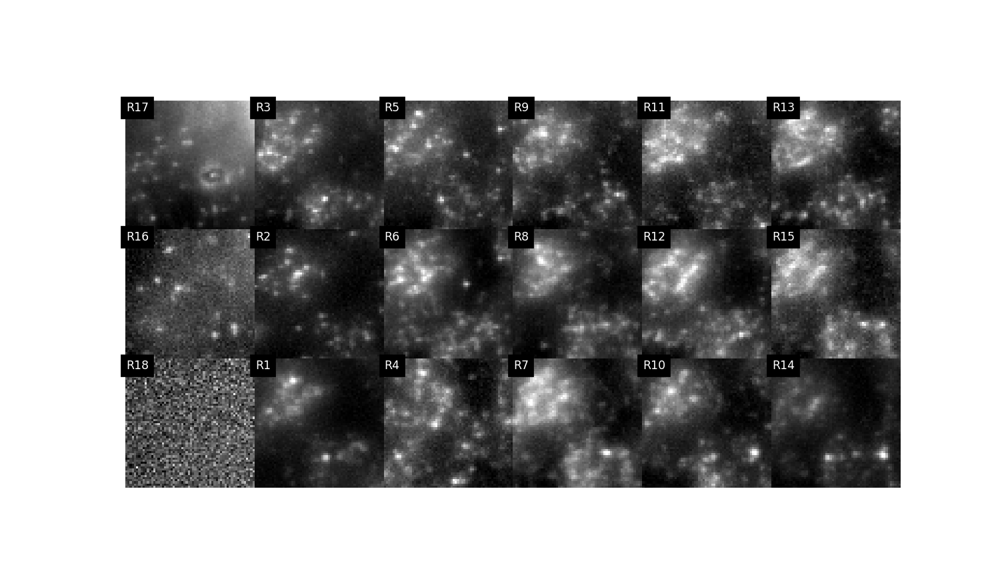

In [434]:
dec_obj.Txys = [[0,0]]*20
dec_obj.check_fits([20,850,150],szxy=[4,30,30],use_raw=False,proj_axis=0)

In [314]:
dec_obj.image_names

['H1R1,2,3;TEGR1_750',
 'H1R1,2,3;TEGR1_647',
 'H1R1,2,3;TEGR1_561',
 'H2R4,5,6;T1,2,3_750',
 'H2R4,5,6;T1,2,3_561',
 'H2R4,5,6;T1,2,3_647',
 'H3R7,8,9;T4,5,6_750',
 'H3R7,8,9;T4,5,6_647',
 'H3R7,8,9;T4,5,6_561',
 'H4R10,11,12;T7,8,9_750',
 'H4R10,11,12;T7,8,9_561',
 'H4R10,11,12;T7,8,9_647',
 'H5R14,15,13;T10,11,12_561',
 'H5R14,15,13;T10,11,12_750',
 'H5R14,15,13;T10,11,12_647',
 'H0EGR1,cfos_647',
 'H0EGR1,cfos_561',
 'H0EGR1,cfos_750']

In [420]:
#codes_txt[np.argsort(lens_)[::-1]]

In [305]:
rints_txt[12000]

'[ 1  7  8 15]'

In [298]:
len(points_all_codes_)

499

In [310]:
np.array(points_all_codes_[0]).shape

(1281, 4, 6)

In [299]:
dec_obj.codes_valid

array([[ 0,  6,  7, 10],
       [ 6,  7,  9, 11],
       [ 0,  6,  8,  9],
       ...,
       [ 2,  6,  9, 13],
       [ 2,  9, 11, 13],
       [ 1,  8,  9, 11]])

<IPython.core.display.Javascript object>


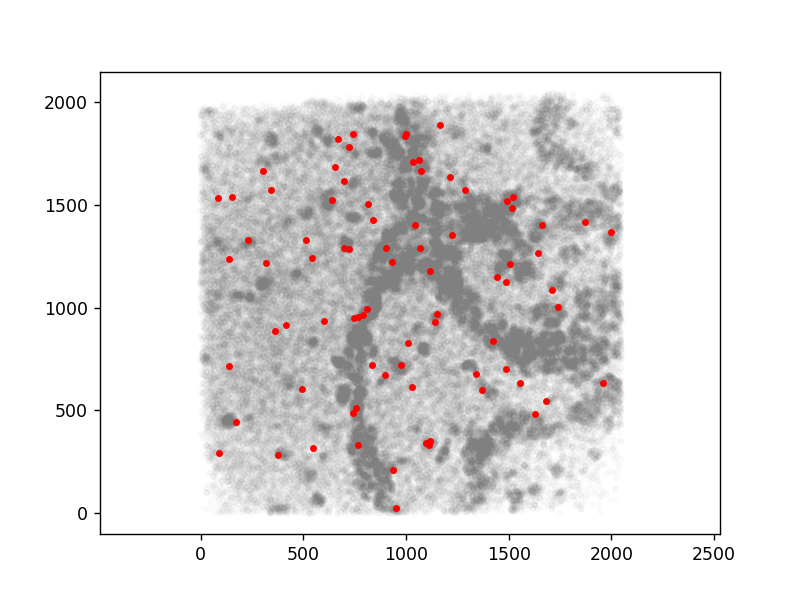

In [170]:
xall,yall = Xsf[np.linspace(0,len(Xsf)-1,100000).astype(np.int)].T[[1,2]]
x,y = np.array([np.mean(e[:,[1,2]],0) for e in points_all_codes_[4]]).T
plt.figure()
plt.plot(xall,yall,'.',alpha=0.025,color='gray')
plt.plot(x,y,'.',color='red')
plt.axis('equal');

<IPython.core.display.Javascript object>


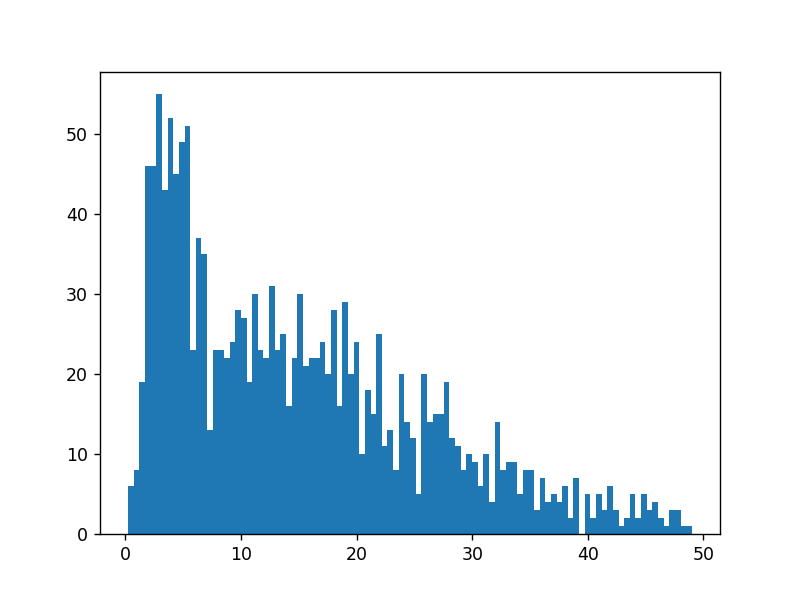

(array([ 6.,  8., 19., 46., 46., 55., 43., 52., 45., 49., 51., 23., 37.,
        35., 13., 23., 23., 22., 24., 28., 27., 19., 30., 23., 22., 31.,
        23., 25., 16., 22., 30., 21., 22., 22., 24., 20., 28., 16., 29.,
        20., 24., 10., 18., 15., 25., 11., 13.,  8., 20., 14., 12.,  5.,
        20., 14., 15., 15., 19., 12., 11.,  8., 10.,  9.,  6., 10.,  4.,
        14.,  8.,  9.,  9.,  5.,  8.,  8.,  3.,  7.,  4.,  5.,  4.,  6.,
         2.,  7.,  0.,  5.,  2.,  5.,  3.,  6.,  3.,  1.,  2.,  5.,  2.,
         5.,  3.,  4.,  2.,  1.,  3.,  3.,  1.,  1.]),
 array([ 0.24518663,  0.73267686,  1.220167  ,  1.7076573 ,  2.1951475 ,
         2.6826377 ,  3.1701279 ,  3.6576183 ,  4.145108  ,  4.632599  ,
         5.120089  ,  5.607579  ,  6.0950694 ,  6.5825596 ,  7.07005   ,
         7.55754   ,  8.045031  ,  8.53252   ,  9.020011  ,  9.507501  ,
         9.994991  , 10.482481  , 10.969972  , 11.457462  , 11.944952  ,
        12.432443  , 12.919932  , 13.407423  , 13.894913  , 14.382403

In [138]:
plt.figure()
plt.hist(np.array([np.mean(e[:,[0,1,2]],0) for e in points_all_codes_[0]])[:,0],bins=100)

In [290]:
#dec_obj.loadOBmasks(msk_filenames=None,infos_filename=None,mA=500,MA=100000)
dec_obj.get_code(fl=r'SI8_final.fasta')
codes = dec_obj.codes
len(codes)

1001

In [310]:
get_code(dec_obj,fl = r'SI8_final.fasta')

In [299]:
self=dec_obj
self.libs = eval(os.path.basename(self.data_folder).split('_lib')[-1].split('_')[0])
self.codes_valid = np.array([cd for cd in self.code_dic if int(self.code_dic[cd].split('_')[-1]) in self.libs])

In [306]:
[cd for cd in self.code_dic]

[(0, 6, 7, 10),
 (6, 7, 9, 11),
 (0, 6, 8, 9),
 (0, 2, 7, 11),
 (4, 8, 9, 13),
 (0, 3, 7, 10),
 (8, 9, 10, 12),
 (4, 6, 8, 9),
 (4, 5, 6, 10),
 (0, 1, 10, 13),
 (1, 5, 7, 12),
 (1, 7, 9, 12),
 (1, 6, 7, 12),
 (4, 5, 8, 12),
 (1, 2, 4, 7),
 (1, 3, 10, 13),
 (3, 4, 5, 9),
 (3, 6, 8, 9),
 (0, 4, 7, 9),
 (0, 3, 4, 7),
 (2, 9, 10, 13),
 (3, 6, 9, 10),
 (0, 3, 8, 13),
 (2, 4, 7, 9),
 (5, 6, 7, 10),
 (0, 5, 7, 8),
 (0, 5, 8, 12),
 (3, 8, 9, 11),
 (0, 5, 10, 13),
 (1, 3, 11, 13),
 (2, 3, 11, 13),
 (0, 1, 7, 11),
 (5, 9, 10, 13),
 (5, 8, 9, 12),
 (2, 5, 7, 11),
 (1, 2, 6, 9),
 (0, 9, 10, 12),
 (0, 1, 2, 4),
 (2, 5, 7, 10),
 (6, 9, 10, 11),
 (0, 2, 6, 7),
 (3, 4, 6, 8),
 (0, 7, 10, 12),
 (0, 2, 8, 10),
 (0, 7, 11, 12),
 (1, 7, 8, 11),
 (7, 8, 11, 13),
 (1, 4, 10, 13),
 (2, 5, 7, 8),
 (3, 8, 9, 12),
 (3, 4, 11, 12),
 (1, 2, 8, 10),
 (0, 2, 5, 12),
 (3, 5, 11, 12),
 (0, 11, 12, 13),
 (2, 4, 5, 10),
 (0, 1, 11, 12),
 (1, 5, 8, 9),
 (0, 5, 8, 11),
 (2, 3, 7, 10),
 (1, 8, 10, 12),
 (0, 6, 9, 10),
 (0

In [288]:
ndec_OB = {}
Adec = {}
OB_fov = {}
for ifov in tqdm(np.arange(len(dec_obj.fovs))):
    try:
        dec_obj.get_mapped_ims(ifov)#28
        dec_obj.get_final_zxyhs(tag='',sort=True)
        dec_obj.apply_colorcor(chr_fl = r'\\dolly\Analysis\Bogdan\7_20_2020__OB-MER_libB32-p2_SDS-Analysis\chr_aberration_7-24-2020.pkl')
        dec_obj.im_OBmask()
        self = dec_obj
        if np.max(dec_obj.im_mask)>0:
            dec_obj.refine_OB_mask(th_dapi = 1.,dilate_dapi=25,dilateOB=30,plt_val = True);

            Xsf,Rs=[],[]
            for iR,zxy_ in enumerate(dec_obj.zxyhsc):
                Xsf.extend(zxy_)
                Rs.extend([iR+1]*len(zxy_))
            Xsf = np.array(Xsf)
            Rs=np.array(Rs)
            #cutoff brightness
            keep = Xsf[:,3]>5.
            Xsf = Xsf[keep]
            Rs = Rs[keep]

            # Find all intersections
            Xs = Xsf[:,:3]
            Ts = cKDTree(Xs)
            res = Ts.query_ball_tree(Ts,1.25)

            rints = np.array([r for r in res if len(r)==4])
            rints = np.array([np.array(eval(e)) for e in np.unique([str(list(np.sort(r))) for r in rints])]) # make unique
            rints_txt = np.array([str(Rs[r]) for r in rints])
            codes_txt = np.array([str(cd) for cd in codes])
            keeps = np.array([rints_txt==cd for cd in codes_txt])
            points_all_codes = [[Xsf[r] for r in rints[keep]] for keep in keeps]




            #OBs_per_code = [[get_OB(self,np.mean(pt[:,1:3],0)) for pt in pts]for pts in points_all_codes]
            OBes = np.unique(self.im_mask_OB)
            dec_OB = {OB_:[[pt for ipt,pt in enumerate(pts) if self.get_OB(np.mean(pt[:,1:3],0))==OB_] 
                           for icd,pts in enumerate(points_all_codes)]
                      for OB_ in OBes}
            for OB_ in OBes:
                ndec_ = np.array([len(pts) for pts in dec_OB[OB_]])
                A_ = np.sum(self.im_mask_OB==OB_)
                ndec_OB[OB_] = ndec_OB.get(OB_,np.zeros(len(ndec_)))+ndec_
                Adec[OB_] = Adec.get(OB_,0)+A_
                OB_fov[OB_]=OB_fov.get(OB_,[])+[ifov]
            #ndec_OB = {OB_:np.array([len(pts) for pts in dec_OB[OB_]]) for OB_ in OBes}
            #ndec_OB[-1] = np.sum([ndec_OB[OB_] for OB_ in ndec_OB if OB_>0],0)
            #Adec = {OB_:np.sum(self.im_mask_OB==OB_)for OB_ in OBes}
            #Adec[-1]=np.sum([Adec[OB_]for OB_ in Adec if OB_>0])
    except:
        print("Failed",ifov)


['561', '647', '750']

In [286]:
dec_obj.DEs

[array([-0.00651897, -0.10238848, -0.09838637]),
 array([0., 0., 0.]),
 array([ 0.06446892, -0.03172104, -0.09017163]),
 array([-0.10912443, -0.19368073, -0.09351437]),
 array([-0.08127318,  0.01130151,  0.08025145]),
 array([ 0.06071351,  0.05375915, -0.04116394])]

In [272]:
col='750'


In [264]:
def nm_to_R(nm_sm,cols = ['561','647']):
    try:
        col = nm_sm.split('_')[-1]
        coli = cols.index(col)
        return 'R'+nm_sm[3:].split('_')[0].split(';')[0].split('T')[0].split(',')[coli]+'_'+col
    except:
        return nm_sm
    
    



In [265]:
nm_to_R(dec_obj.ims_names[0])

'R17'

In [238]:
dec_obj.htags
nm_to_R(dec_obj.htags[1]+'_647')

'R2'

In [ ]:
chr_file = 

In [233]:
dec_obj.cols

['561', '647', '750', '405']

In [129]:
dec_obj.get_drift_3d(ref=1,sz_big = 21,sz_small=5,size=128,delta_fit=11,th_h=1.5,th_dist=2)

In [204]:
#dec_obj.DEs

In [39]:
#dec_obj.Txys,np.round(dec_obj.Tzxys).astype(int)
#reload(ft)

<IPython.core.display.Javascript object>


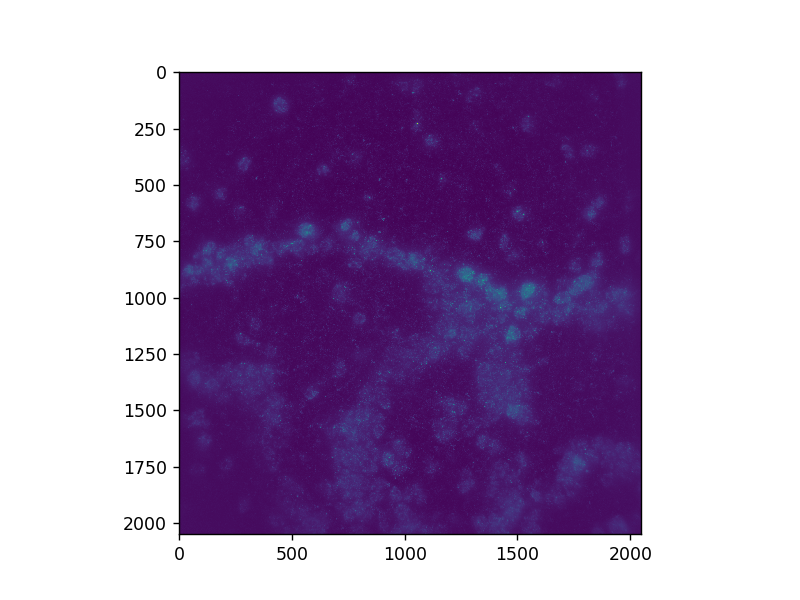

In [162]:
plt.figure()
plt.imshow(np.max(dec_obj.im_norm,axis=0))

In [193]:
dec_obj.get_drift_2d(nsq=4, snorm=40)

In [199]:
dec_obj.Tzxys[:,1:]-dec_obj.Tzxys[0,1:]

array([[ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.42751812,  2.01174623],
       [ 0.42751812,  2.01174623],
       [ 0.42751812,  2.01174623],
       [ 0.26437995,  1.92774088],
       [ 0.26437995,  1.92774088],
       [ 0.26437995,  1.92774088],
       [-1.39466624,  2.26851844],
       [-1.39466624,  2.26851844],
       [-1.39466624,  2.26851844],
       [-4.52831336,  1.85849204],
       [-4.52831336,  1.85849204],
       [-4.52831336,  1.85849204],
       [-9.01782617,  3.24179181],
       [-9.01782617,  3.24179181],
       [-9.01782617,  3.24179181]])

In [200]:
dec_obj.Txys

array([[ 0,  0],
       [ 0,  0],
       [ 0,  0],
       [ 0,  0],
       [ 0,  0],
       [ 0,  0],
       [ 0,  0],
       [ 0,  0],
       [ 0,  0],
       [ 0,  0],
       [ 0,  0],
       [ 0,  0],
       [-4,  1],
       [-4,  1],
       [-4,  1],
       [-8,  3],
       [-8,  3],
       [-8,  3]])

<IPython.core.display.Javascript object>


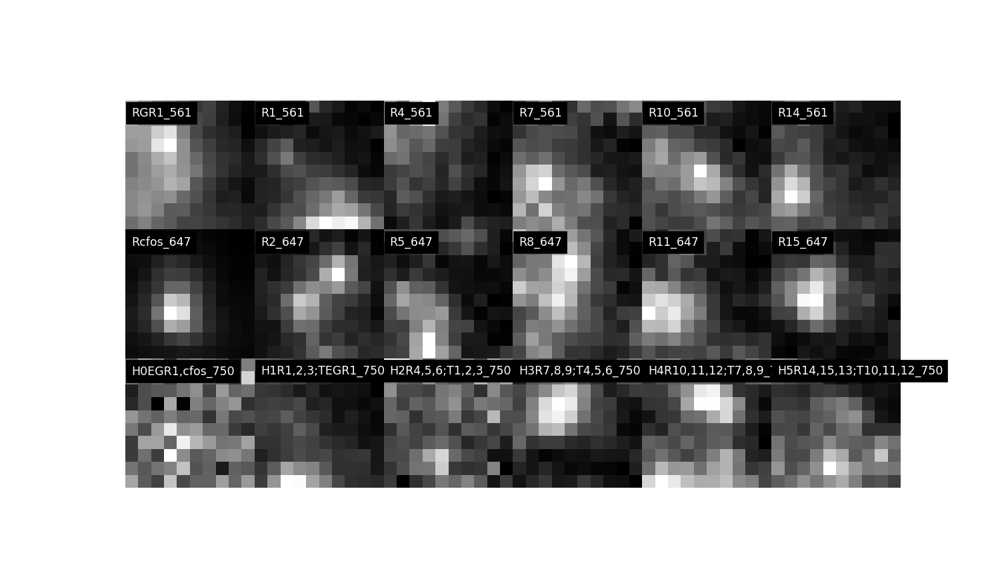

In [87]:
self=dec_obj
len(self.zxyhs)

18

In [105]:
dec_obj.Txys = np.array([[-0.3952838 , -0.42751812, -2.01174623],
       [-0.3952838 , -0.42751812, -2.01174623],
       [-0.3952838 , -0.42751812, -2.01174623],
       [-0.        , -0.        , -0.        ],
       [-0.        , -0.        , -0.        ],
       [-0.        , -0.        , -0.        ],
       [ 0.23177721, -0.16313817, -0.08400535],
       [ 0.23177721, -0.16313817, -0.08400535],
       [ 0.23177721, -0.16313817, -0.08400535],
       [ 0.48569271, -1.82218436,  0.25677221],
       [ 0.48569271, -1.82218436,  0.25677221],
       [ 0.48569271, -1.82218436,  0.25677221],
       [ 0.57557303, -4.95583147, -0.15325418],
       [ 0.57557303, -4.95583147, -0.15325418],
       [ 0.57557303, -4.95583147, -0.15325418],
       [ 0.90555167, -9.44534429,  1.23004558],
       [ 0.90555167, -9.44534429,  1.23004558],
       [ 0.90555167, -9.44534429,  1.23004558]])[:,1:]

In [126]:
dec_obj.get_fine_drift_postfit(icol=0,npts =50,dist=5)

In [128]:
dec_obj.error_drift

array([[ 0.        ,  0.        ,  0.        ],
       [ 0.03841972, -0.9584961 ,  0.76498413],
       [ 0.542191  , -1.3666382 ,  0.7720337 ],
       [ 0.08647251, -1.1059265 ,  0.63153076],
       [ 0.57141495, -1.4058304 ,  0.68655396],
       [-0.2680893 , -1.3756943 ,  0.75756836]], dtype=float32)

In [124]:
np.array(dec_obj.Tzxys)-dec_obj.Tzxys[0]

array([[ 0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ],
       [-0.2567168 ,  0.7250595 ,  1.404274  ],
       [-0.2567168 ,  0.7250595 ,  1.404274  ],
       [-0.2567168 ,  0.7250595 ,  1.404274  ],
       [-0.09965158,  0.2910843 ,  1.4462662 ],
       [-0.09965158,  0.2910843 ,  1.4462662 ],
       [-0.09965158,  0.2910843 ,  1.4462662 ],
       [ 0.05839461, -0.99842834,  1.5906448 ],
       [ 0.05839461, -0.99842834,  1.5906448 ],
       [ 0.05839461, -0.99842834,  1.5906448 ],
       [ 0.04428756, -4.162857  ,  1.3642807 ],
       [ 0.04428756, -4.162857  ,  1.3642807 ],
       [ 0.04428756, -4.162857  ,  1.3642807 ],
       [ 0.40893346, -8.677185  ,  2.7950668 ],
       [ 0.40893346, -8.677185  ,  2.7950668 ],
       [ 0.40893346, -8.677185  ,  2.7950668 ]], dtype=float32)

In [ ]:

dec_obj.check_fits(pt,szxy=[4,5,5],normalize=False,proj_axis=0,plt_val=True,use_raw=False)

In [110]:
np.array(dec_obj.Tzxys)-dec_obj.Tzxys[0]

array([[ 0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ],
       [ 0.38318163,  0.48012543,  2.0608978 ],
       [ 0.38318163,  0.48012543,  2.0608978 ],
       [ 0.38318163,  0.48012543,  2.0608978 ],
       [ 0.58375597,  0.3642273 ,  1.9673615 ],
       [ 0.58375597,  0.3642273 ,  1.9673615 ],
       [ 0.58375597,  0.3642273 ,  1.9673615 ],
       [ 0.78350353, -1.5190506 ,  2.3041382 ],
       [ 0.78350353, -1.5190506 ,  2.3041382 ],
       [ 0.78350353, -1.5190506 ,  2.3041382 ],
       [ 0.8632617 , -4.549469  ,  1.8896179 ],
       [ 0.8632617 , -4.549469  ,  1.8896179 ],
       [ 0.8632617 , -4.549469  ,  1.8896179 ],
       [ 1.4782064 , -8.972309  ,  3.4257965 ],
       [ 1.4782064 , -8.972309  ,  3.4257965 ],
       [ 1.4782064 , -8.972309  ,  3.4257965 ]], dtype=float32)

In [102]:
Txys_old = np.array(dec_obj.Txys)

In [85]:
dec_obj.Tzxys

array([[-0.3952838 , -0.42751812, -2.01174623],
       [-0.3952838 , -0.42751812, -2.01174623],
       [-0.3952838 , -0.42751812, -2.01174623],
       [-0.        , -0.        , -0.        ],
       [-0.        , -0.        , -0.        ],
       [-0.        , -0.        , -0.        ],
       [ 0.23177721, -0.16313817, -0.08400535],
       [ 0.23177721, -0.16313817, -0.08400535],
       [ 0.23177721, -0.16313817, -0.08400535],
       [ 0.48569271, -1.82218436,  0.25677221],
       [ 0.48569271, -1.82218436,  0.25677221],
       [ 0.48569271, -1.82218436,  0.25677221],
       [ 0.57557303, -4.95583147, -0.15325418],
       [ 0.57557303, -4.95583147, -0.15325418],
       [ 0.57557303, -4.95583147, -0.15325418],
       [ 0.90555167, -9.44534429,  1.23004558],
       [ 0.90555167, -9.44534429,  1.23004558],
       [ 0.90555167, -9.44534429,  1.23004558]])

In [ ]:
dec_obj

In [79]:
dec_obj

In [69]:
self.zxyh,self.zxyh_all = np.load(fit_file)

In [65]:
%matplotlib notebook

<IPython.core.display.Javascript object>


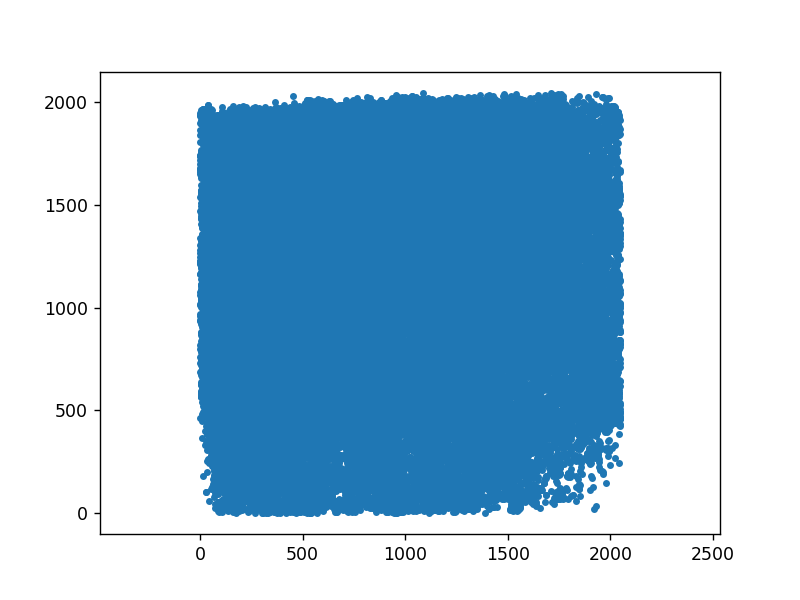

(-102.51188393980266,
 2149.182125146687,
 -102.0313876196742,
 2148.4754529818892)

In [68]:
plt.figure()
zxyh_keep = self.zxyh[(self.zxyh[:,-1]>0.5)&(self.zxyh[:,0]>0)]
plt.plot(zxyh_keep[:,1],zxyh_keep[:,2],'.',alpha=1)
plt.axis('equal')

In [40]:
dec_obj.psf_file = r'F:\Bogdan\PSF_Chromatic\psfs_pix256_sz3_STORM3-40X.npy'
dec_obj.fit(3,th_fit=4,th_cor=0.35,maxfev=10,better_fit=True,plt_val=False)

C:\Users\bogdan\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:447: RuntimeWarning: Number of calls to function has reached maxfev = 10.
  warnings.warn(errors[info][0], RuntimeWarning)


array([[8.1108123e-02, 5.2001766e+01, 1.1078263e+03, 4.5235720e+00,
        8.5868311e-01, 5.0169247e-01],
       [1.3532500e+00, 6.5547104e+01, 4.0510129e+02, 4.3072591e+00,
        1.0144987e+00, 3.9152911e-01],
       [1.3345696e+00, 6.6512421e+01, 4.7211215e+02, 4.1800561e+00,
        1.0358484e+00, 3.9681044e-01],
       ...,
       [4.8138741e+01, 2.0427905e+03, 1.1015111e+03, 6.6625643e+00,
        1.5542486e+00, 5.8357197e-01],
       [4.8174648e+01, 2.0434274e+03, 7.6816083e+02, 8.1478977e+00,
        1.6525424e+00, 4.2638233e-01],
       [4.7872219e+01, 2.0450438e+03, 1.5241604e+03, 6.1974754e+00,
        1.6325489e+00, 3.5201731e-01]], dtype=float32)

In [92]:
centers.shape
np.swapaxes(centers[:,:,:],0,-1).shape

(1048, 123, 4)

In [151]:
np.sum(dec_obj.zxyh_all[:,-1]>0.35)

93814

In [ ]:
100it/sec

In [9]:
import Fitting_v4 as ft
reload(ft)
pfits=[]
for centers_ in tqdm(dec_obj.centers[::100]):
    h_ = centers_[:,-1]
    X_ = centers_[:,:3].T
    fobj = ft.GaussianFit(h_,X_,delta_center=2.5)
    fobj.fit(maxfev=10)
    pfits.append(fobj.p)

C:\Users\bogdan\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:447: RuntimeWarning: Number of calls to function has reached maxfev = 10.
  warnings.warn(errors[info][0], RuntimeWarning)


In [11]:
#pfits_old = np.array(pfits)
pfits_new = np.array(pfits)

In [24]:
pfits_new__ = dec_obj.zxyh[::200]

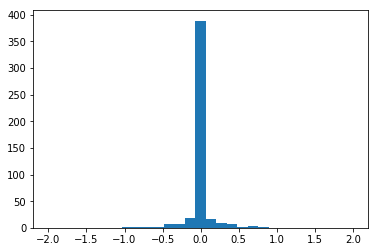

In [30]:
plt.figure()
plt.hist(pfits_old[:,2]-pfits_new[:,2],bins=np.linspace(-2,2,30))
plt.show()

In [12]:
#pfits_old = np.array(pfits)

np.mean(np.abs(pfits_old[:,1:4]-pfits_new[:,1:4]),0)

array([0.1471439 , 0.05874541, 0.05290651], dtype=float32)

In [127]:
pfits_new = np.array(pfits)

KeyboardInterrupt: 

In [ ]:
master_folder = r'\\dolly\Analysis\Bogdan\7_19_2020__OB-MER_oldlib7,8,9,10-SDS'
for ifov in tqdm(np.arange(131)):
    dec_obj = decoded_fov(master_folder)
    dec_obj.get_flatfield()
    dec_obj.get_mapped_ims(ifov)#fov
    dec_obj.fitall(th_fit=4)
    dec_obj.get_drift(nsq = 4)
    dec_obj.get_fine_drift_postfit(icol=0,npts =200,dist=3.5)
    dec_obj.get_final_zxyhs(tag='',sort=True)#,overwrite=False)
    #dec_obj.apply_colorcor(chr_fl = r'\\dolly\Analysis\Bogdan\7_20_2020__OB-MER_libB32-p2_SDS-Analysis\chr_aberration_7-24-2020.pkl')

In [ ]:
get_drift_3d(self,ref=1,sz_big = 21,sz_small=5,size=128,delta_fit=11,th_h=1.5,th_dist=2)